Example notebook training a flow on samples from a known distribution, then using MCMC to generate new samples

In [1]:
import os
import sys
import argparse
import logging
import torch
from torch.distributions import MultivariateNormal, Uniform, TransformedDistribution, SigmoidTransform
from getdist import plots, MCSamples
import getdist
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import collections as mc
from scipy.stats import multivariate_normal

In [2]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines) {
    return false;
}

<IPython.core.display.Javascript object>

In [3]:
path = os.path.realpath(os.path.join(os.getcwd(), '../..'))
sys.path.insert(0, path)

In [4]:
from nnest import NestedSampler, MCMCSampler
from nnest.trainer import Trainer
from nnest.likelihoods import *
from nnest.priors import *
from nnest.distributions import GeneralisedNormal

In [5]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [6]:
def plot_flow(samples, model):
    x_synth = model.netG.sample(samples.size).detach().cpu().numpy()
    z = model.get_latent_samples(samples)
    grid = []
    for x in np.linspace(np.min(samples[:, 0]) - 1, np.max(samples[:, 0]) + 1, 10):
        for y in np.linspace(np.min(samples[:, 1]) - 1, np.max(samples[:, 1]) + 1, 5000):
            grid.append([x, y])
    for y in np.linspace(np.min(samples[:, 1]) - 1, np.max(samples[:, 1]) + 1, 10):
        for x in np.linspace(np.min(samples[:, 0]) - 1, np.max(samples[:, 0]) + 1, 5000):
            grid.append([x, y])
    grid = np.array(grid)
    z_grid = model.get_latent_samples(grid)
    fig, ax = plt.subplots(1, 3, figsize=(12, 5))
    ax[0].scatter(grid[:, 0], grid[:, 1], c=grid[:, 0], marker='.', s=1, linewidths=0)
    ax[0].scatter(samples[:, 0], samples[:, 1], s=4)
    ax[0].set_title('Real data')
    ax[1].scatter(z_grid[:, 0], z_grid[:, 1], c=grid[:, 0], marker='.', s=1, linewidths=0)
    ax[1].scatter(z[:, 0], z[:, 1], s=4)
    ax[1].set_title('Latent data')
    ax[2].scatter(x_synth[:, 0], x_synth[:, 1], s=2)
    ax[2].set_title('Synthetic data')
    plt.tight_layout()
    plt.show()
    # Plot grid warp
    plt.figure(figsize=(6,6))
    ng = 30
    xx, yy = np.linspace(-4,4, ng), np.linspace(-4,4, ng)
    xv, yv = np.meshgrid(xx, yy)
    xy = np.stack([xv, yv], axis=-1)
    in_circle = np.sqrt((xy**2).sum(axis=2)) <= 3
    xy = xy.reshape((ng*ng, 2))
    xy = torch.from_numpy(xy.astype(np.float32))
    xs = model.get_samples(xy)
    xs = xs.reshape((ng, ng, 2))
    p1 = np.reshape(xs[1:,:,:], (ng**2-ng,2))
    p2 = np.reshape(xs[:-1,:,:], (ng**2-ng,2))
    inc = np.reshape(in_circle[1:,:] | in_circle[:-1,:], (ng**2-ng,))
    p1, p2 = p1[inc], p2[inc]
    lcy = mc.LineCollection(zip(p1, p2), linewidths=1, alpha=0.5, color='k')
    p1 = np.reshape(xs[:,1:,:], (ng**2-ng,2))
    p2 = np.reshape(xs[:,:-1,:], (ng**2-ng,2))
    inc = np.reshape(in_circle[:,1:] | in_circle[:,:-1], (ng**2-ng,))
    p1, p2 = p1[inc], p2[inc]
    lcx = mc.LineCollection(zip(p1, p2), linewidths=1, alpha=0.5, color='k')
    plt.gca().add_collection(lcy)
    plt.gca().add_collection(lcx)
    plt.xlim([np.min(samples[:,0])-0.05,np.max(samples[:,0])+0.05])
    plt.ylim([np.min(samples[:,1])-0.05,np.max(samples[:,1])+0.05])
    plt.scatter(samples[:,0], samples[:,1], c='r', s=5, alpha=0.5)
    plt.show()

In [7]:
def test_mcmc(like, prior, model, num_chains=1, init_chain=True, nested_samples=True, mcmc_steps=1000, nested_fraction=0.01):
    np.random.seed(0)
    if nested_samples:
        init_samples, loglstar = like.uniform_sample(prior, 1000, nested_fraction)
    else:
        init_samples = like.sample(prior, 1000)
        loglstar = None
    model.train(init_samples, jitter=0.001, max_iters=2000)
    plot_flow(init_samples, model)
    sampler = MCMCSampler(like.x_dim, like, prior=prior, trainer=model, log_level=logging.INFO)
    if init_chain:
        results = sampler._mcmc_sample(mcmc_steps, init_samples=init_samples[0:num_chains, :], 
                                       loglstar=loglstar, num_chains=num_chains)
    else:
        results = sampler._mcmc_sample(mcmc_steps, loglstar=loglstar, num_chains=num_chains)
    samples, latent_samples, derived_samples, loglikes, scale, ncall = results
    fig, ax = plt.subplots(1, 2, figsize=(12,6))
    flat_samples = samples.reshape((-1, like.x_dim))
    flat_latent_samples = latent_samples.reshape((-1, like.x_dim))
    ax[0].scatter(flat_samples[:,0], flat_samples[:,1], c='r', s=5, alpha=0.5)
    ax[1].scatter(flat_latent_samples[:,0], flat_latent_samples[:,1], c='r', s=5, alpha=0.5)
    plt.show()
    fig, ax = plt.subplots(like.x_dim, 2, figsize=(10, like.x_dim))
    for i in range(like.x_dim):
        ax[i, 0].plot(samples[0,0:1000,i])
        ax[i, 1].plot(latent_samples[0,0:1000,i])
    plt.show()
    mc = MCSamples(samples=[samples[i, :, :].squeeze() for i in range(samples.shape[0])], 
                   loglikes=[-loglikes[i, :].squeeze() for i in range(loglikes.shape[0])])
    try:
        print(mc.getEffectiveSamples())
    except:
        pass
    try:
        print(mc.getConvergeTests())
    except: 
        pass
    print(ncall, scale)

In [8]:
num_chains = 5

In [9]:
like = Gaussian(2, 0.9)
prior = UniformPrior(2, -5, 5)

[nnest.trainer] [INFO] SingleSpeedCholeksy(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): Choleksy()
    )
  )
)
[nnest.trainer] [INFO] Number of network params: [5]
[nnest.trainer] [INFO] Device [cpu]
[nnest.trainer] [INFO] Number of training samples [1000]
[nnest.trainer] [INFO] Training jitter [0.0010]
[nnest.trainer] [INFO] Epoch [1] train loss [0.0286] validation loss [0.0270]
[nnest.trainer] [INFO] Epoch [100] train loss [0.0233] validation loss [0.0222]
[nnest.trainer] [INFO] Epoch [200] train loss [0.0211] validation loss [0.0202]
[nnest.trainer] [INFO] Epoch [300] train loss [0.0203] validation loss [0.0195]
[nnest.trainer] [INFO] Epoch [400] train loss [0.0201] validation loss [0.0193]
[nnest.trainer] [INFO] Epoch [500] train loss [0.0201] validation loss [0.0193]
[nnest.trainer] [INFO] Epoch [587] ran out of patience
[nnest.trainer] [INFO] Best epoch [537] validation loss [0.0193]


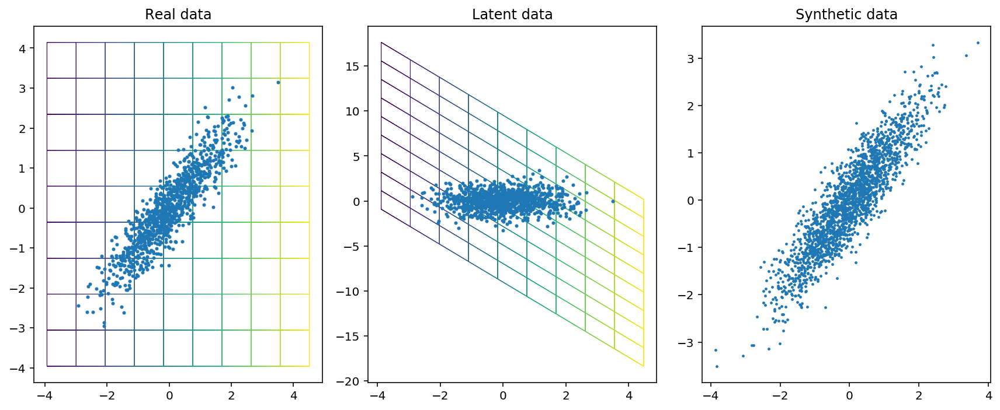

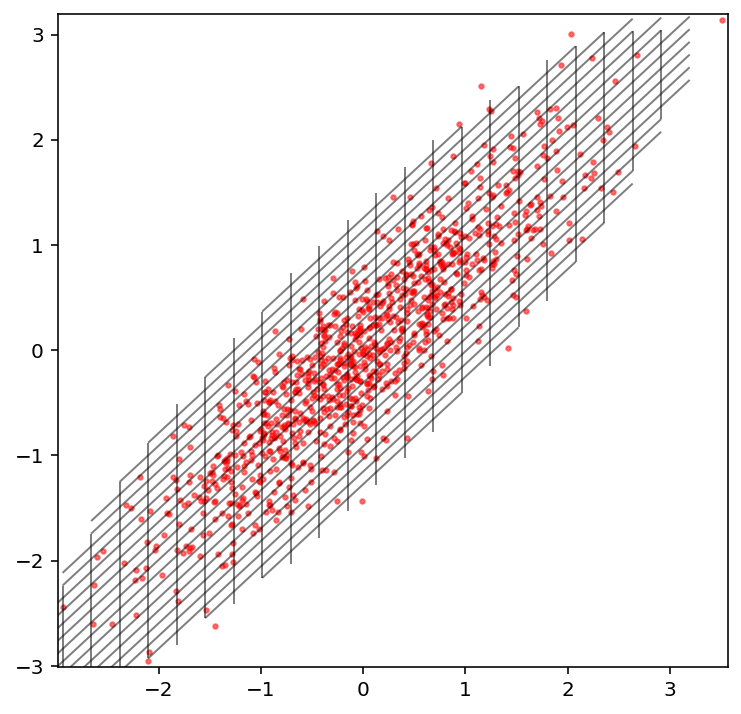

Creating directory for new run logs/test/run7
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


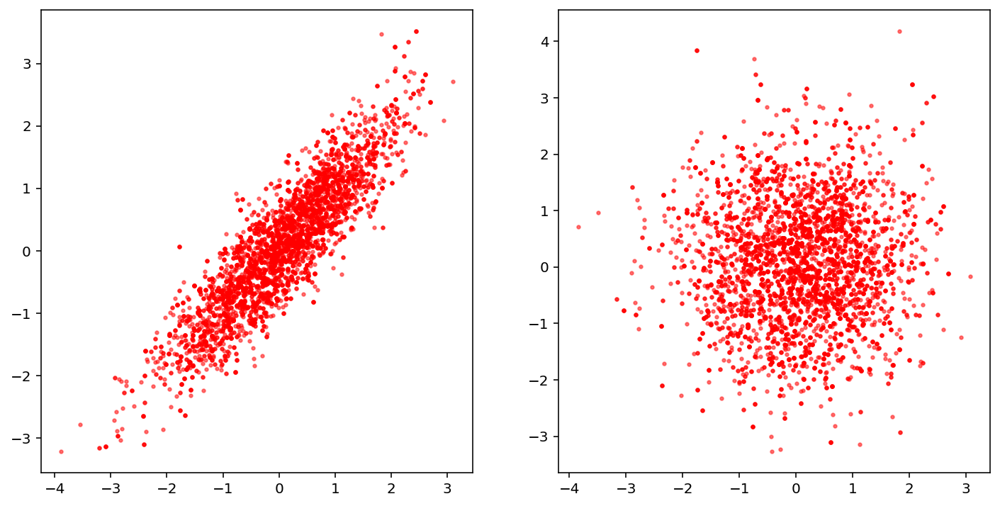

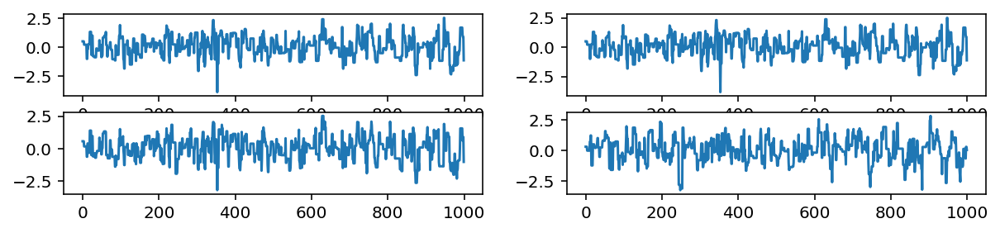

Removed no burn in
784.0107794766999
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.34E+00            6.34             789
param2           6.97E+00            6.97             717


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0531  p_{1}
param2        0.0419  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00171
  2      0.00937

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0916   0.1316   0.1374 upper
param1       0.0863   0.1001   0.1940 lower
param2       0.0794   0.1834   0.1414 upper
param2       0.0087   0.0575   0.1134 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

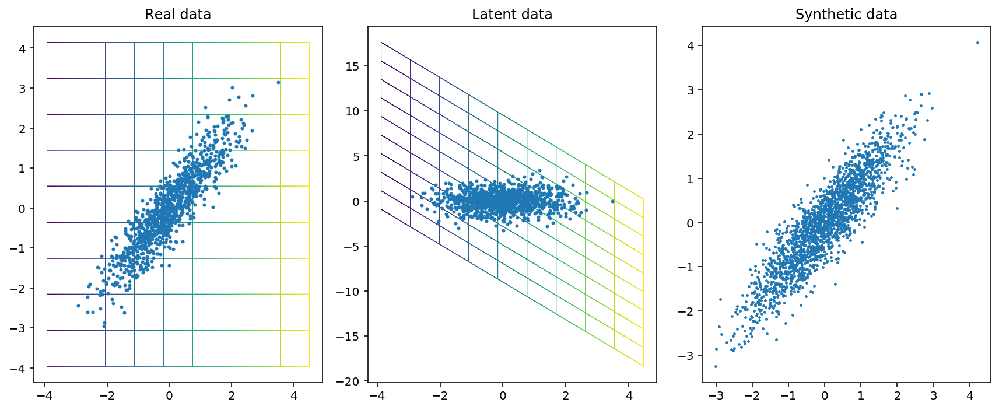

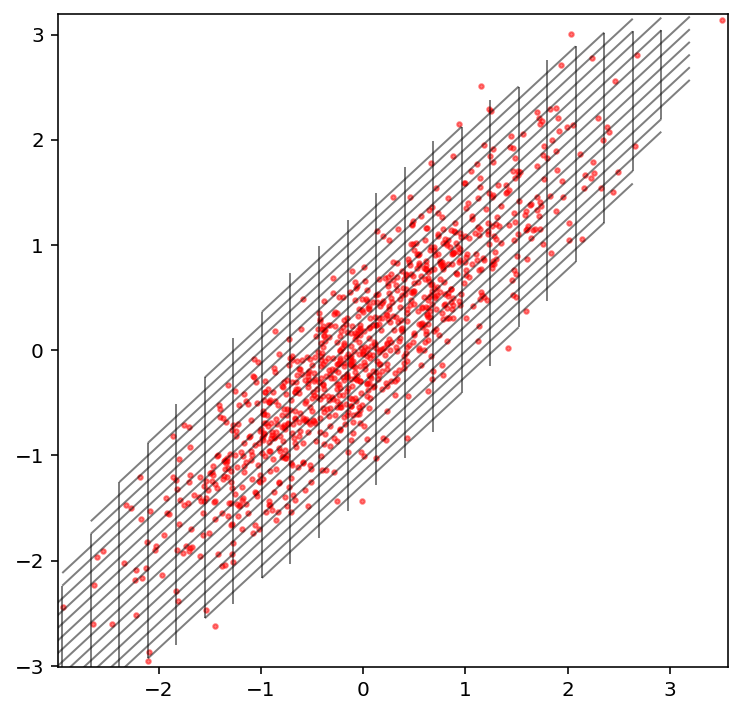

Creating directory for new run logs/test/run8
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


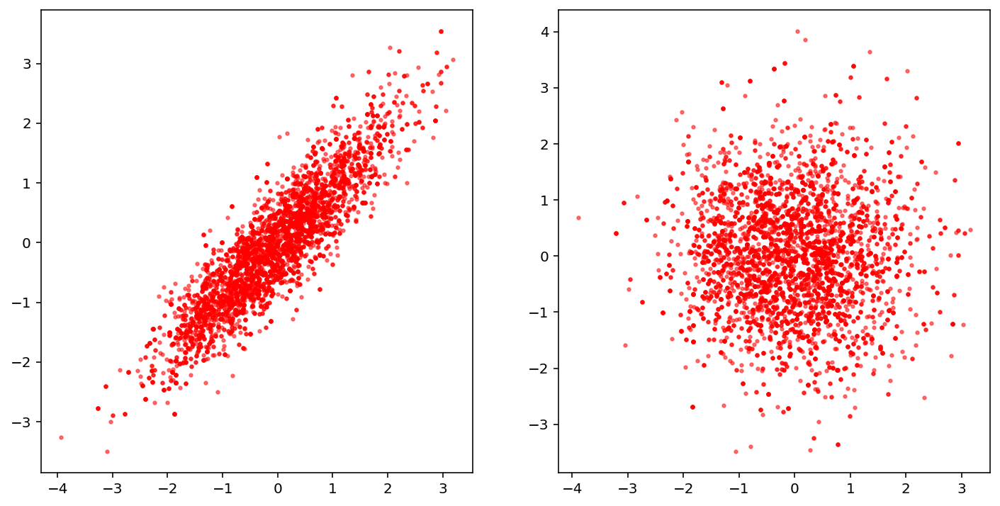

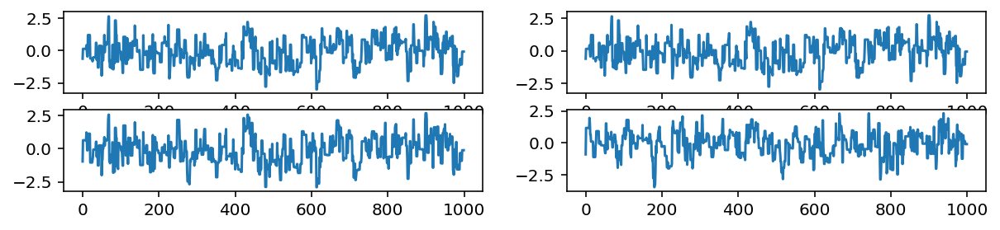

Removed no burn in
703.6432057833149
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.07E+00            7.07             708
param2           7.07E+00            7.07             707


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0480  p_{1}
param2        0.0765  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00131
  2      0.01023

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.1046   0.1476   0.2272 upper
param1       0.0231   0.0945   0.1130 lower
param2       0.1818   0.1876   0.2572 upper
param2       0.0037   0.0345   0.1364 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

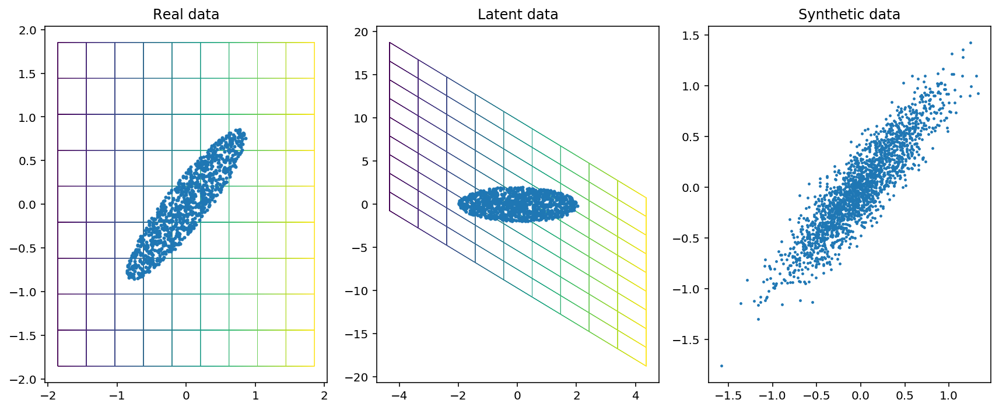

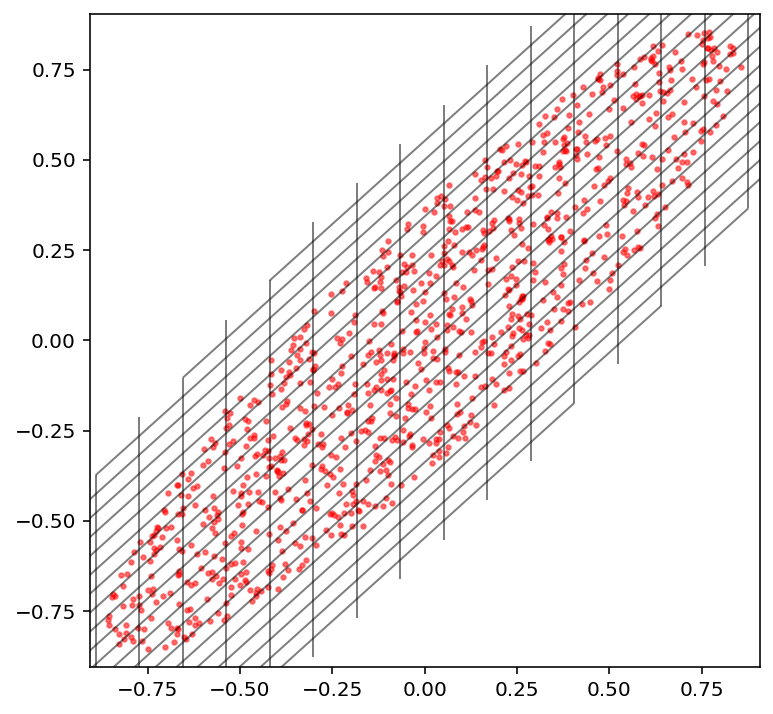

Creating directory for new run logs/test/run11
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


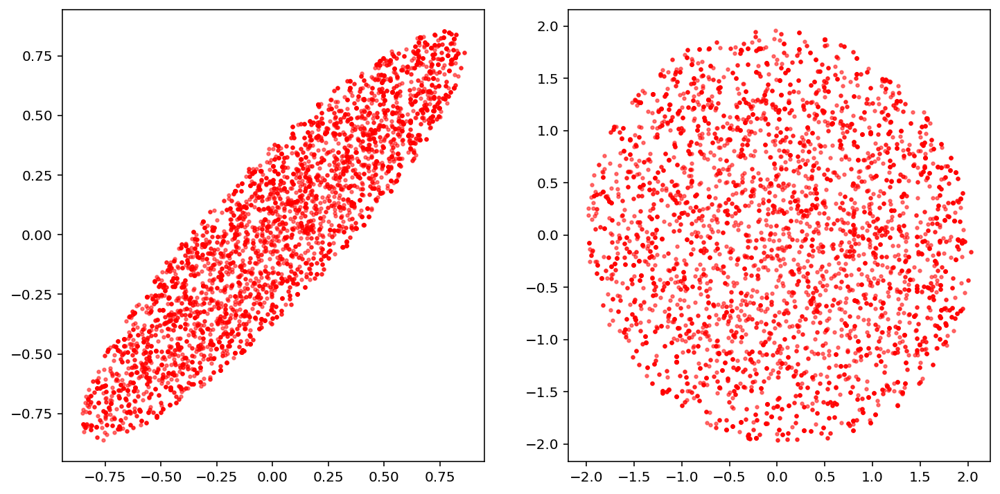

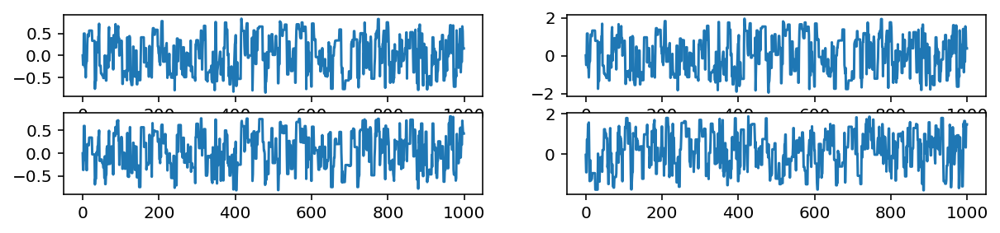

Removed no burn in
803.9911614143406
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.10E+00            6.10             820
param2           5.79E+00            5.79             864


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0852  p_{1}
param2        0.0846  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00693
  2      0.01267

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0765   0.0786   0.0712 upper
param1       0.0278   0.0385   0.0469 lower
param2       0.0670   0.0568   0.0627 upper
param2       0.0041   0.0092   0.0240 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

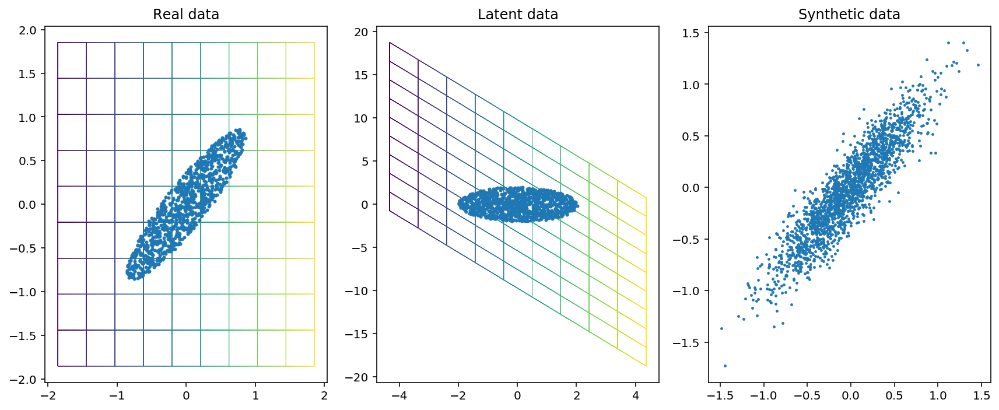

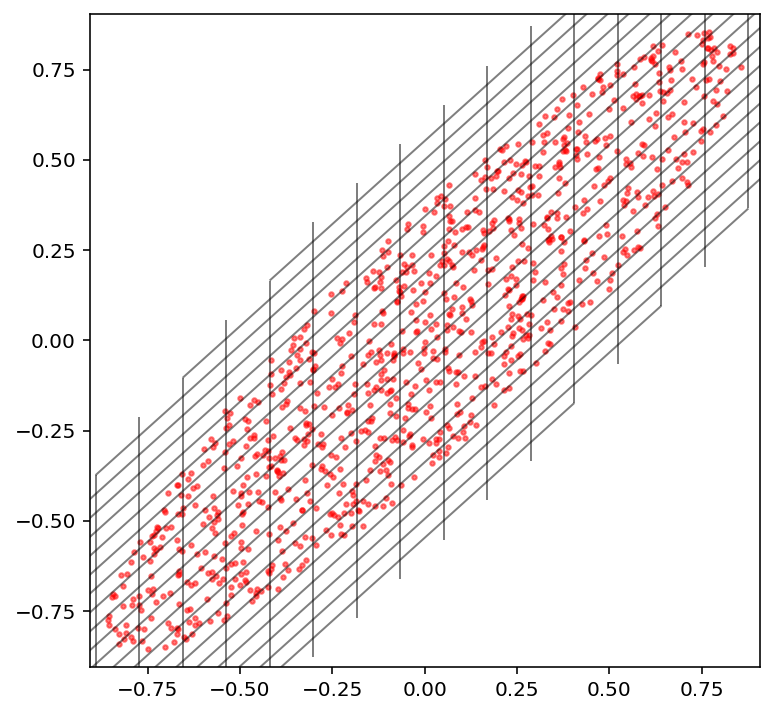

Creating directory for new run logs/test/run12
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


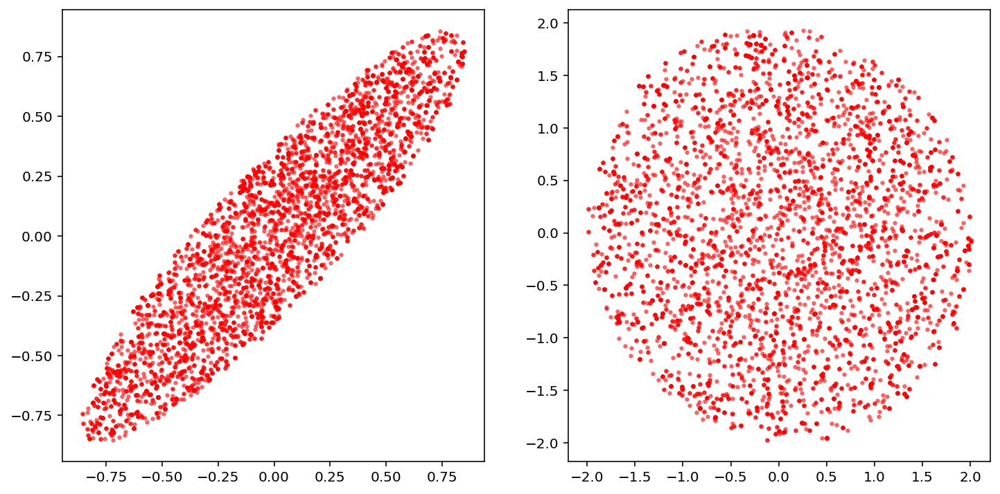

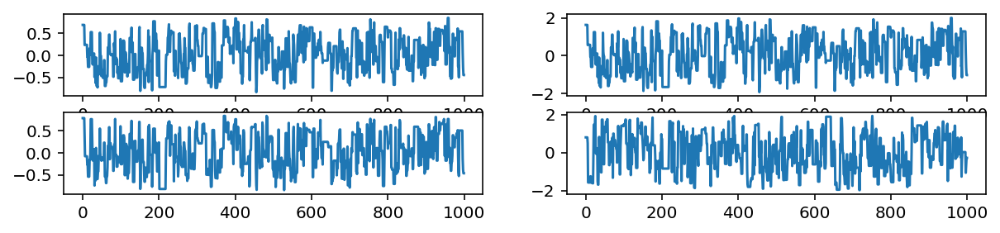

Removed no burn in
713.1784826371506
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.97E+00            6.97             718
param2           6.80E+00            6.80             736


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0574  p_{1}
param2        0.0495  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00214
  2      0.00419

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0505   0.0931   0.0597 upper
param1       0.0147   0.0129   0.0552 lower
param2       0.0163   0.0309   0.0172 upper
param2       0.0251   0.0744   0.0705 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

In [10]:
model = Trainer(like.x_dim, flow='choleksy', learning_rate=0.001)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

[nnest.trainer] [INFO] SingleSpeedNVP(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): CouplingLayer(
        (scale_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
          (1): Tanh()
          (2): Linear(in_features=64, out_features=64, bias=True)
          (3): Tanh()
          (4): Linear(in_features=64, out_features=64, bias=True)
          (5): Tanh()
          (6): Linear(in_features=64, out_features=2, bias=True)
        )
        (translate_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
          (1): ReLU()
          (2): Linear(in_features=64, out_features=64, bias=True)
          (3): ReLU()
          (4): Linear(in_features=64, out_features=64, bias=True)
          (5): ReLU()
          (6): Linear(in_features=64, out_features=2, bias=True)
        )
      )
      (1): CouplingLayer(
        (scale_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
     

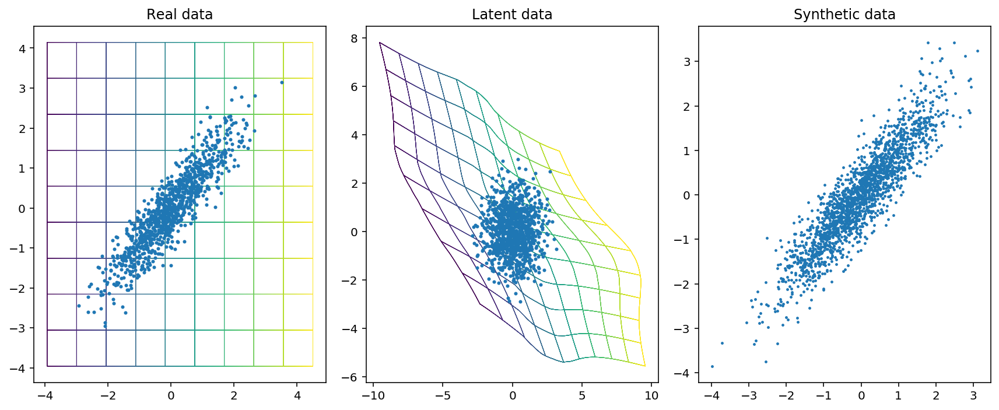

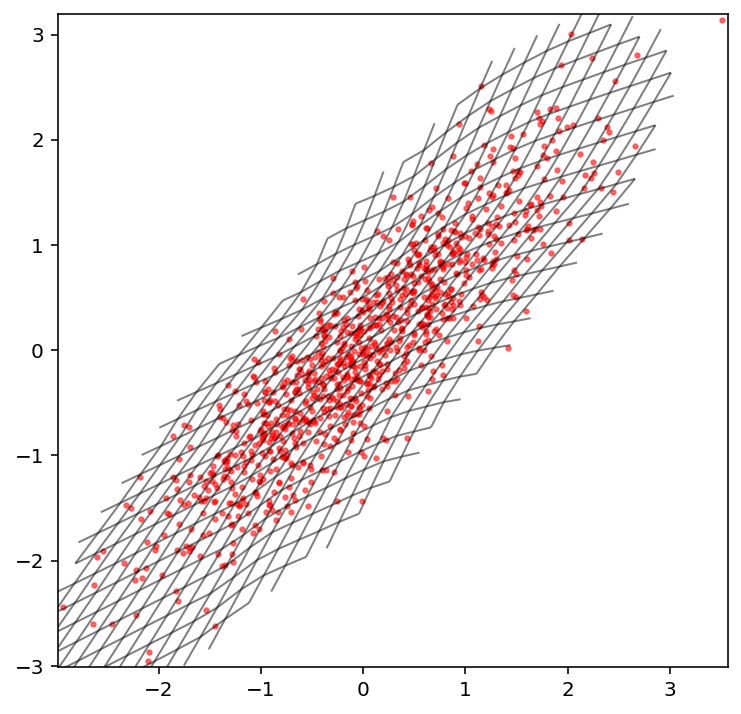

Creating directory for new run logs/test/run13
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


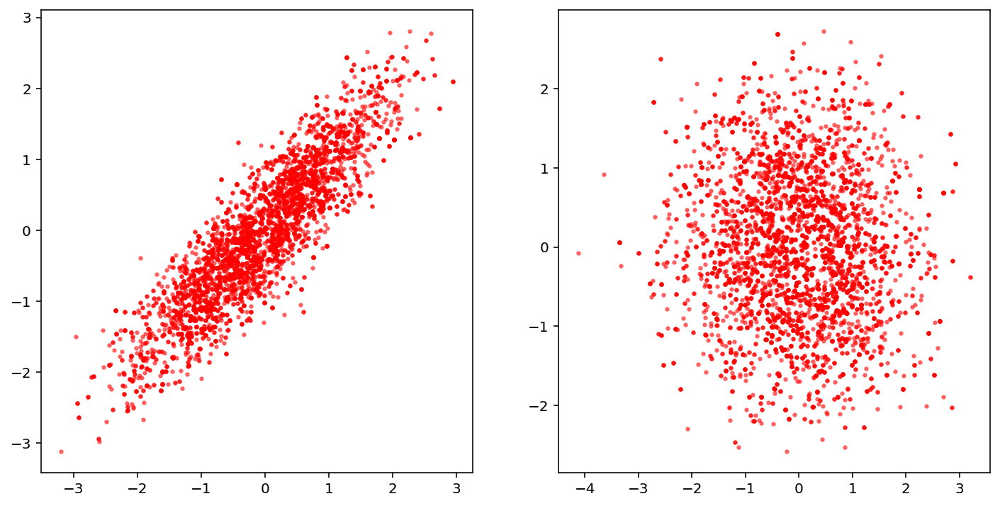

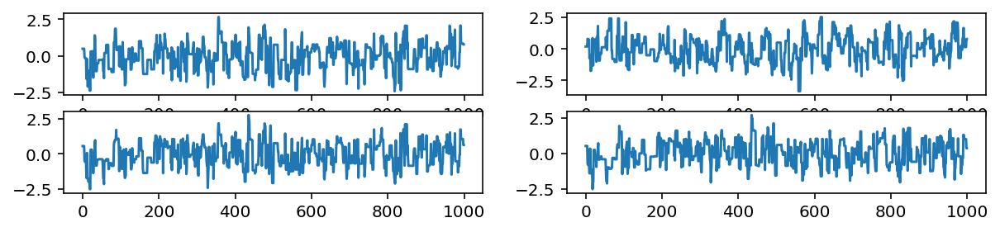

Removed no burn in
678.957737068181
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.07E+00            7.07             707
param2           6.30E+00            6.30             793


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1377  p_{1}
param2        0.0861  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00345
  2      0.03000

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.1055   0.1075   0.2512 upper
param1       0.0735   0.0335   0.0532 lower
param2       0.1043   0.1402   0.1495 upper
param2       0.0543   0.1770   0.1708 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1           

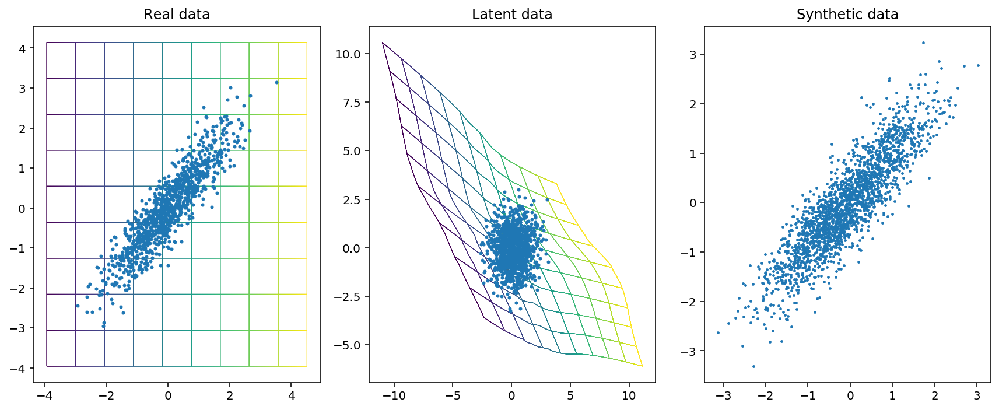

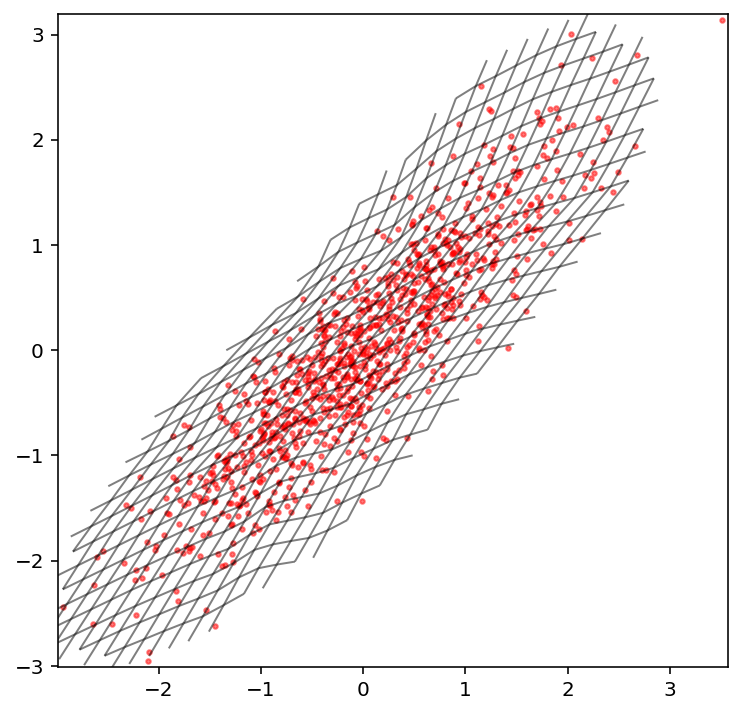

Creating directory for new run logs/test/run14
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


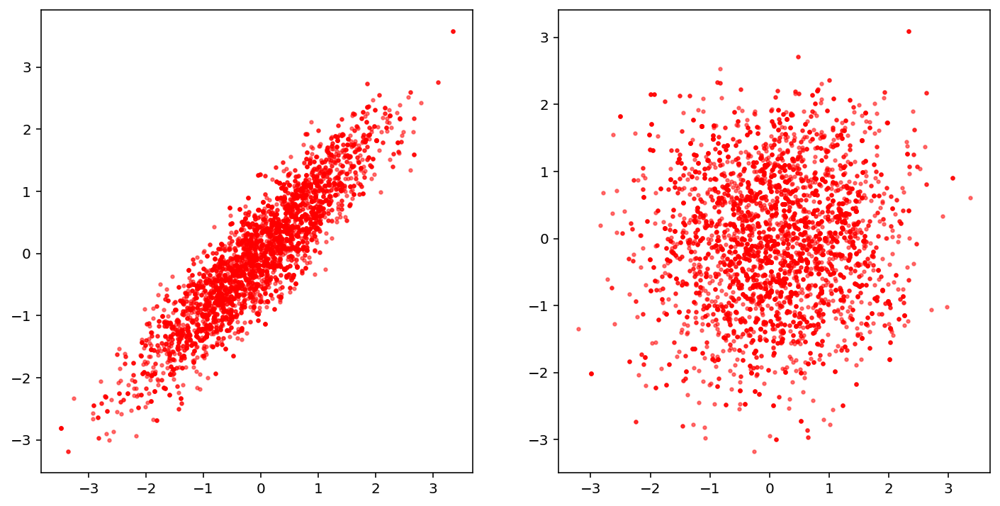

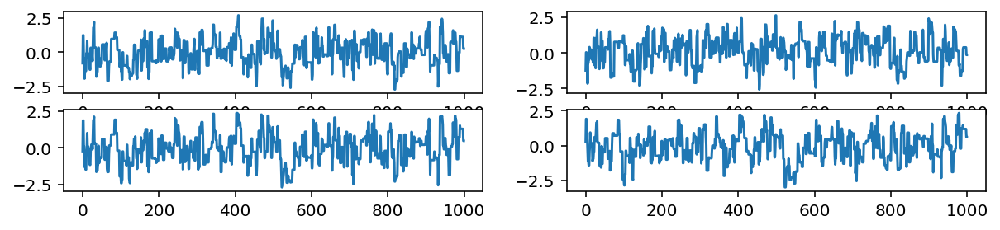

Removed no burn in
744.8093210389982
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.68E+00            6.68             748
param2           7.05E+00            7.05             710


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0587  p_{1}
param2        0.0685  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00195
  2      0.00508

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0153   0.0237   0.0275 upper
param1       0.0597   0.0952   0.1697 lower
param2       0.0496   0.1073   0.1078 upper
param2       0.0245   0.2320   0.1432 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

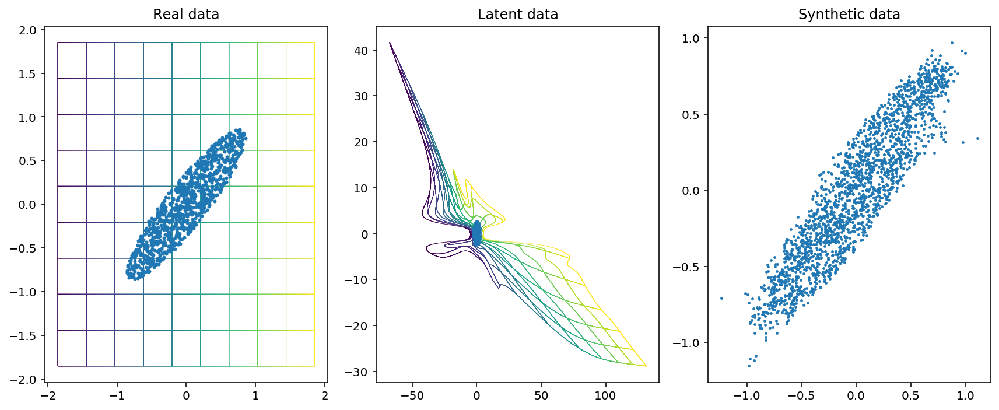

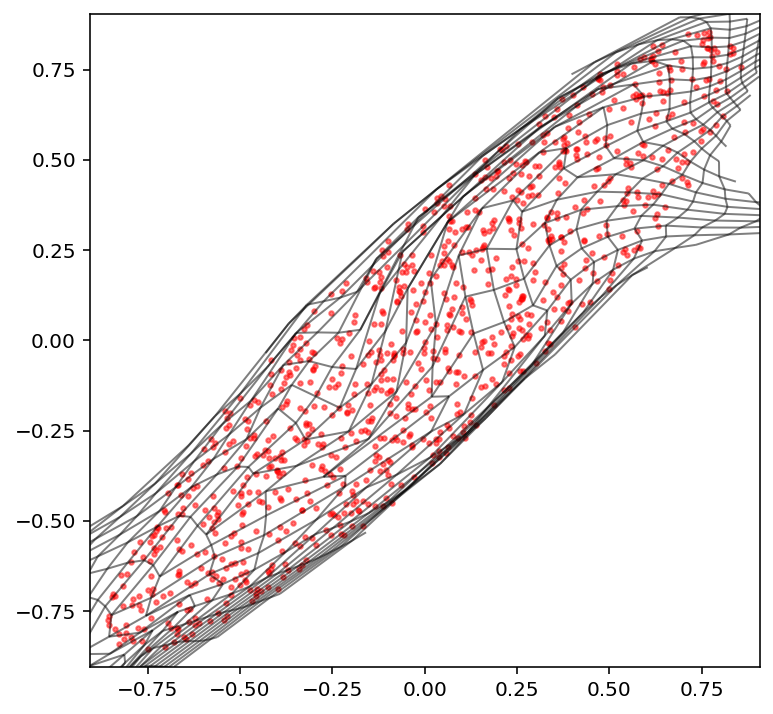

Creating directory for new run logs/test/run15
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


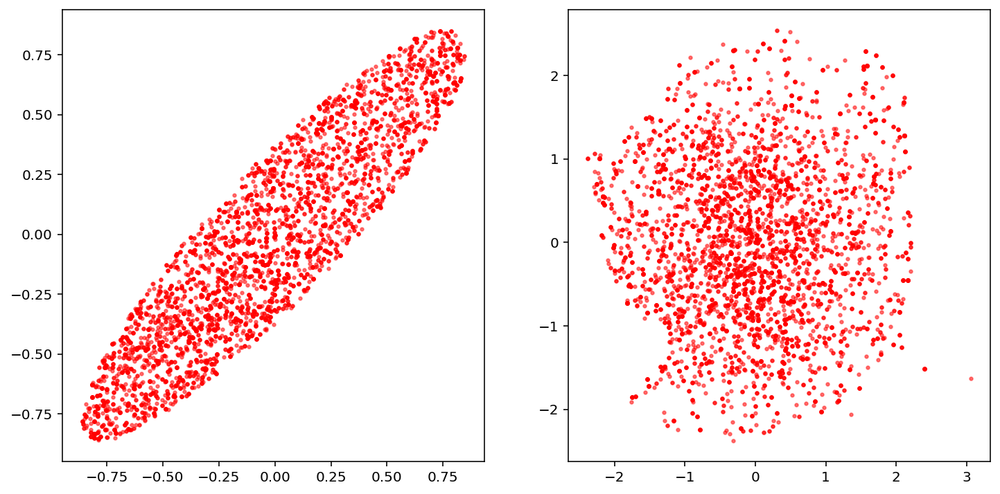

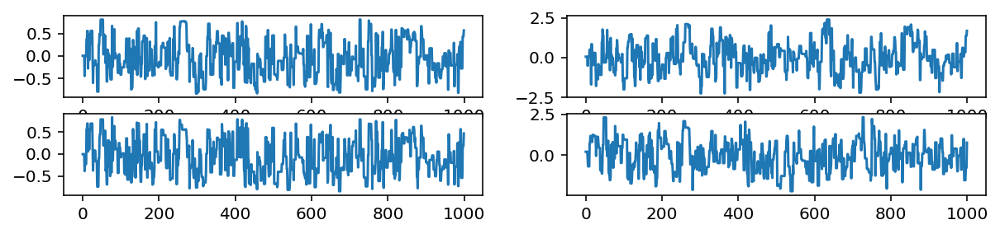

Removed no burn in
660.3281084174167
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.55E+00            7.55             662
param2           7.23E+00            7.23             692


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0423  p_{1}
param2        0.0563  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00171
  2      0.01378

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0206   0.0194   0.0387 upper
param1       0.0006   0.0172   0.0548 lower
param2       0.0403   0.0556   0.0519 upper
param2       0.0506   0.0661   0.0526 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

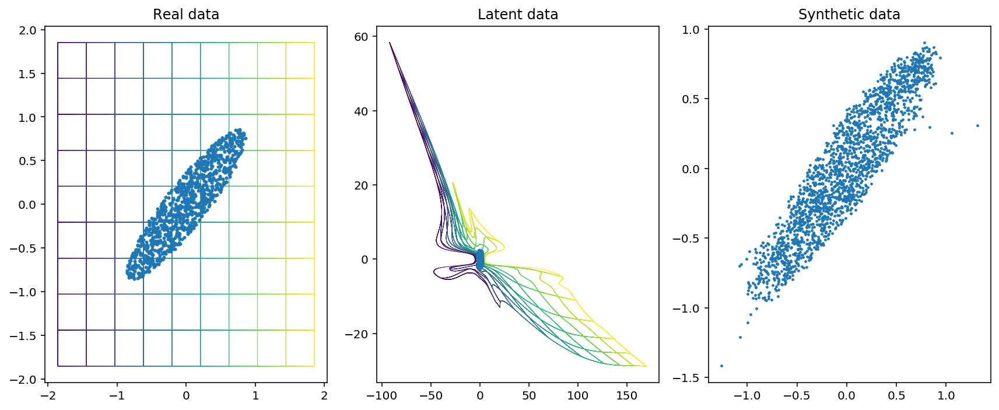

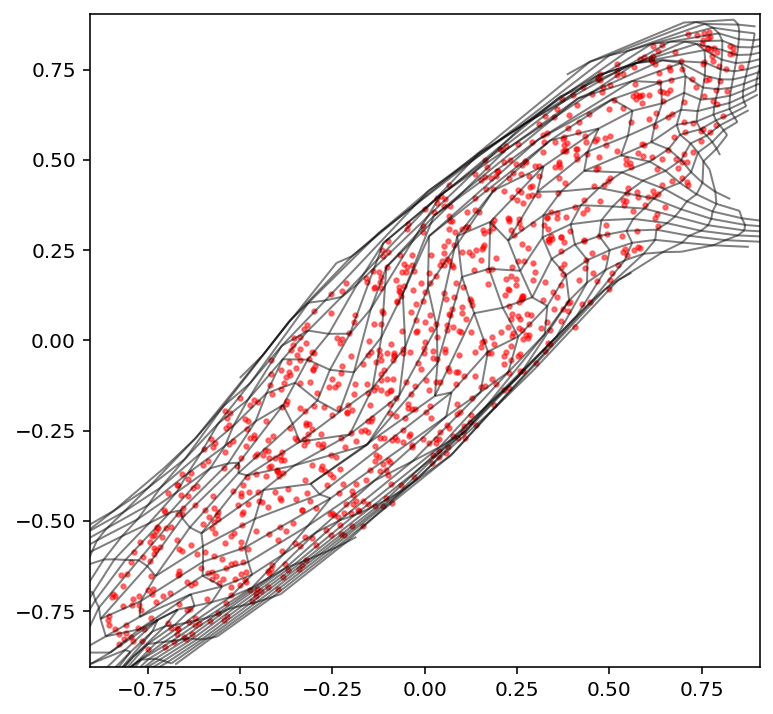

Creating directory for new run logs/test/run16
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


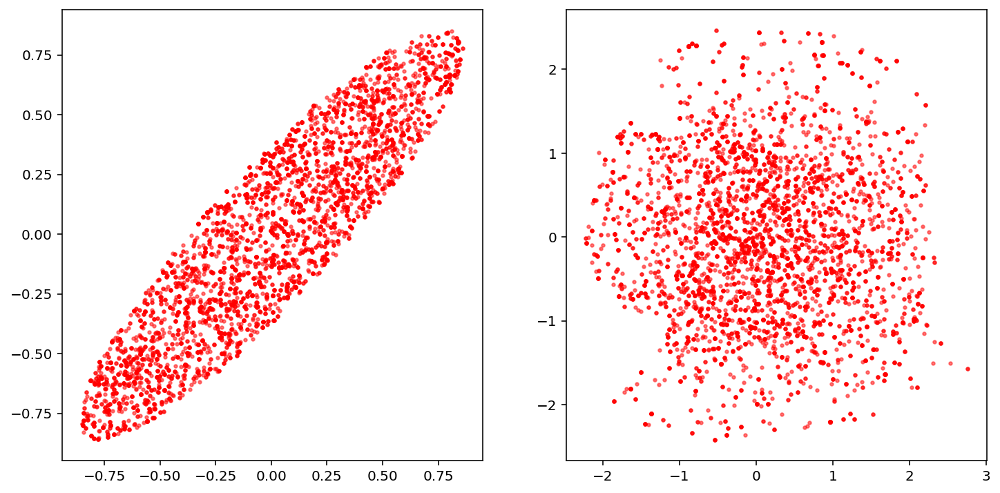

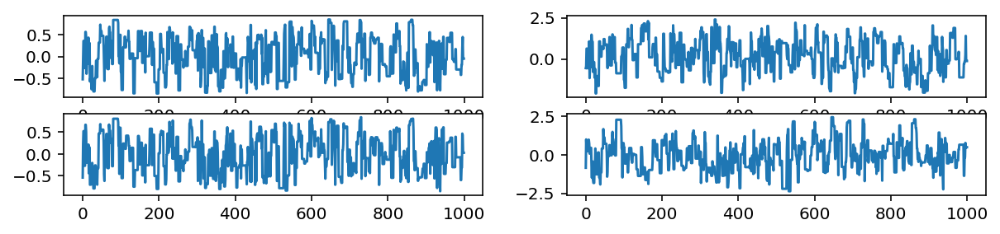

Removed no burn in
772.9729461520678
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.40E+00            6.40             782
param2           6.17E+00            6.17             810


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0755  p_{1}
param2        0.0559  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00277
  2      0.01055

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0340   0.0864   0.0817 upper
param1       0.0218   0.0256   0.0498 lower
param2       0.0341   0.0400   0.0481 upper
param2       0.0218   0.0711   0.0781 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

In [11]:
model = Trainer(like.x_dim, hidden_dim=64, num_blocks=5, flow='nvp', learning_rate=0.001)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

[nnest.trainer] [INFO] SingleSpeedSpline(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): ActNorm()
      (1): Invertible1x1Conv()
      (2): NSF_CL(
        (f1): MLP(
          (net): Sequential(
            (0): Linear(in_features=1, out_features=16, bias=True)
            (1): LeakyReLU(negative_slope=0.2)
            (2): Linear(in_features=16, out_features=16, bias=True)
            (3): LeakyReLU(negative_slope=0.2)
            (4): Linear(in_features=16, out_features=16, bias=True)
            (5): LeakyReLU(negative_slope=0.2)
            (6): Linear(in_features=16, out_features=23, bias=True)
          )
        )
        (f2): MLP(
          (net): Sequential(
            (0): Linear(in_features=1, out_features=16, bias=True)
            (1): LeakyReLU(negative_slope=0.2)
            (2): Linear(in_features=16, out_features=16, bias=True)
            (3): LeakyReLU(negative_slope=0.2)
            (4): Linear(in_features=16, out_features=16, bias=True)
        

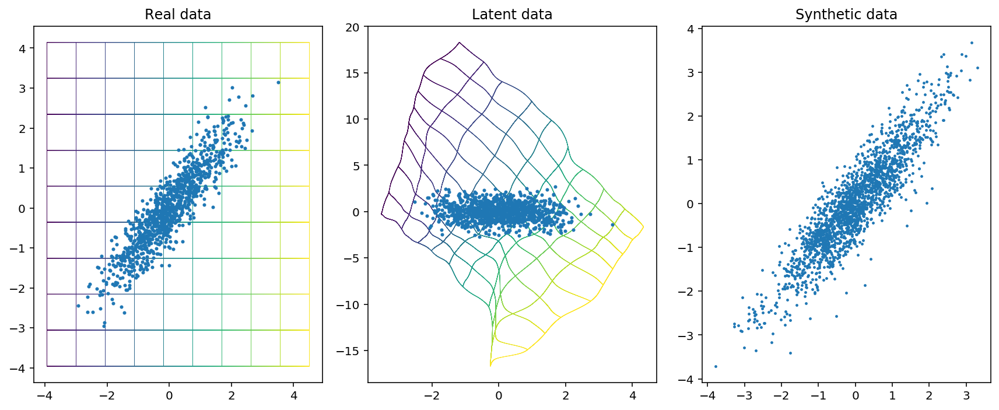

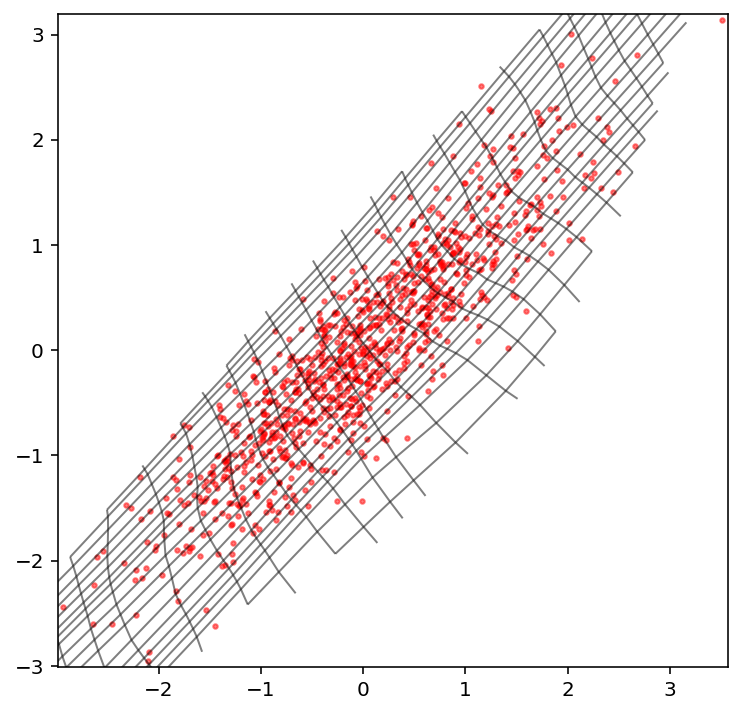

Creating directory for new run logs/test/run17
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


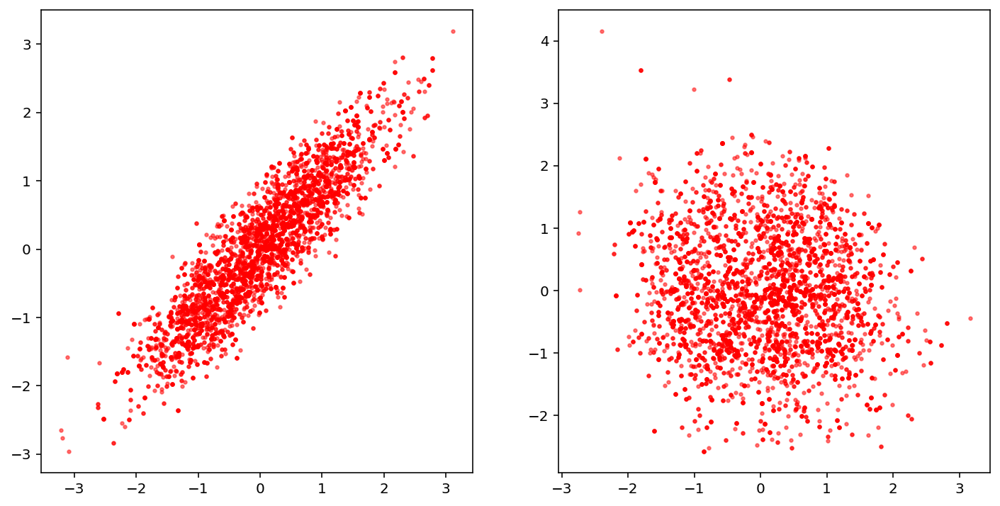

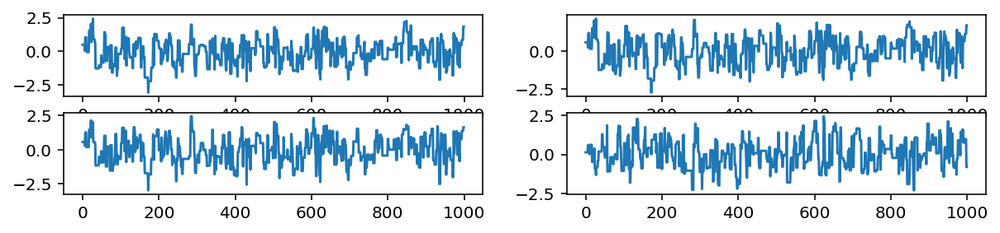

Removed no burn in
685.6768094725882
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.26E+00            7.26             689
param2           6.11E+00            6.11             819


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0484  p_{1}
param2        0.0638  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00210
  2      0.02098

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.1185   0.1695   0.2046 upper
param1       0.1127   0.0637   0.1400 lower
param2       0.0479   0.1249   0.1245 upper
param2       0.0248   0.0955   0.1065 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

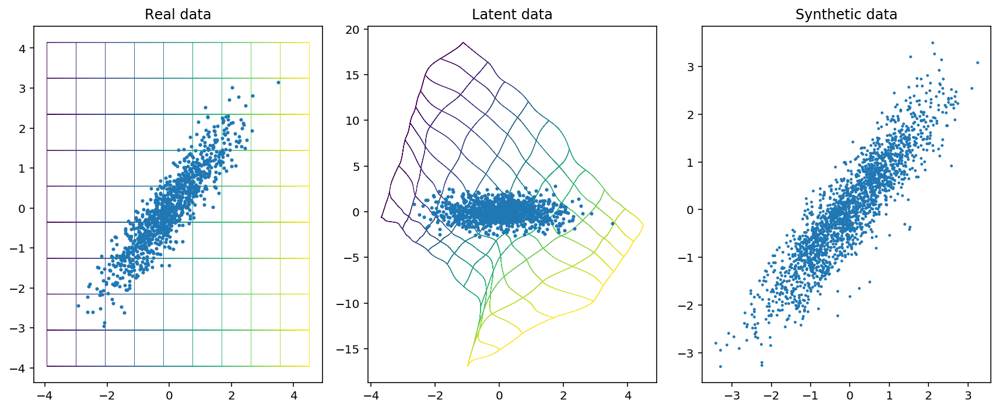

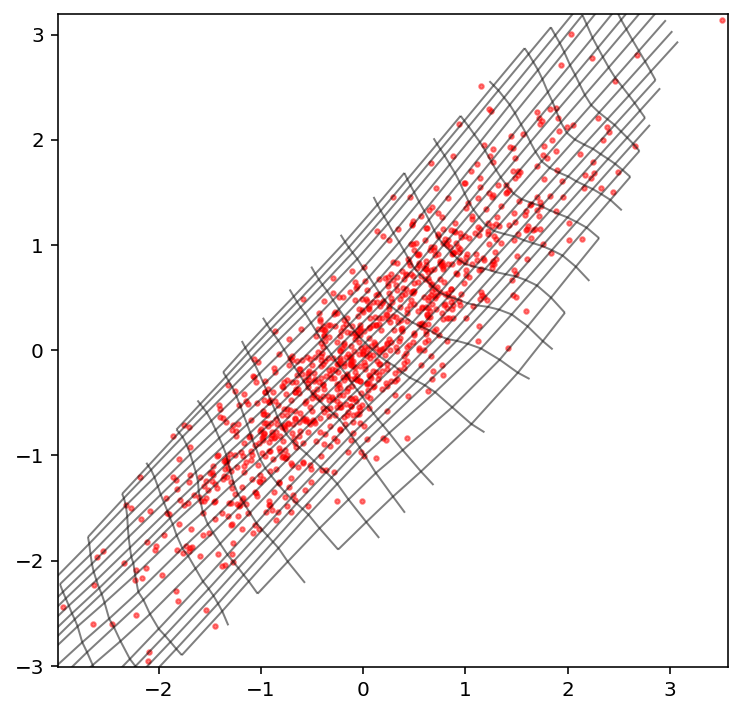

Creating directory for new run logs/test/run18
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


--- Logging error ---
Traceback (most recent call last):
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/sampler.py", line 342, in _mcmc_sample
    x_prime, log_det_J_prime = self.trainer.netG.inverse(z_prime)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 69, in inverse
    return self.flow.inverse(z)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 39, in inverse
    z, ld = flow.inverse(z)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 609, in inverse
    lower, ld = unconstrained_RQS(lower, W, H, D, inverse=True, tail_bound=self.B)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 444, in unconstrained_RQS
    outputs[inside_intvl_mask], logabsdet[inside_intvl_mask] = RQS(
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 463, in RQS
    if torch.min(inputs) < left or torch.max(inputs) > right:
RuntimeError: operation does not have an identity.

During handling of the above

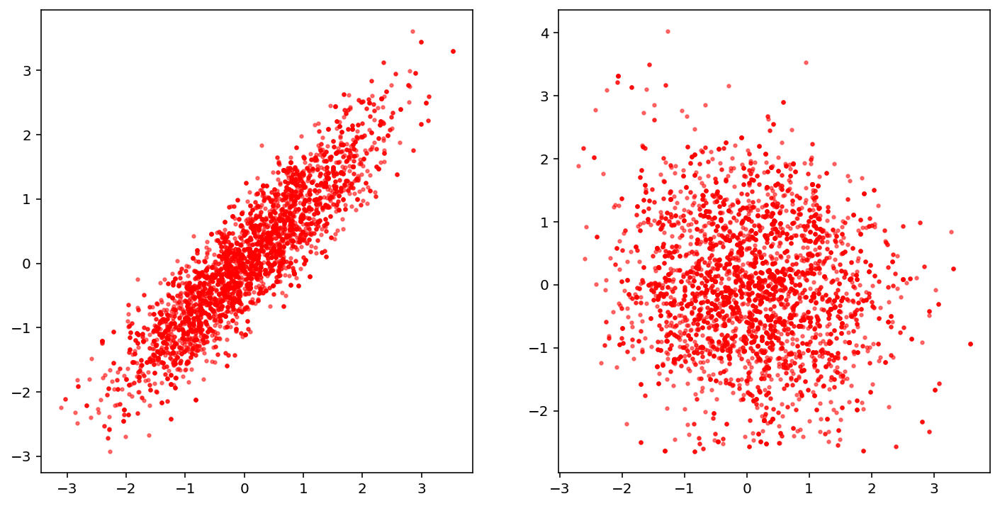

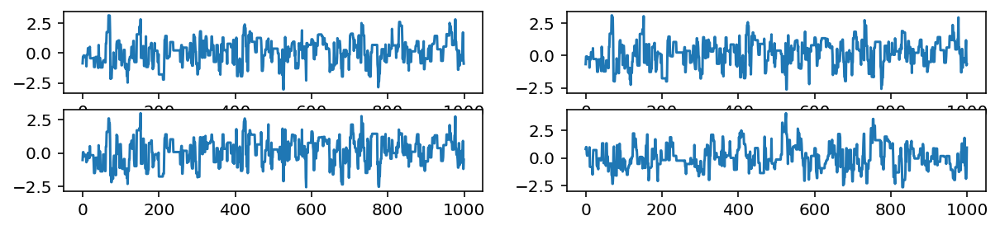

Removed no burn in
624.6889641059919
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.90E+00            7.90             632
param2           7.00E+00            7.00             714


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0812  p_{1}
param2        0.0849  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00295
  2      0.00722

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0404   0.0478   0.1333 upper
param1       0.0942   0.0859   0.1150 lower
param2       0.0070   0.0322   0.0790 upper
param2       0.0734   0.0750   0.1280 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

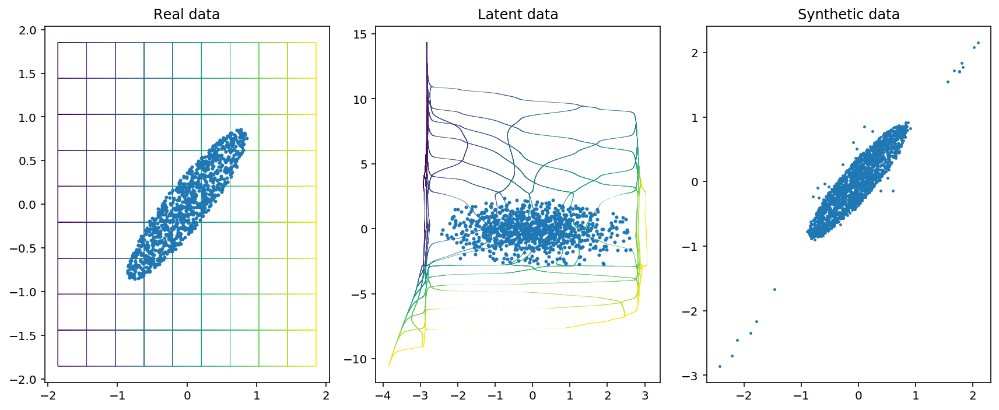

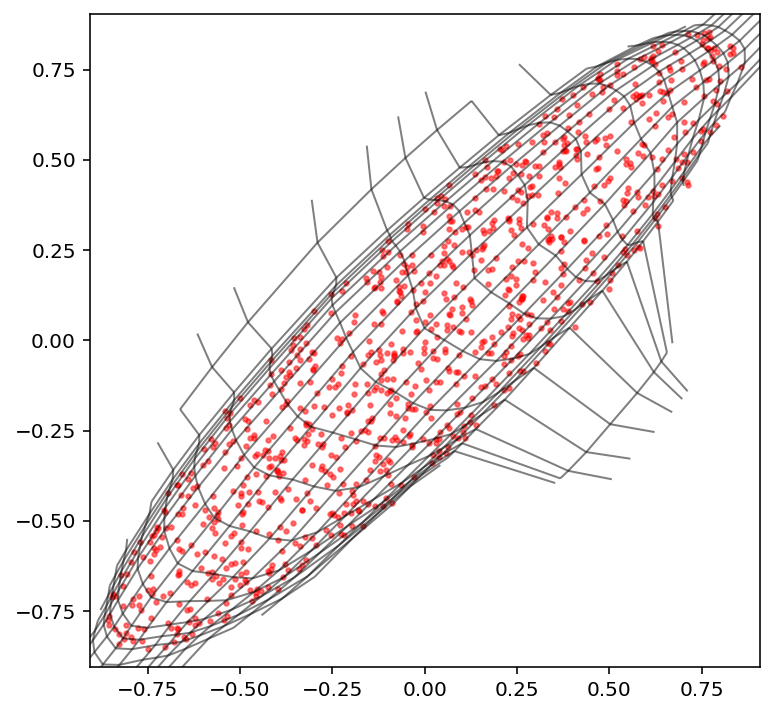

Creating directory for new run logs/test/run19
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


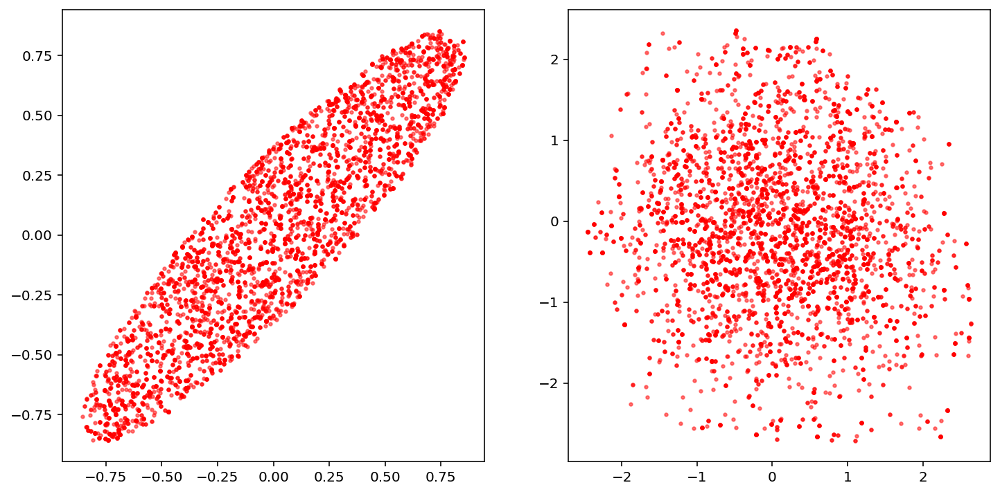

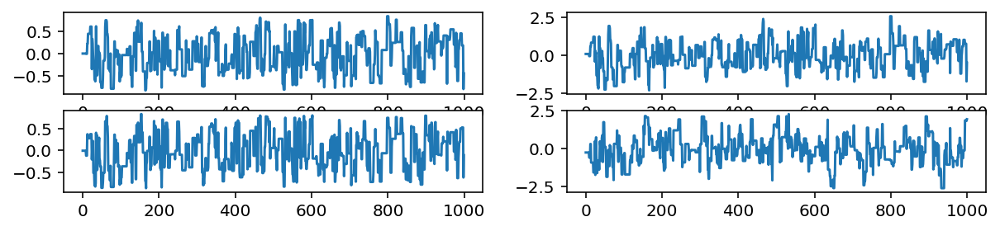

Removed no burn in
744.7704111730496
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.45E+00            6.45             776
param2           6.21E+00            6.21             805


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1146  p_{1}
param2        0.1102  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00357
  2      0.01323

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0112   0.0162   0.0774 upper
param1       0.0071   0.0250   0.0251 lower
param2       0.0337   0.0347   0.0356 upper
param2       0.0265   0.0227   0.0349 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

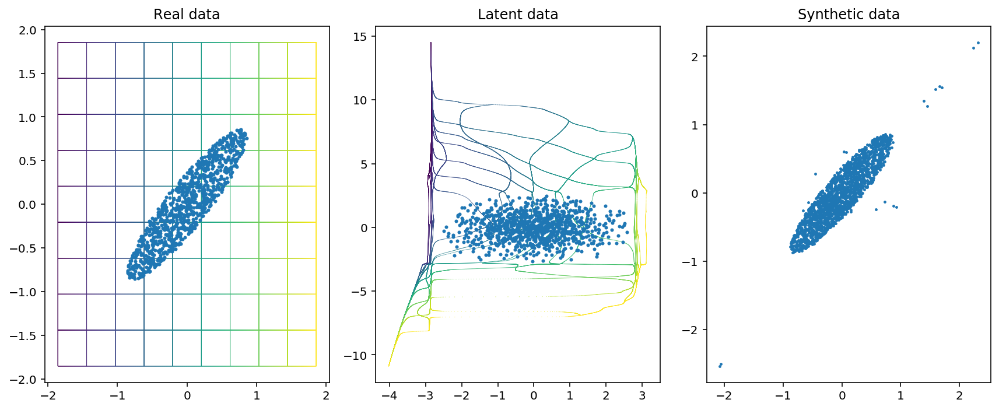

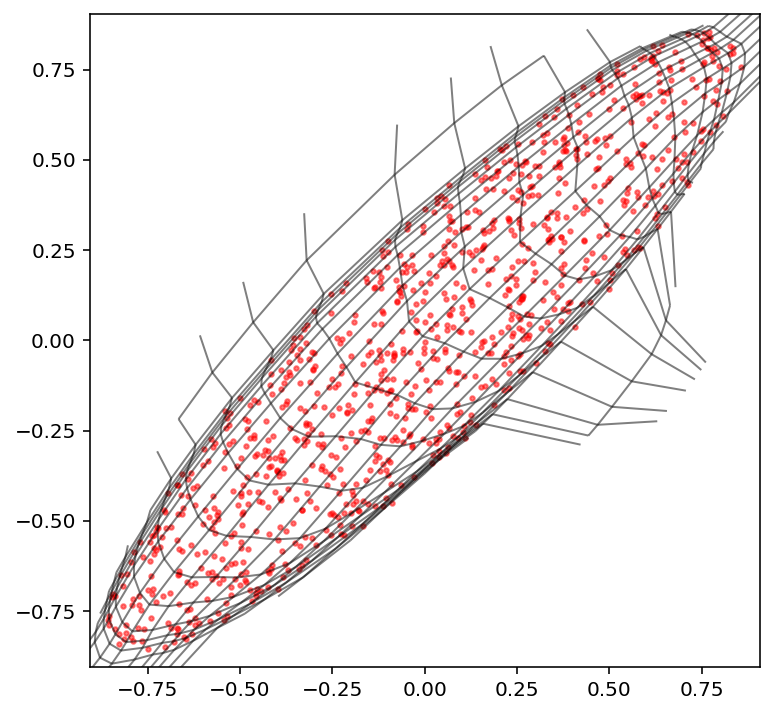

Creating directory for new run logs/test/run20
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


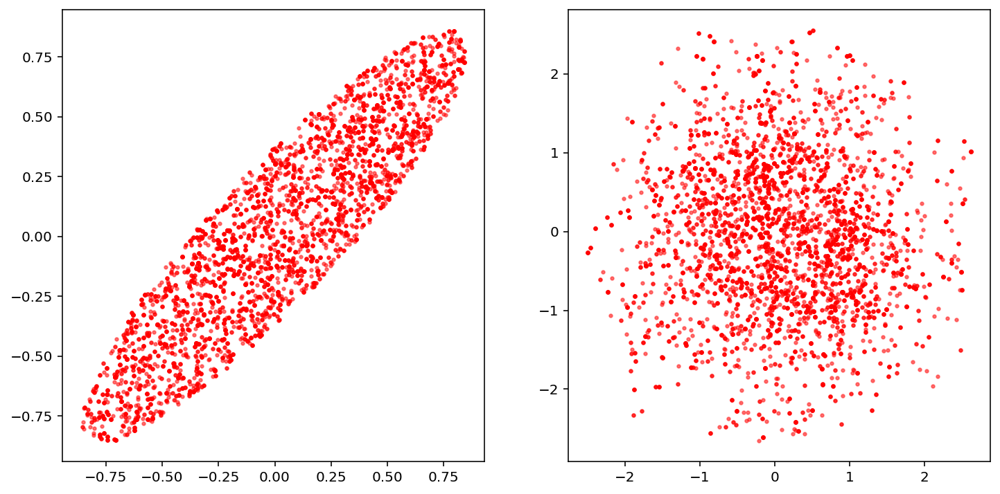

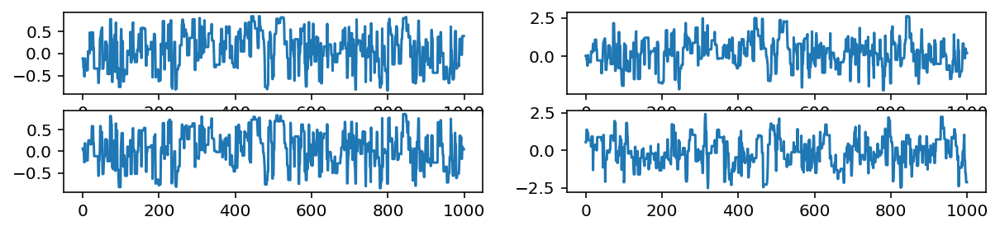

Removed no burn in
787.2888127946487
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.25E+00            6.25             800
param2           5.97E+00            5.97             838


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0988  p_{1}
param2        0.1013  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00973
  2      0.01376

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0249   0.0447   0.0485 upper
param1       0.0245   0.0182   0.0607 lower
param2       0.0532   0.0326   0.0664 upper
param2       0.0195   0.0290   0.0289 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

In [12]:
model = Trainer(like.x_dim, flow='spline', learning_rate=0.001)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

In [13]:
like = Himmelblau(2)
prior = UniformPrior(2, -5, 5)

[nnest.trainer] [INFO] SingleSpeedCholeksy(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): Choleksy()
    )
  )
)
[nnest.trainer] [INFO] Number of network params: [5]
[nnest.trainer] [INFO] Device [cpu]
[nnest.trainer] [INFO] Number of training samples [1000]
[nnest.trainer] [INFO] Training jitter [0.0010]
[nnest.trainer] [INFO] Epoch [1] train loss [0.1020] validation loss [0.1043]
[nnest.trainer] [INFO] Epoch [100] train loss [0.0589] validation loss [0.0614]
[nnest.trainer] [INFO] Epoch [200] train loss [0.0507] validation loss [0.0522]
[nnest.trainer] [INFO] Epoch [300] train loss [0.0491] validation loss [0.0502]
[nnest.trainer] [INFO] Epoch [400] train loss [0.0489] validation loss [0.0498]
[nnest.trainer] [INFO] Epoch [500] train loss [0.0489] validation loss [0.0497]
[nnest.trainer] [INFO] Epoch [600] train loss [0.0489] validation loss [0.0497]
[nnest.trainer] [INFO] Epoch [666] ran out of patience
[nnest.trainer] [INFO] Best epoch [616] validation loss [0.0497

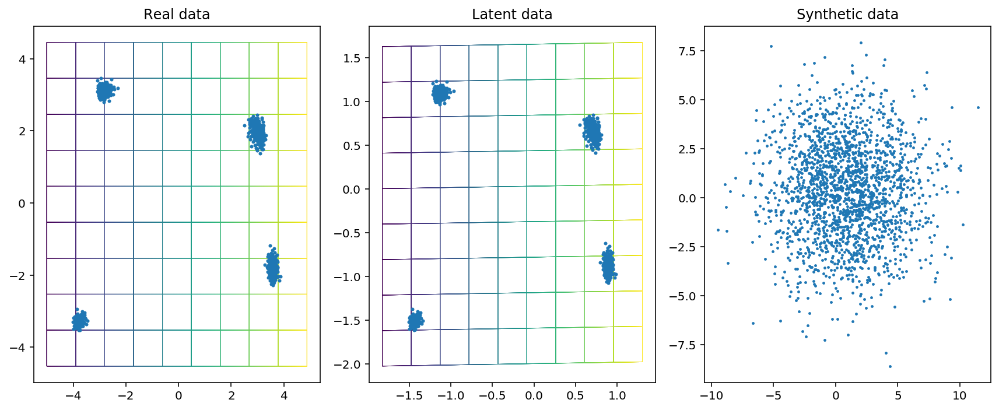

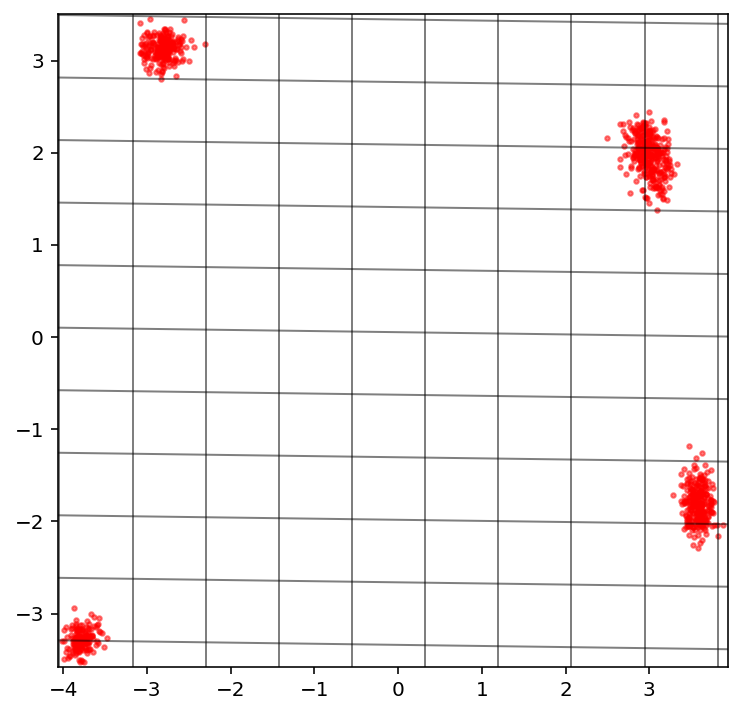

Creating directory for new run logs/test/run21
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


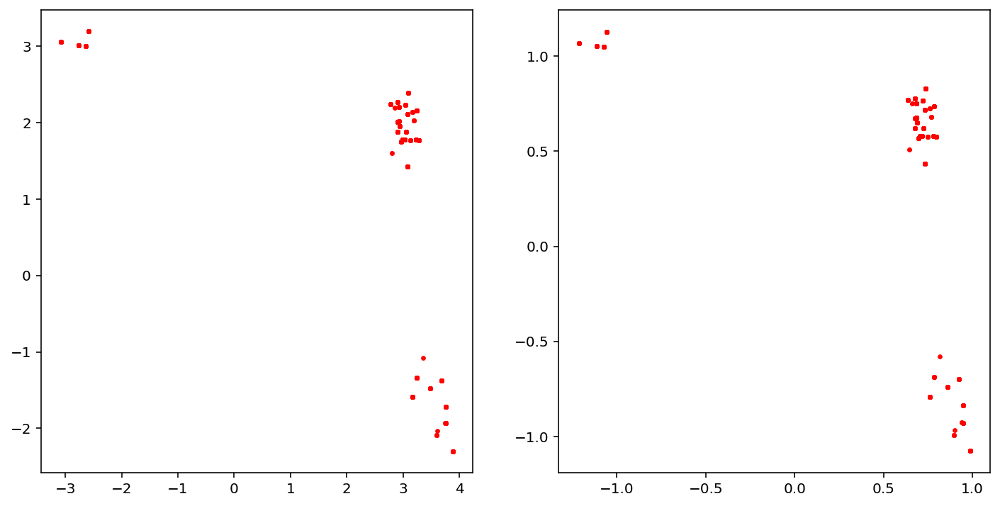

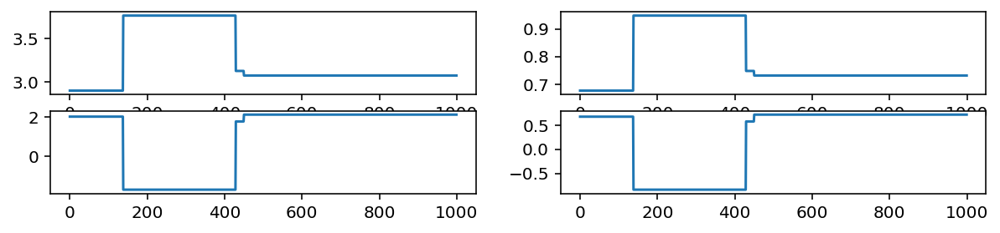

Removed no burn in
19.207605643400854
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.77E-01            0.78            6439
param2           8.73E-01            0.87            5732


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.5985  p_{1}
param2        0.4262  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.16449
  2      0.36651

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0445   0.1601   0.2231 upper
param1       0.1190   1.8217   2.2065 lower
param2       0.0731   0.3726   0.3690 upper
param2       0.2128   1.3837   1.3601 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enou

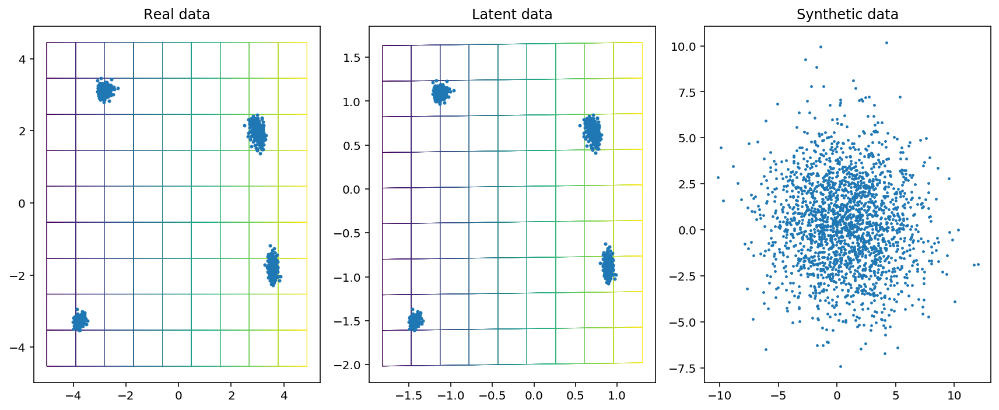

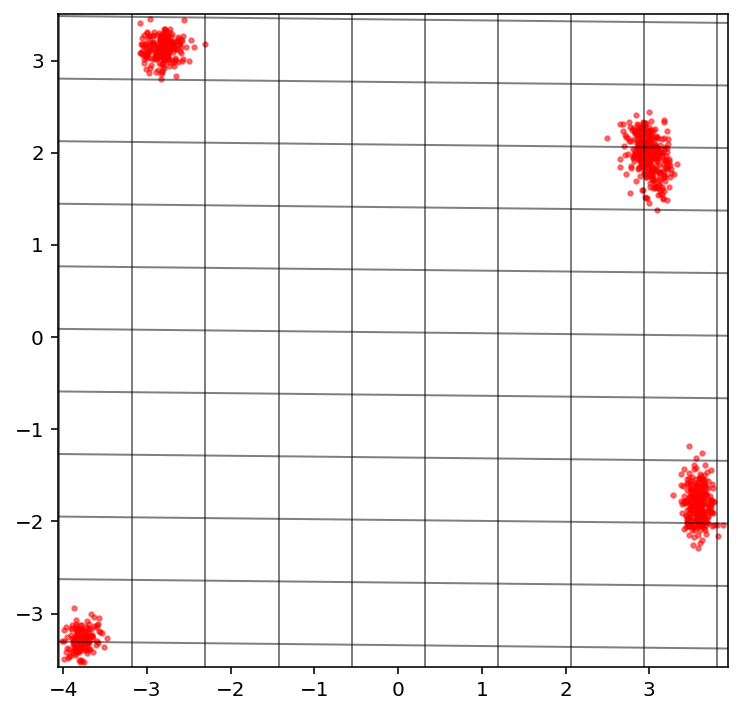

Creating directory for new run logs/test/run22
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


/Users/adammoss/work/code/MCMC/nnest/nnest/sampler.py:354: RuntimeWarning: invalid value encountered in subtract
  log_ratio_3 = torch.tensor(logl_prior_prime - logl_prior)


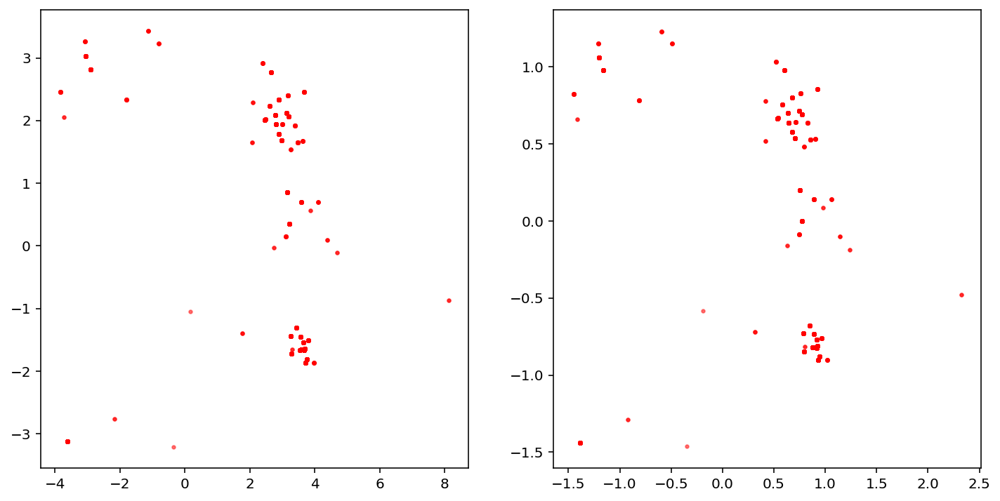

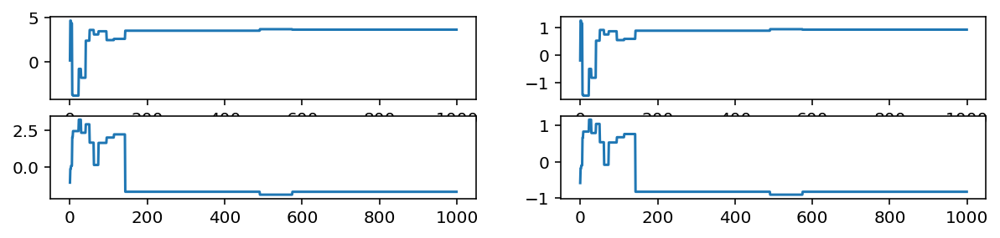

Removed no burn in
19.45410685151233
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.85E-01            0.78            6379
param2           7.55E-01            0.76            6626


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.5858  p_{1}
param2        0.6364  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.07295
  2      0.52956

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0192   0.0184   0.0209 upper
param1       1.8480   1.6266   1.9907 lower
param2       0.3296   0.1948   0.3333 upper
param2       0.4576   0.3737   0.3278 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enoug

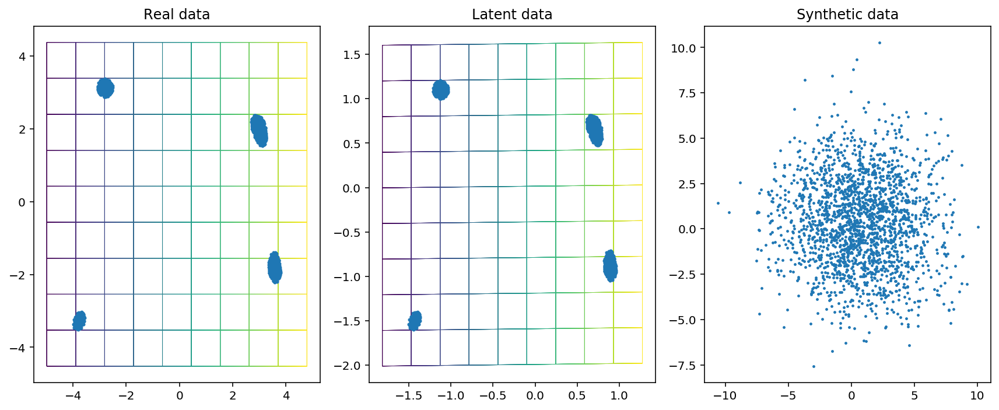

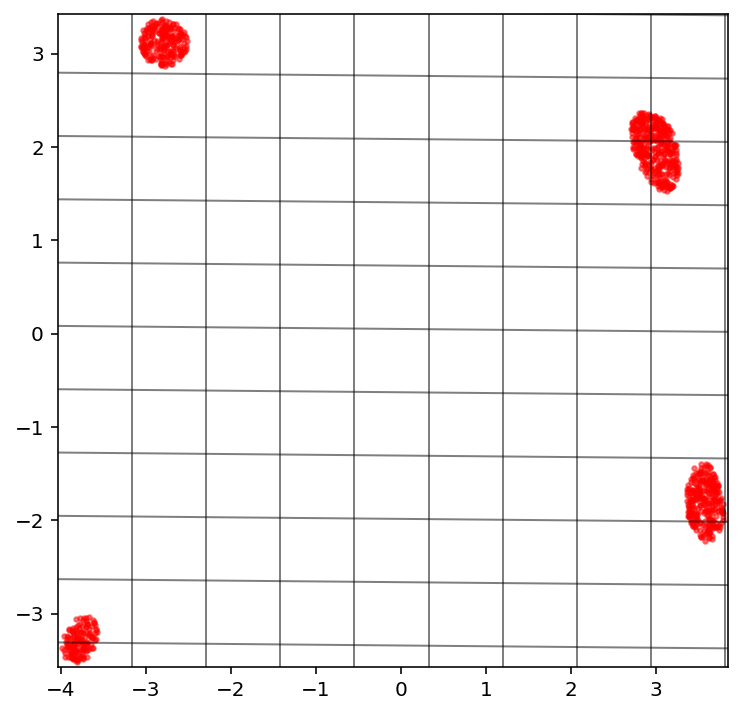

Creating directory for new run logs/test/run23
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


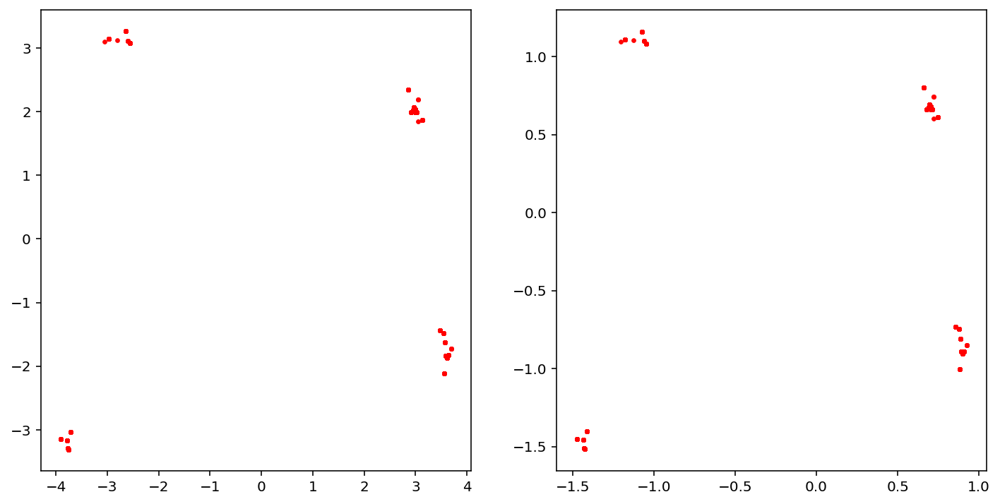

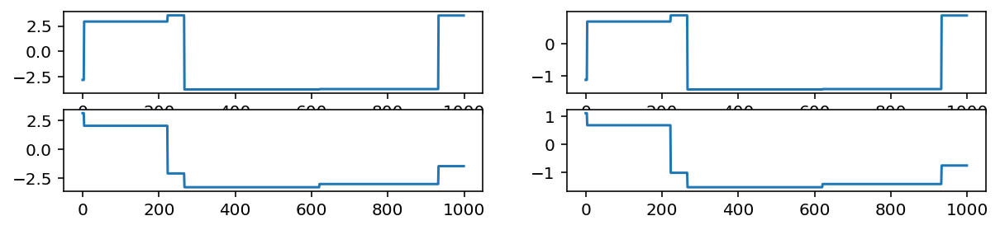

Removed no burn in
5005.000010209909
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           2.97E-01            0.30           16839
param2           7.93E-01            0.79            6308


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        1.7192  p_{1}
param2        0.5706  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.30787
  2      3.01592

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0058   0.0146   0.0133 upper
param1       0.0342   0.2448   1.0747 lower
param2       0.0545   0.2926   0.3153 upper
param2       0.0037   0.3474   0.4202 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enoug

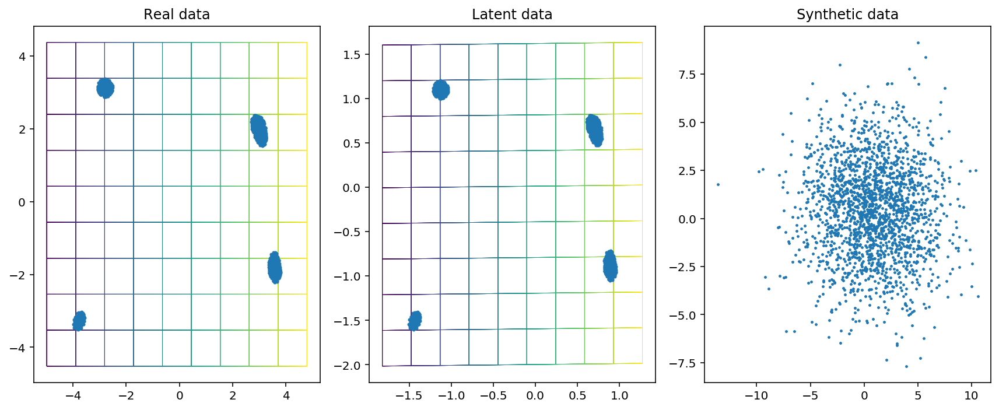

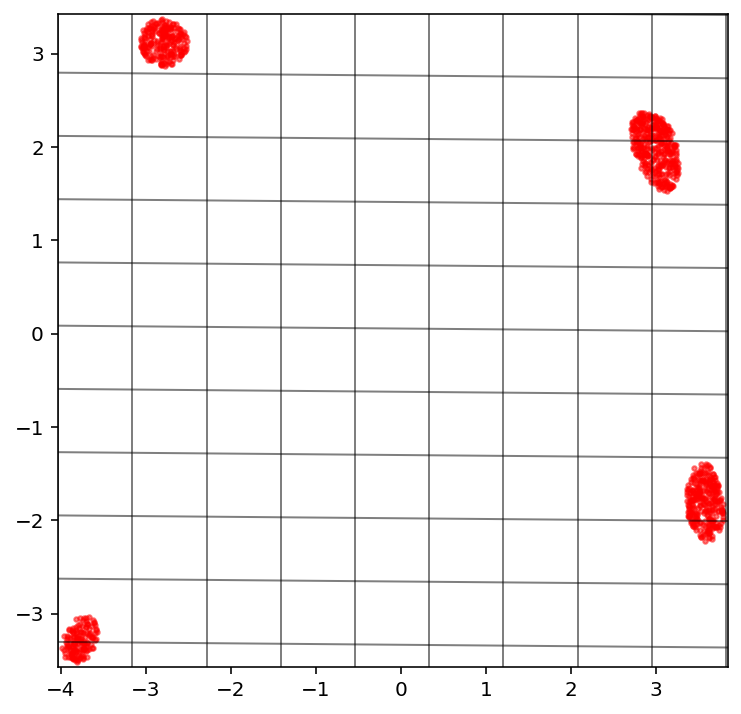

Creating directory for new run logs/test/run24
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


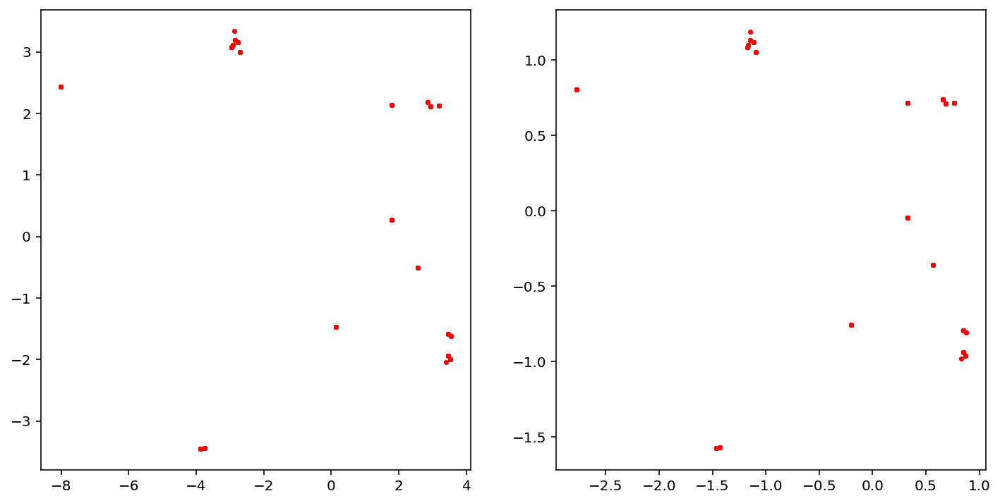

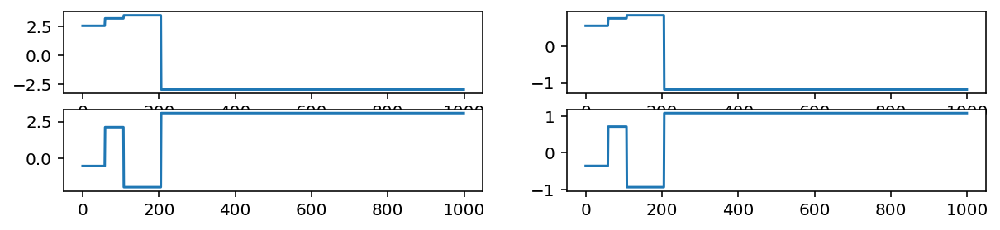

Removed no burn in
5004.999973177512
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           3.98E-01            0.40           12580
param2           1.95E-01            0.20           25622


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        1.3755  p_{1}
param2        2.2692  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      1.89149
  2      5.44611

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.7072   1.0592   1.0448 upper
param1       1.0554   1.1134   1.2285 lower
param2       0.0000   0.0278   0.0241 upper
param2       0.4023   0.3285   0.4107 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enoug

In [14]:
model = Trainer(like.x_dim, flow='choleksy', learning_rate=0.001)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

[nnest.trainer] [INFO] SingleSpeedNVP(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): CouplingLayer(
        (scale_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
          (1): Tanh()
          (2): Linear(in_features=64, out_features=64, bias=True)
          (3): Tanh()
          (4): Linear(in_features=64, out_features=64, bias=True)
          (5): Tanh()
          (6): Linear(in_features=64, out_features=2, bias=True)
        )
        (translate_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
          (1): ReLU()
          (2): Linear(in_features=64, out_features=64, bias=True)
          (3): ReLU()
          (4): Linear(in_features=64, out_features=64, bias=True)
          (5): ReLU()
          (6): Linear(in_features=64, out_features=2, bias=True)
        )
      )
      (1): CouplingLayer(
        (scale_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
     

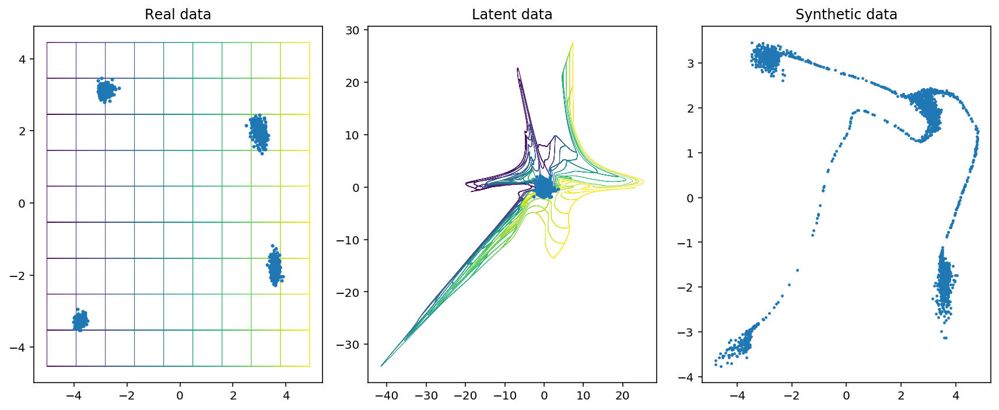

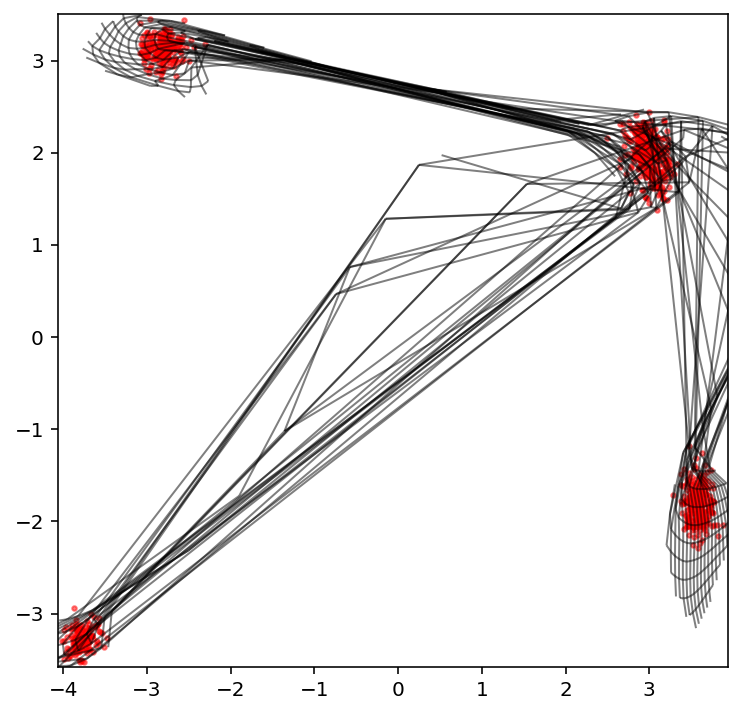

Creating directory for new run logs/test/run25
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


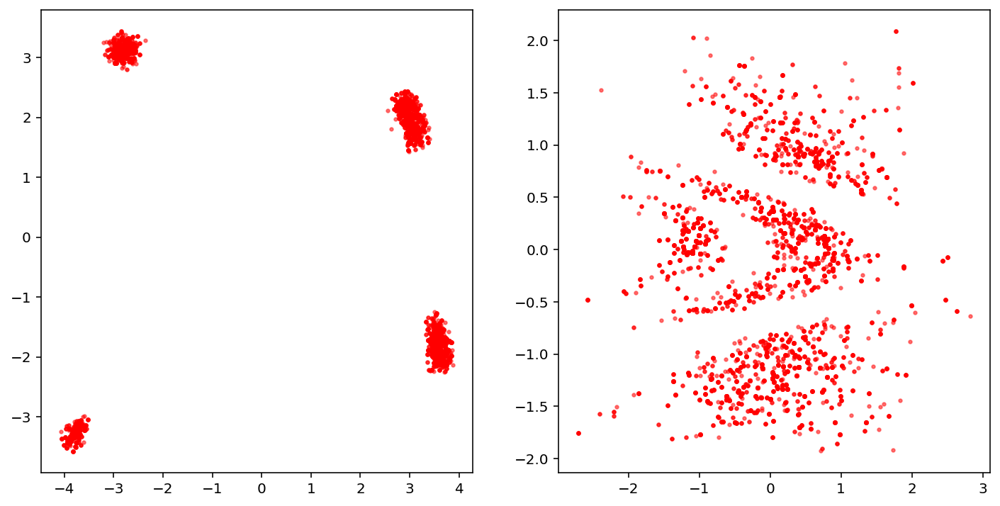

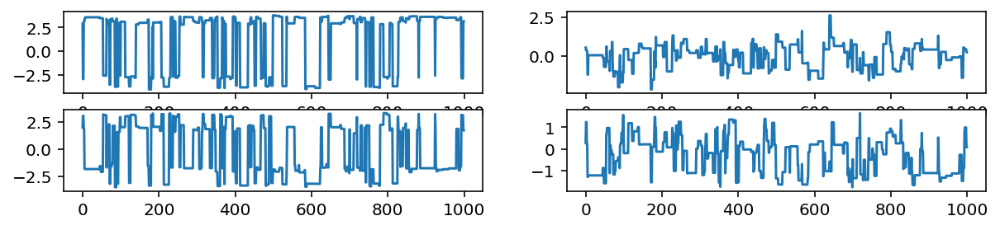

Removed no burn in
432.702688313612
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           1.13E+01           11.33             441
param2           1.30E+01           13.01             384


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0957  p_{1}
param2        0.1527  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00374
  2      0.02738

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0048   0.0070   0.0124 upper
param1       0.0069   0.0053   0.0080 lower
param2       0.0044   0.0054   0.0147 upper
param2       0.0049   0.0087   0.0059 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1           

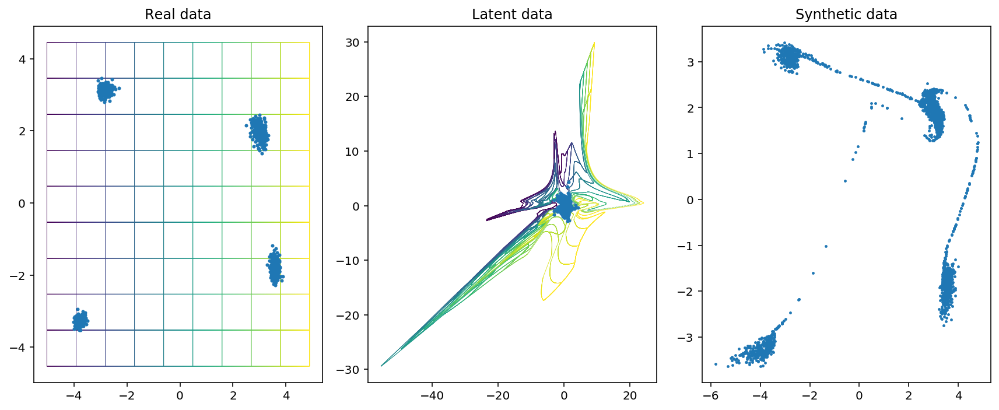

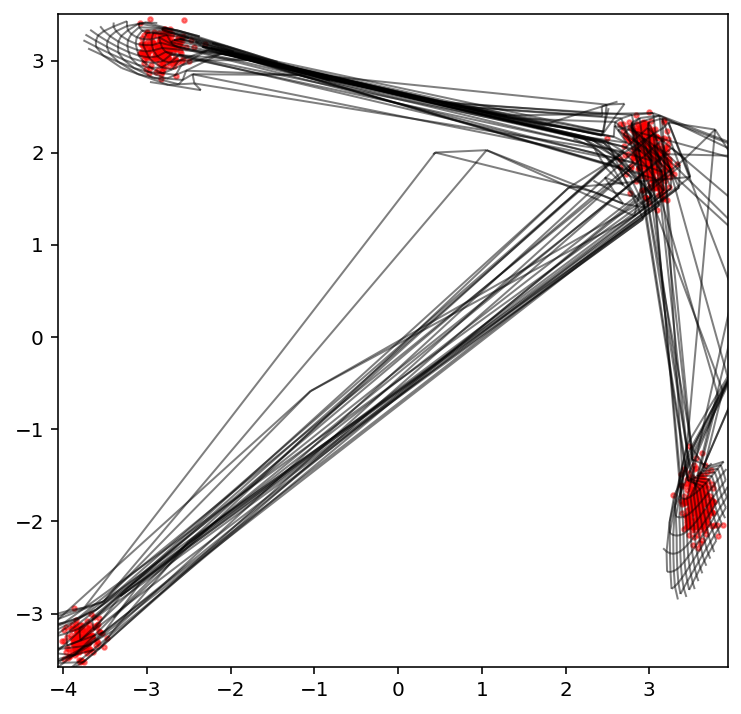

Creating directory for new run logs/test/run26
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


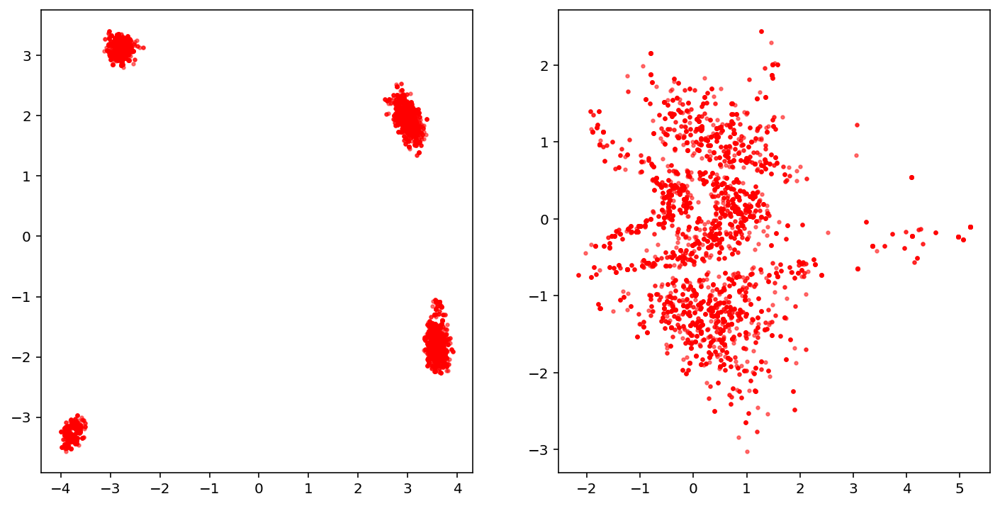

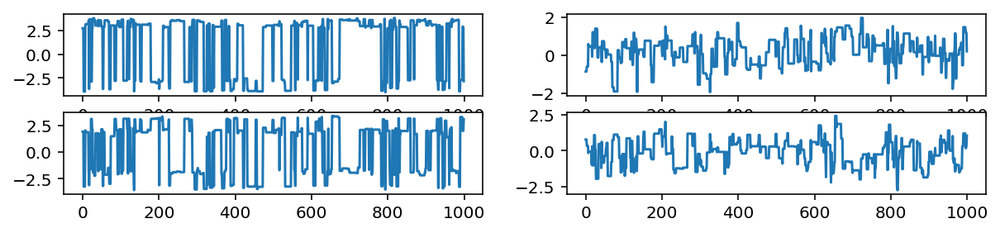

Removed no burn in
422.65484714008784
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           1.11E+01           11.12             450
param2           1.02E+01           10.20             490


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1430  p_{1}
param2        0.0387  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00141
  2      0.02044

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0060   0.0055   0.0053 upper
param1       0.0069   0.0062   0.0155 lower
param2       0.0070   0.0108   0.0077 upper
param2       0.0047   0.0078   0.0095 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1         

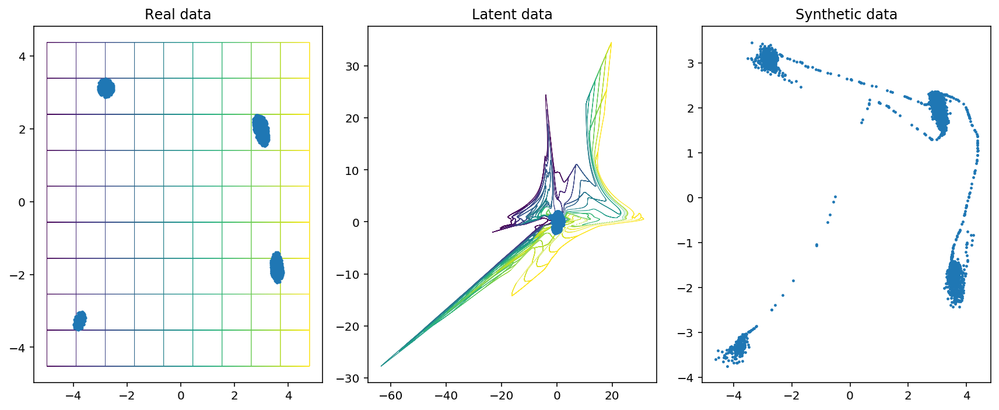

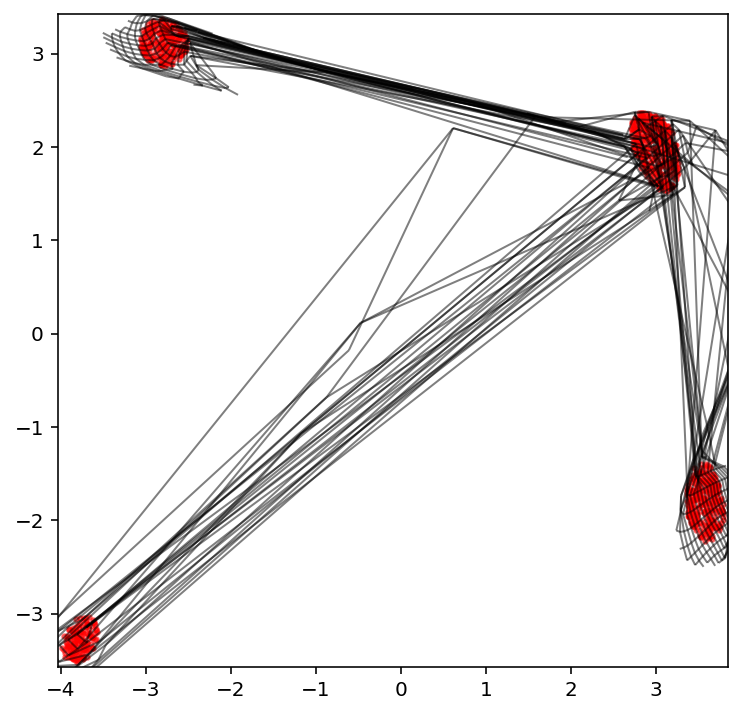

Creating directory for new run logs/test/run27
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


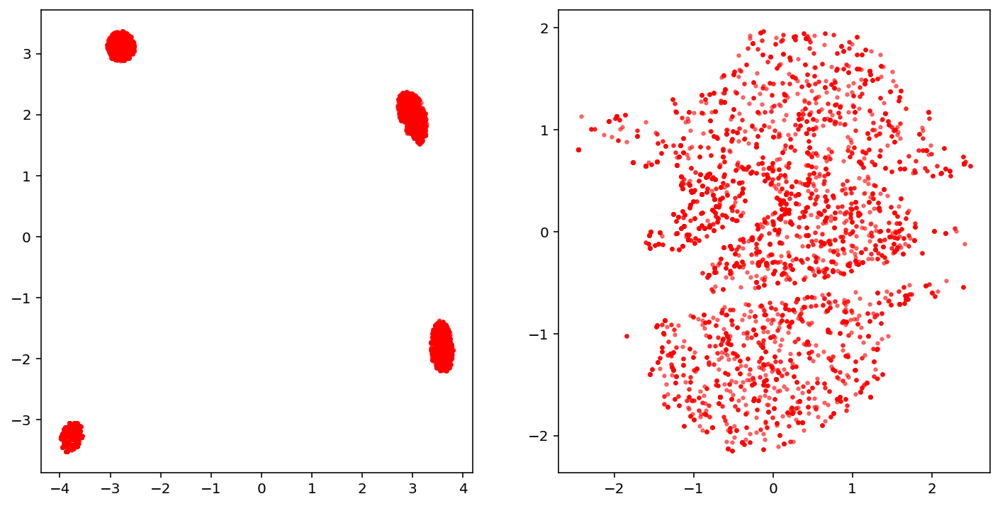

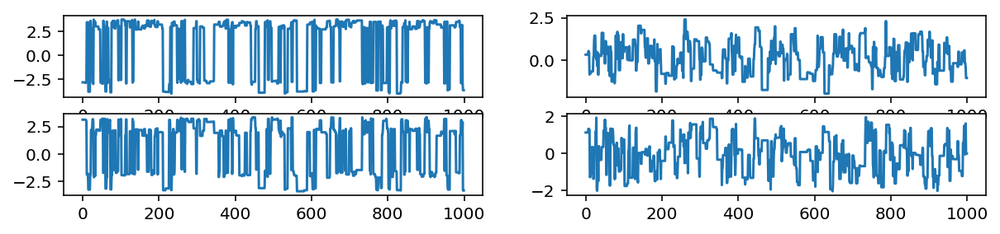

Removed no burn in
542.2925305948071
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           9.16E+00            9.16             546
param2           1.08E+01           10.83             462


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0843  p_{1}
param2        0.0633  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00287
  2      0.00831

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0015   0.0046   0.0064 upper
param1       0.0050   0.0069   0.0071 lower
param2       0.0008   0.0012   0.0023 upper
param2       0.0014   0.0213   0.0187 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

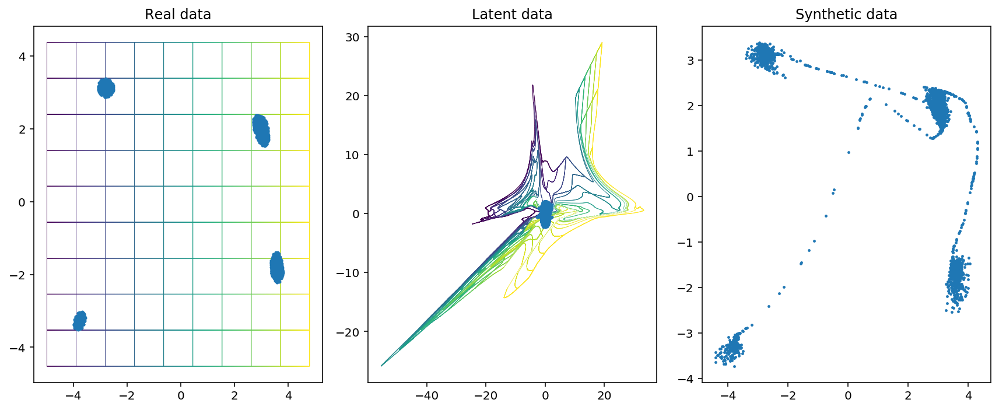

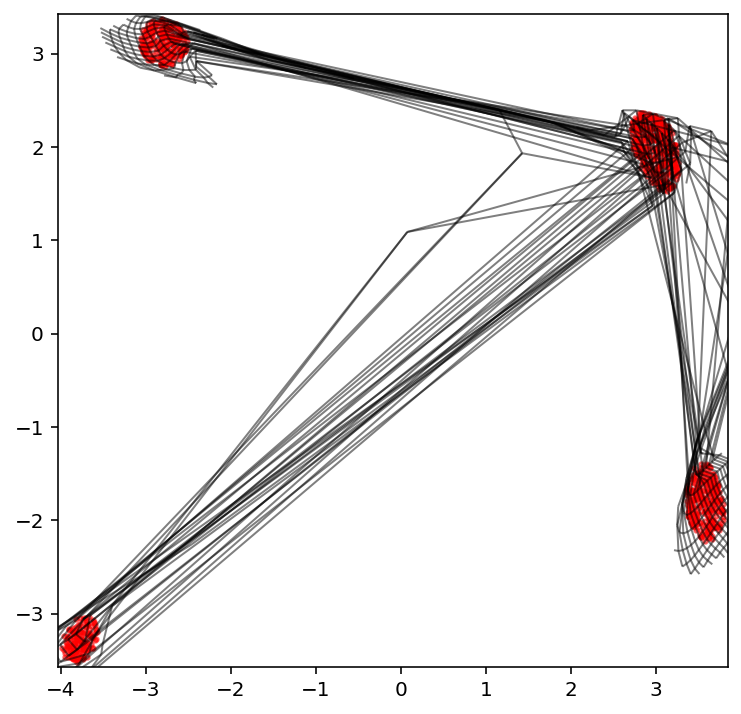

Creating directory for new run logs/test/run28
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


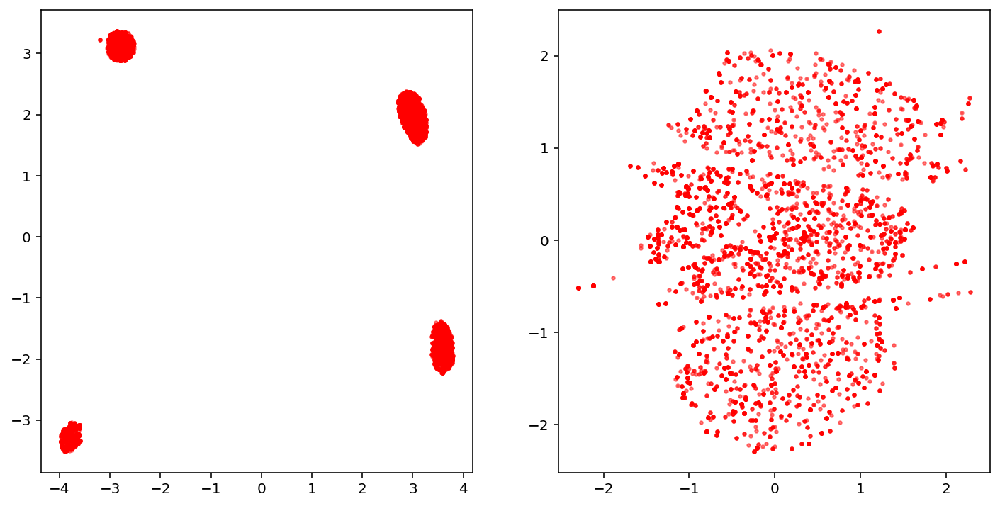

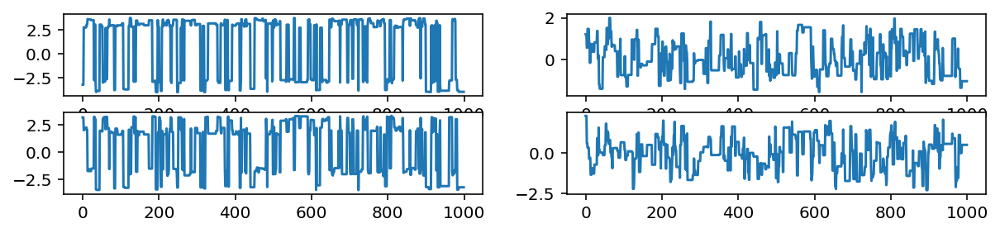

Removed no burn in
495.17379546484165
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           1.02E+01           10.18             491
param2           9.24E+00            9.24             541


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0848  p_{1}
param2        0.0602  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00361
  2      0.00719

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0026   0.0040   0.0026 upper
param1       0.0053   0.0065   0.0086 lower
param2       0.0099   0.0125   0.0098 upper
param2       0.0002   0.0178   0.0166 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1         

In [15]:
model = Trainer(like.x_dim, hidden_dim=64, num_blocks=5, flow='nvp', learning_rate=0.001)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

[nnest.trainer] [INFO] SingleSpeedSpline(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): ActNorm()
      (1): Invertible1x1Conv()
      (2): NSF_CL(
        (f1): MLP(
          (net): Sequential(
            (0): Linear(in_features=1, out_features=16, bias=True)
            (1): LeakyReLU(negative_slope=0.2)
            (2): Linear(in_features=16, out_features=16, bias=True)
            (3): LeakyReLU(negative_slope=0.2)
            (4): Linear(in_features=16, out_features=16, bias=True)
            (5): LeakyReLU(negative_slope=0.2)
            (6): Linear(in_features=16, out_features=23, bias=True)
          )
        )
        (f2): MLP(
          (net): Sequential(
            (0): Linear(in_features=1, out_features=16, bias=True)
            (1): LeakyReLU(negative_slope=0.2)
            (2): Linear(in_features=16, out_features=16, bias=True)
            (3): LeakyReLU(negative_slope=0.2)
            (4): Linear(in_features=16, out_features=16, bias=True)
        

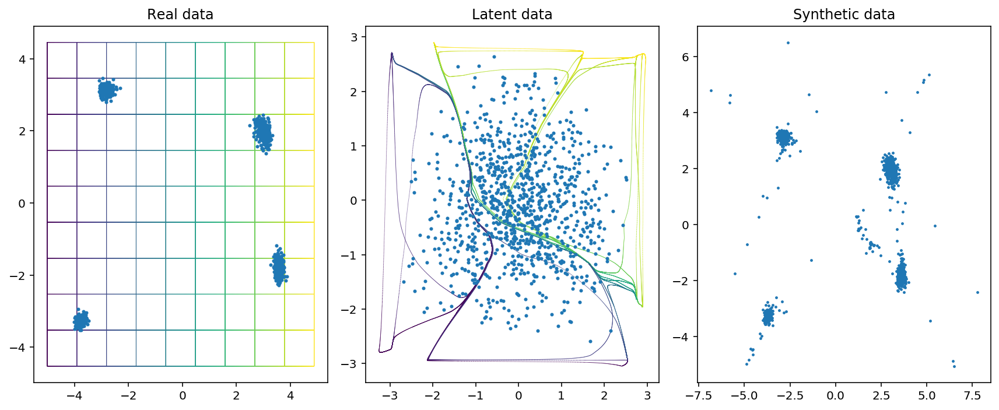

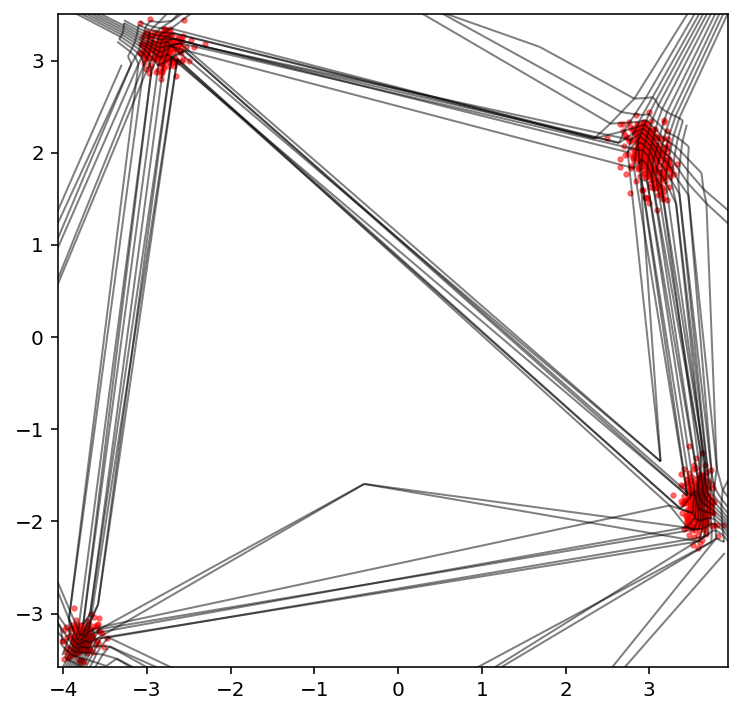

Creating directory for new run logs/test/run29
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


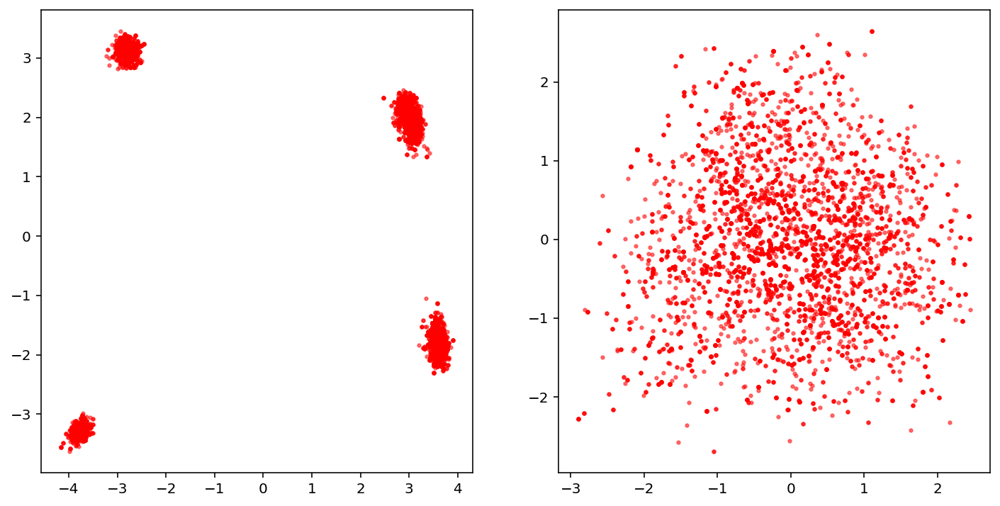

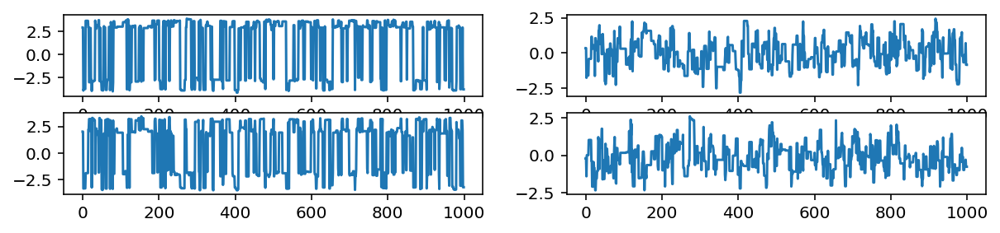

Removed no burn in
704.3574022425785
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.92E+00            6.92             723
param2           6.04E+00            6.04             828


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0838  p_{1}
param2        0.1483  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00173
  2      0.02783

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0036   0.0048   0.0063 upper
param1       0.0006   0.0051   0.0077 lower
param2       0.0034   0.0057   0.0052 upper
param2       0.0020   0.0091   0.0076 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

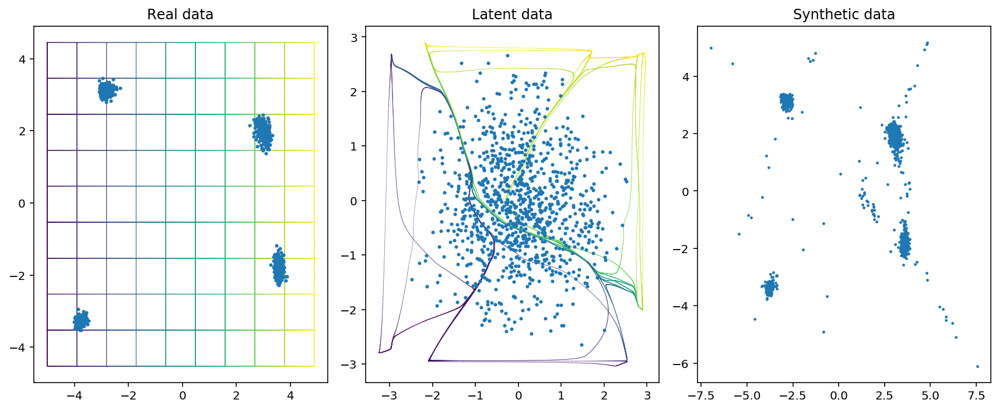

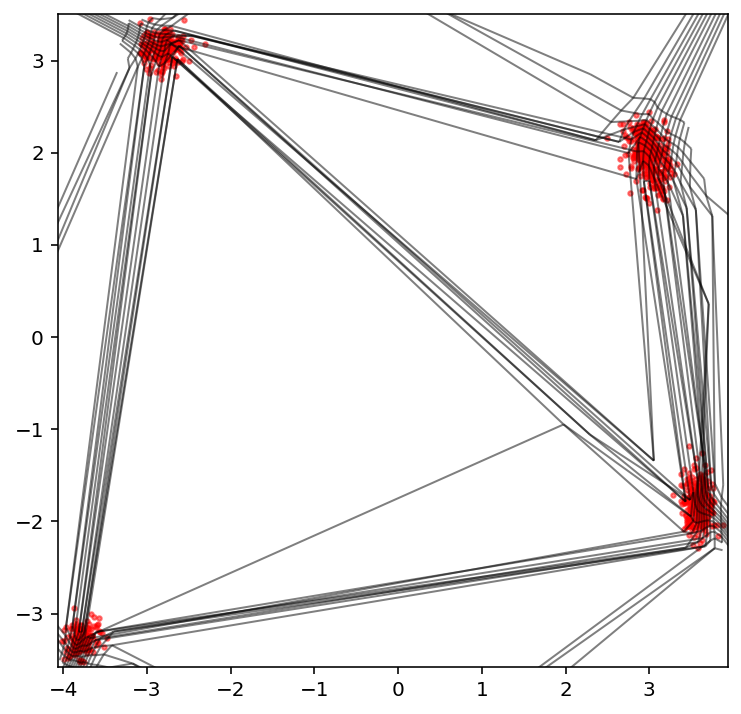

Creating directory for new run logs/test/run30
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


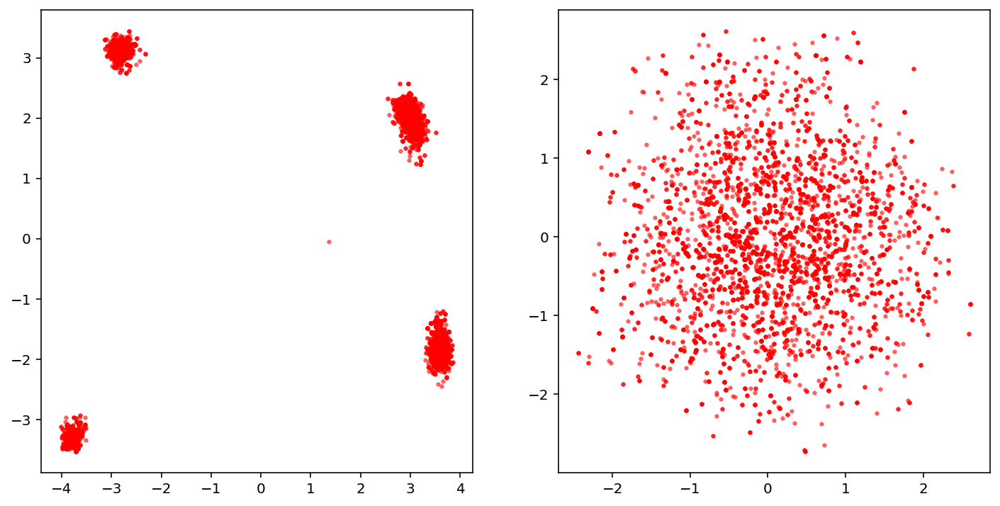

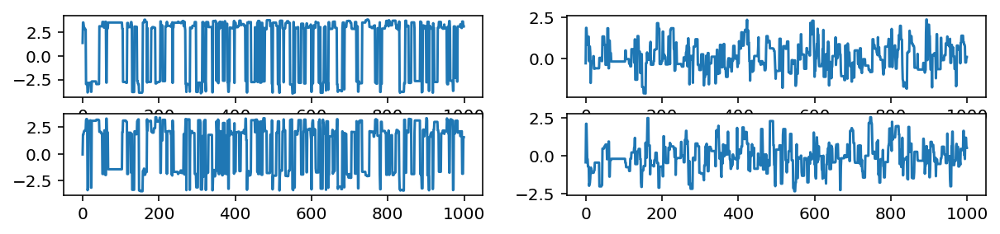

Removed no burn in
769.196049171471
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.34E+00            6.34             789
param2           5.93E+00            5.93             843


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0729  p_{1}
param2        0.0709  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00483
  2      0.00553

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0039   0.0032   0.0056 upper
param1       0.0041   0.0053   0.0077 lower
param2       0.0057   0.0029   0.0060 upper
param2       0.0038   0.0104   0.0140 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1           

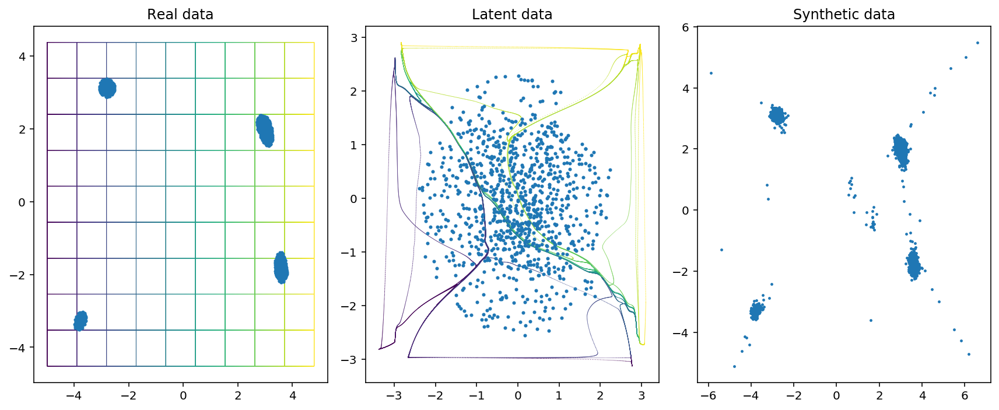

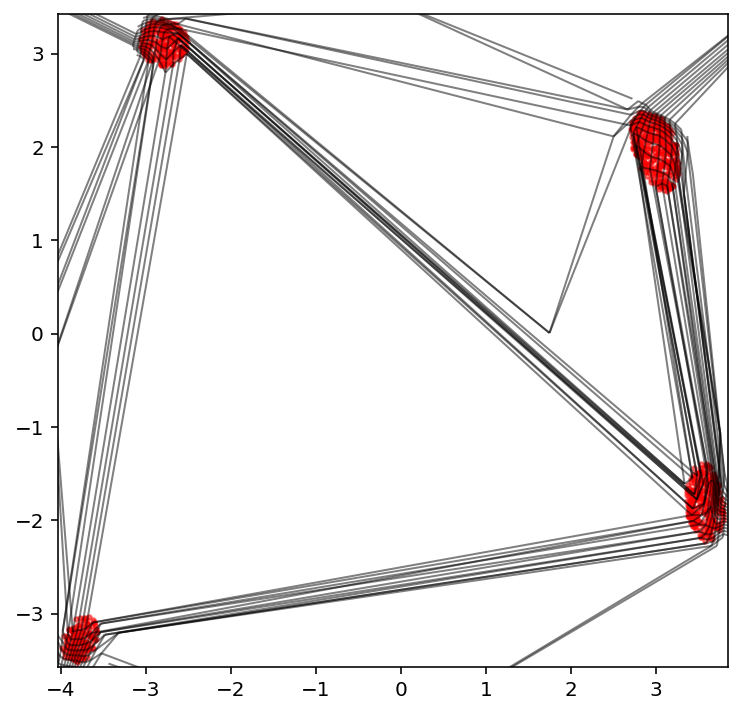

Creating directory for new run logs/test/run31
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


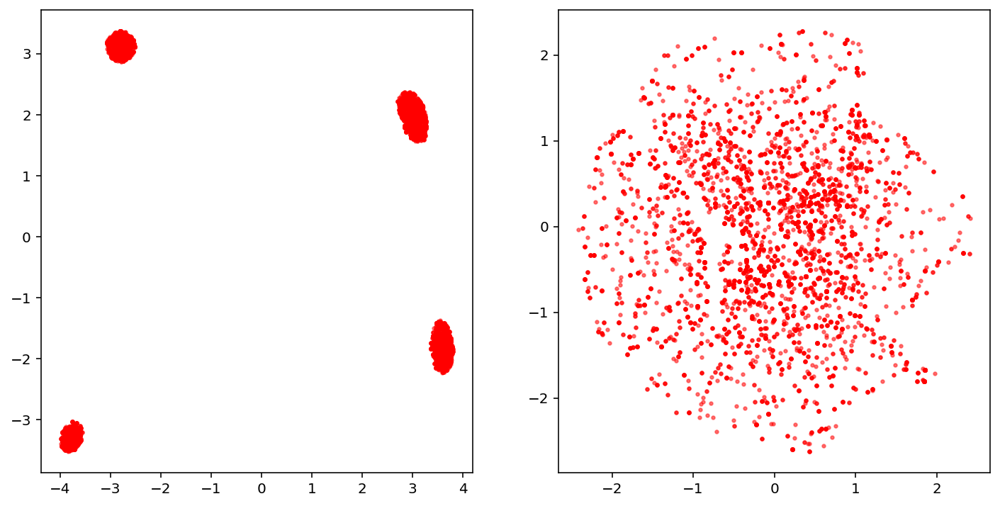

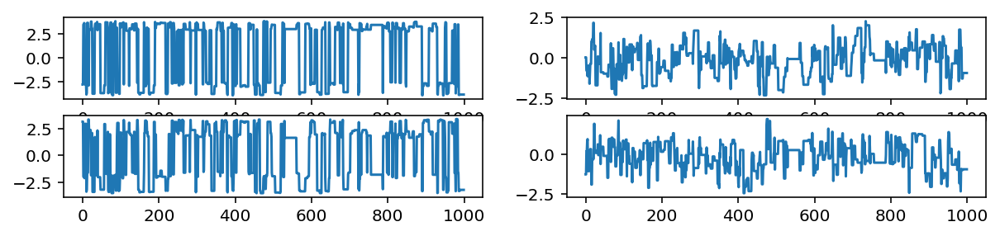

Removed no burn in
652.3132061585917
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.71E+00            7.71             648
param2           7.56E+00            7.56             661


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0498  p_{1}
param2        0.1079  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00200
  2      0.01212

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0080   0.0067   0.0119 upper
param1       0.0021   0.0029   0.0071 lower
param2       0.0031   0.0141   0.0086 upper
param2       0.0064   0.0052   0.0119 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

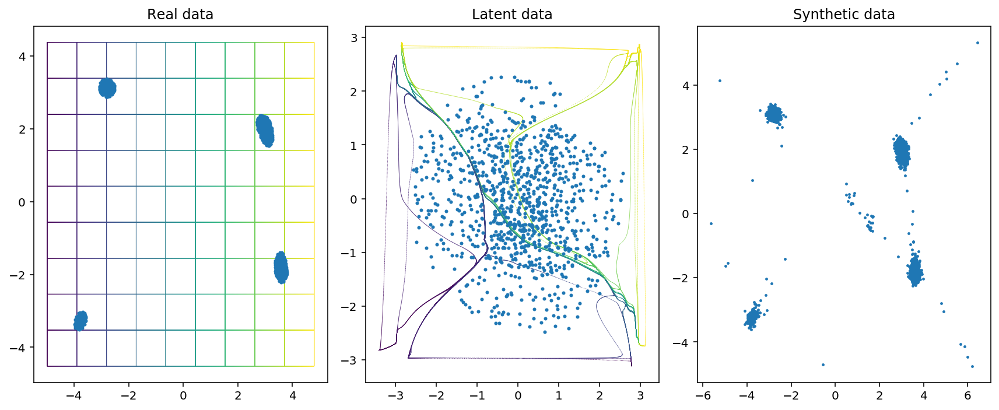

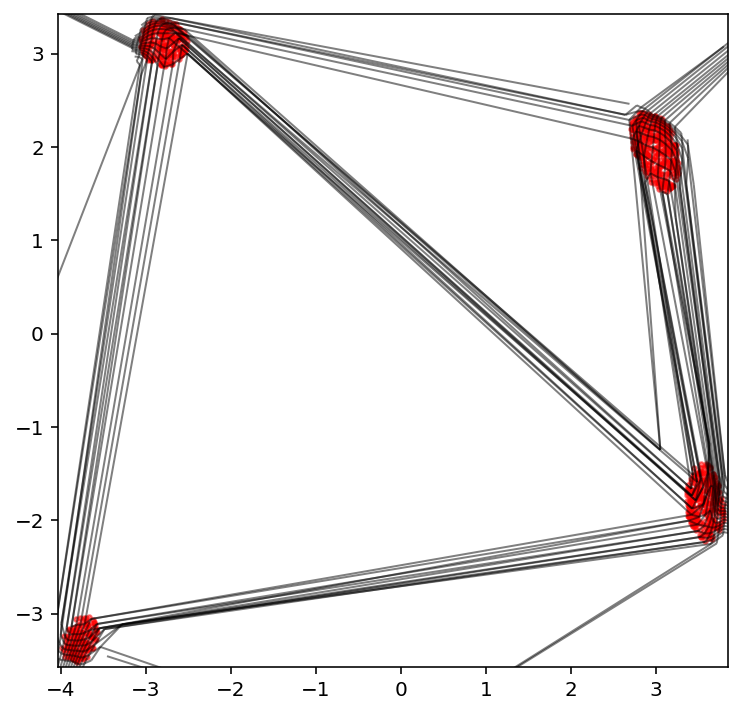

Creating directory for new run logs/test/run32
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


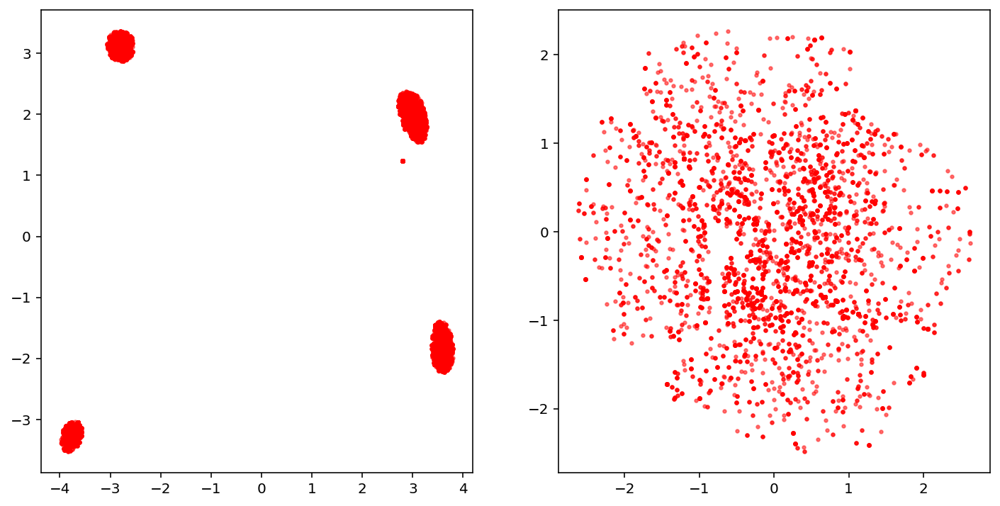

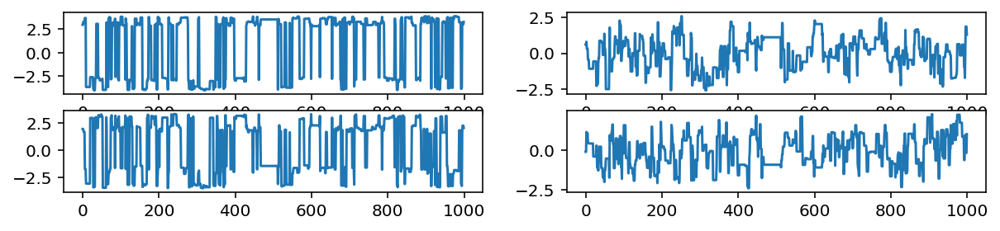

Removed no burn in
635.1698493632543
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.54E+00            7.54             663
param2           7.97E+00            7.97             628


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1075  p_{1}
param2        0.0961  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00816
  2      0.01273

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0043   0.0035   0.0081 upper
param1       0.0013   0.0040   0.0053 lower
param2       0.0036   0.0043   0.0102 upper
param2       0.0008   0.0063   0.0092 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

In [16]:
model = Trainer(like.x_dim, flow='spline', learning_rate=0.001)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

In [17]:
like = Rosenbrock(2)
prior = UniformPrior(2, -2, 12)

[nnest.trainer] [INFO] SingleSpeedCholeksy(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): Choleksy()
    )
  )
)
[nnest.trainer] [INFO] Number of network params: [5]
[nnest.trainer] [INFO] Device [cpu]
[nnest.trainer] [INFO] Number of training samples [1000]
[nnest.trainer] [INFO] Training jitter [0.0010]
[nnest.trainer] [INFO] Epoch [1] train loss [0.0502] validation loss [0.0384]
[nnest.trainer] [INFO] Epoch [100] train loss [0.0277] validation loss [0.0255]
[nnest.trainer] [INFO] Epoch [200] train loss [0.0251] validation loss [0.0238]
[nnest.trainer] [INFO] Epoch [300] train loss [0.0236] validation loss [0.0228]
[nnest.trainer] [INFO] Epoch [400] train loss [0.0225] validation loss [0.0221]
[nnest.trainer] [INFO] Epoch [500] train loss [0.0218] validation loss [0.0218]
[nnest.trainer] [INFO] Epoch [594] ran out of patience
[nnest.trainer] [INFO] Best epoch [544] validation loss [0.0218]


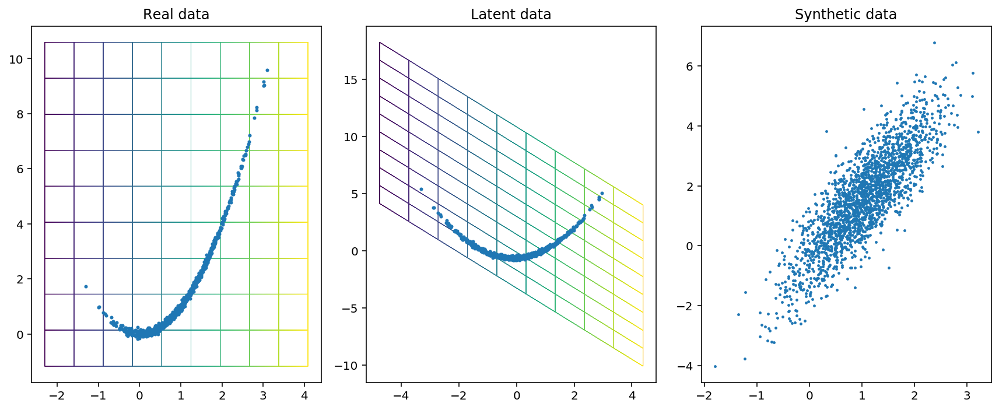

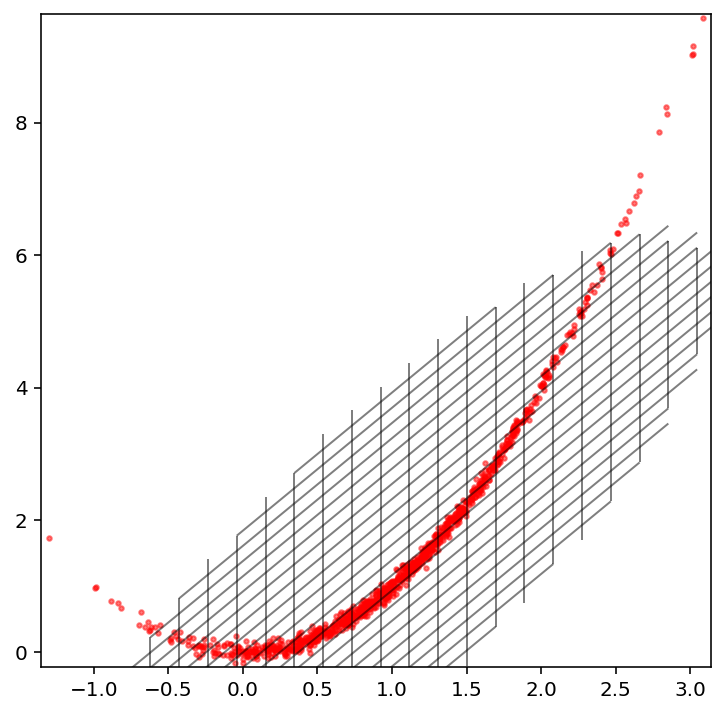

Creating directory for new run logs/test/run33
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


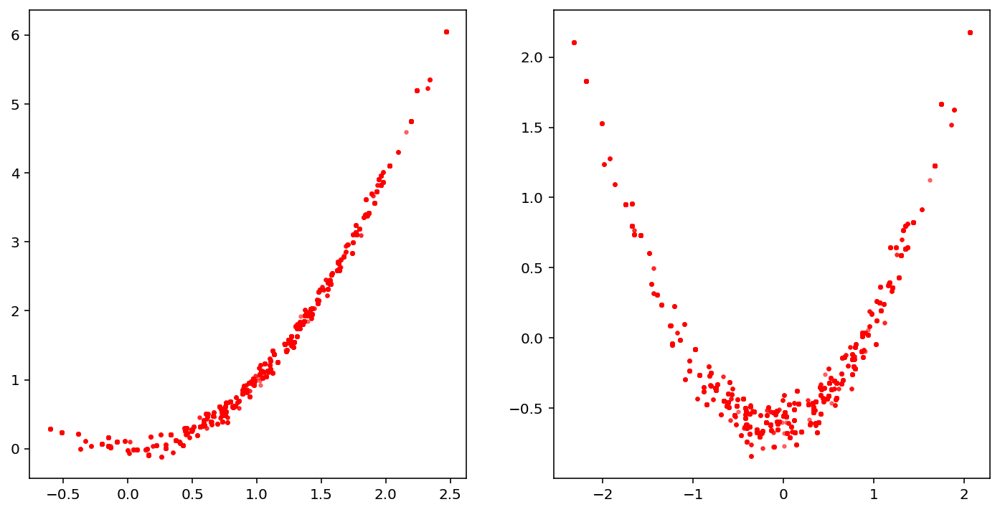

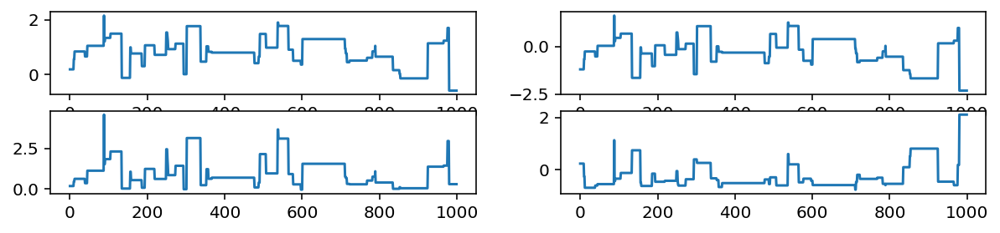

Removed no burn in
71.97223284254154
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           9.52E-01            0.95            5256
param2           5.83E+01           58.26              85


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.2506  p_{1}
param2        0.2609  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.04887
  2      0.06871

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0544   0.3378   0.3234 upper
param1       0.3581   0.2959   0.3412 lower
param2       0.2466   0.7082   0.6545 upper
param2       0.0113   0.0096   0.0217 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enoug

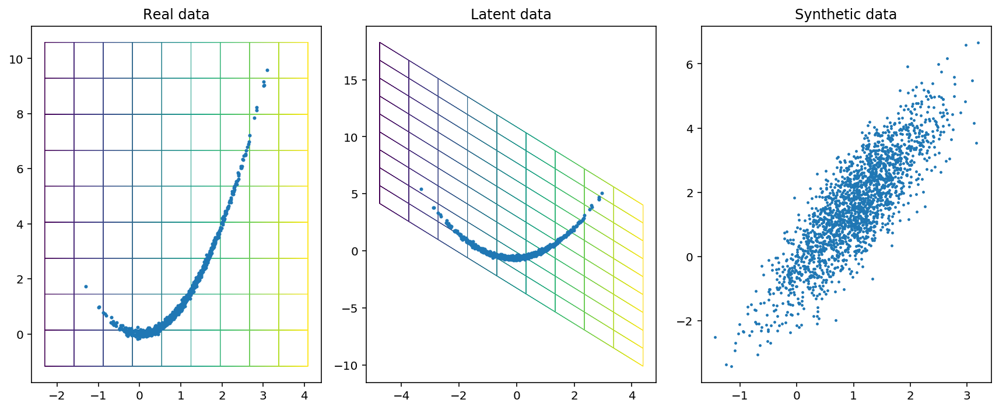

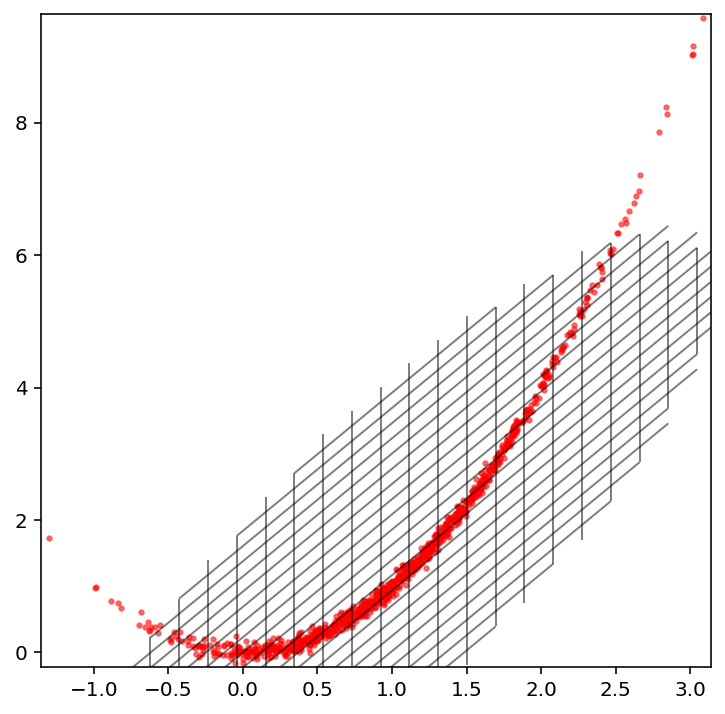

Creating directory for new run logs/test/run34
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


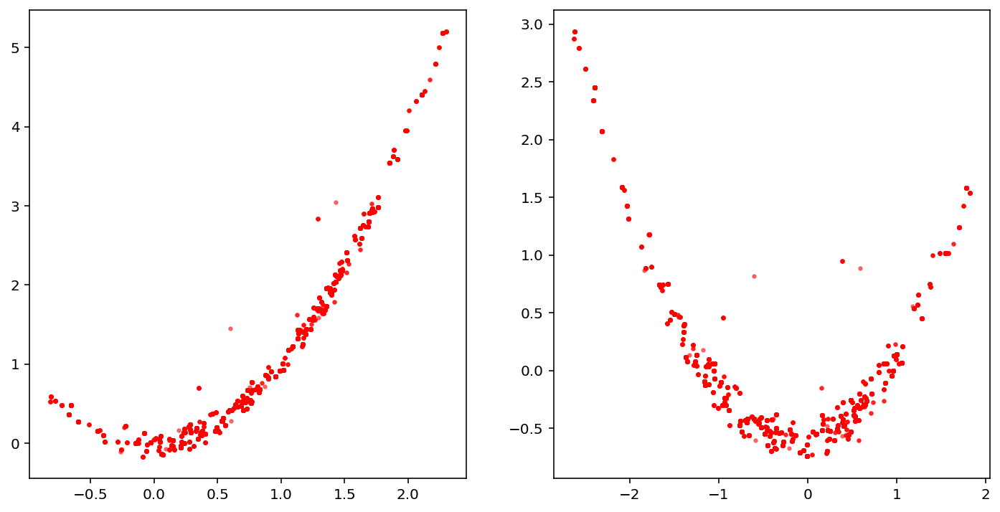

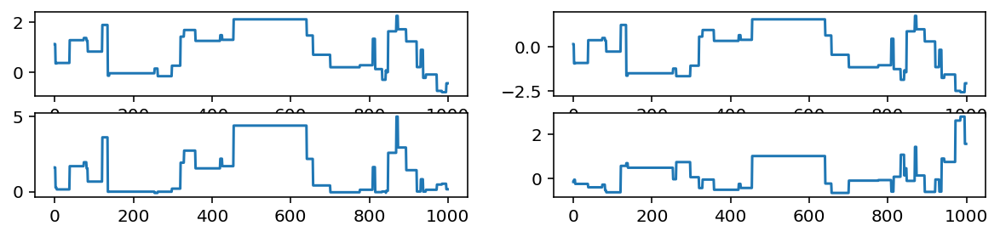

Removed no burn in
75.23558742567434
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           9.67E-01            0.97            5175
param2           9.69E-01            0.97            5165


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.2061  p_{1}
param2        0.2004  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.03758
  2      0.10727

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.2578   0.2776   0.3294 upper
param1       0.0161   0.6908   0.3065 lower
param2       0.4945   0.5201   0.7321 upper
param2       0.0499   0.0524   0.0484 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

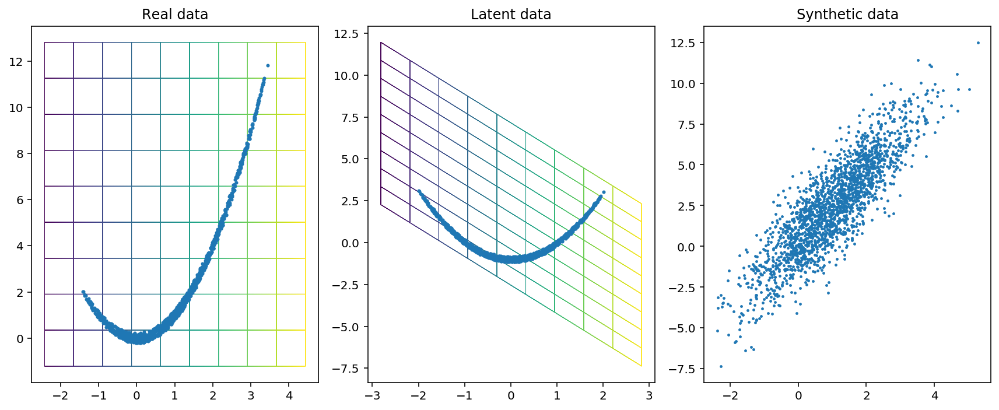

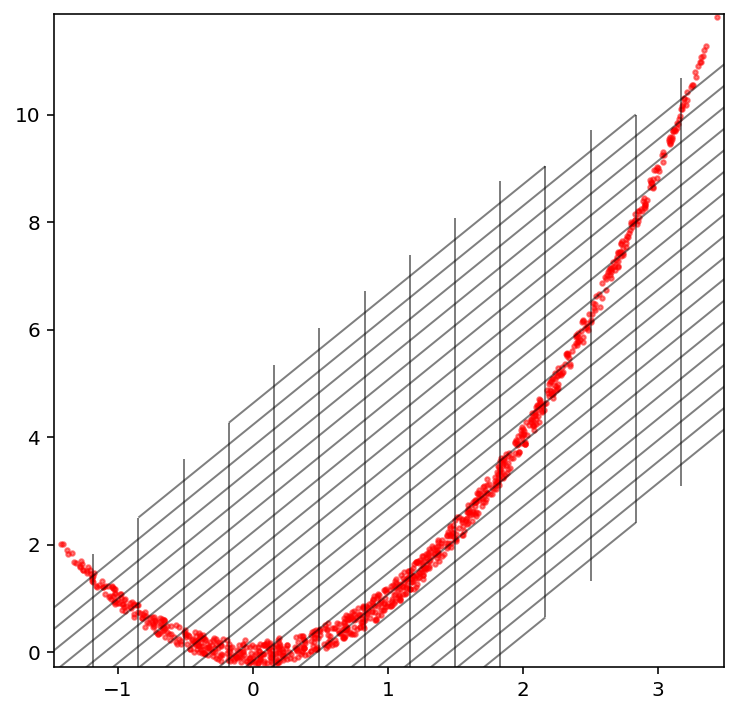

Creating directory for new run logs/test/run35
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


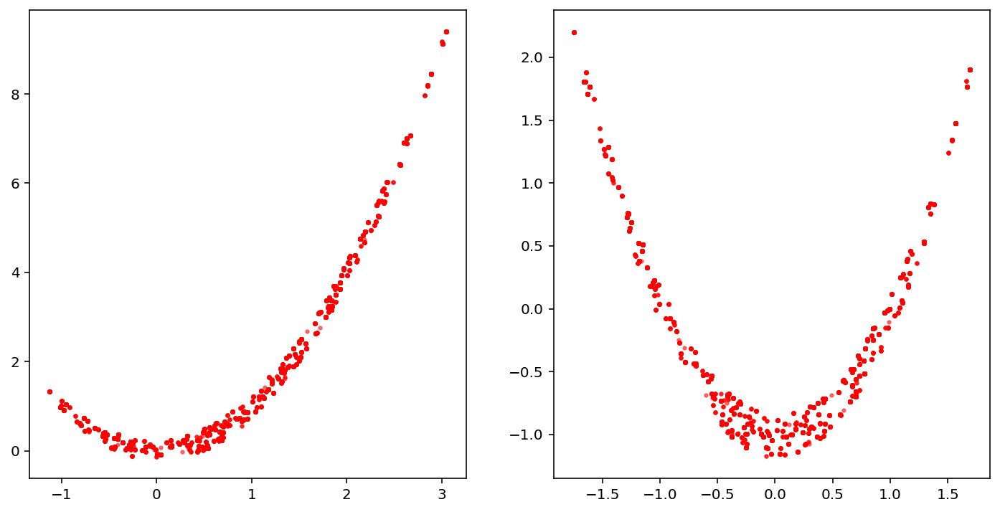

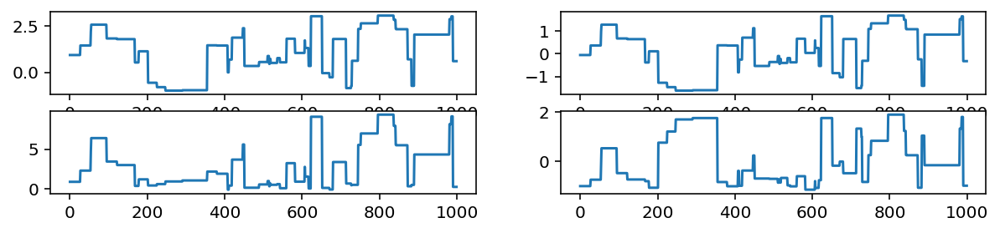

Removed no burn in
76.89659790173103
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.29E+01           62.92              79
param2           4.87E+01           48.73             102


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1860  p_{1}
param2        0.1799  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.02676
  2      0.13087

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.1998   0.3000   0.2939 upper
param1       0.1082   0.2407   0.1989 lower
param2       0.5078   0.7508   0.7402 upper
param2       0.0042   0.0268   0.0259 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enoug

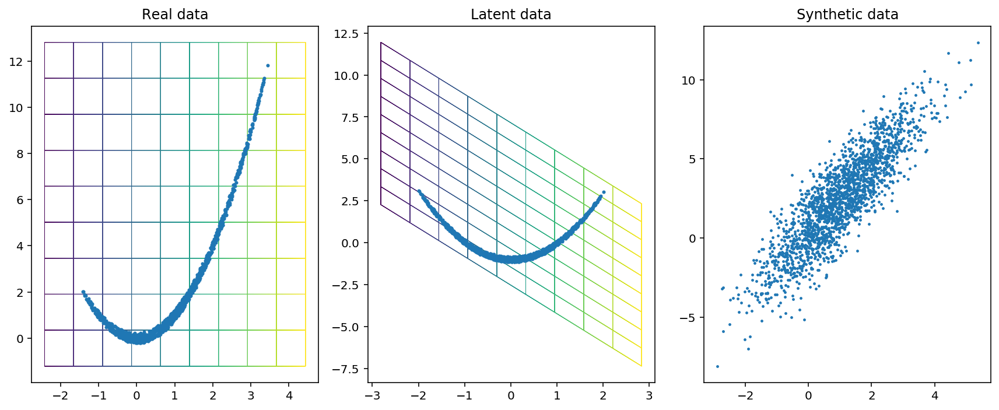

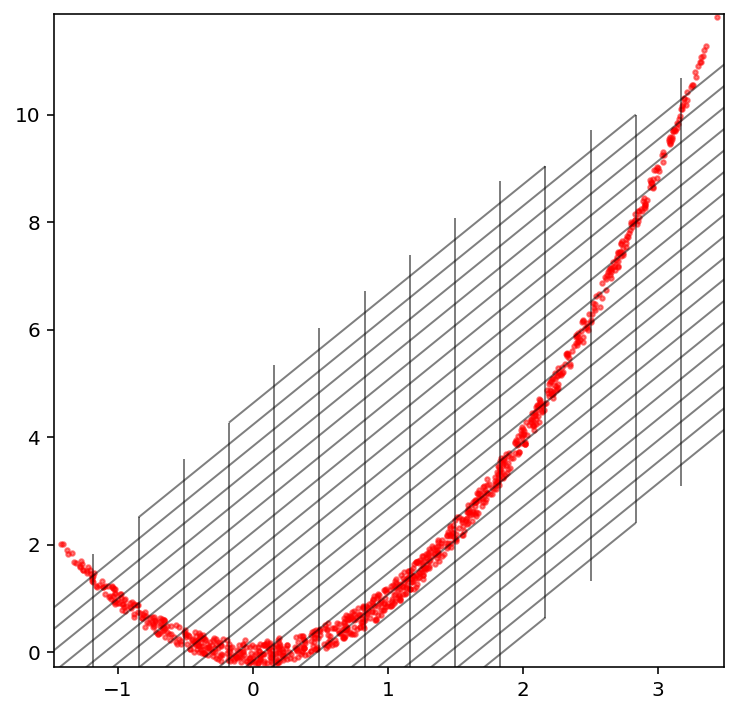

Creating directory for new run logs/test/run36
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


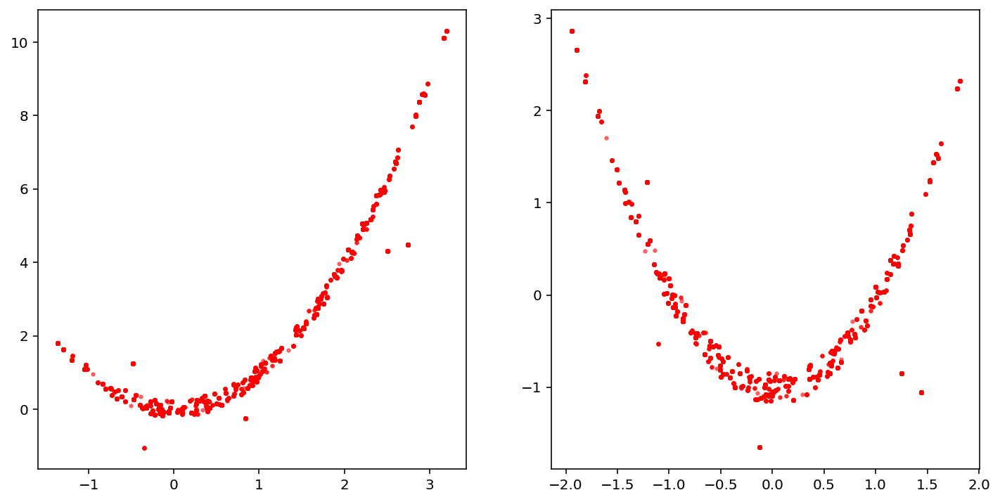

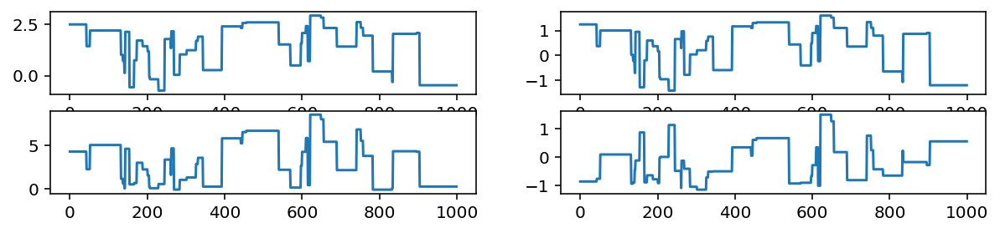

Removed no burn in
41.20748848665249
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           9.34E-01            0.93            5360
param2           9.64E-01            0.96            5193


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.2981  p_{1}
param2        0.2167  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.04391
  2      0.13267

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.1380   0.1378   0.1676 upper
param1       0.0656   0.0535   0.3321 lower
param2       0.4504   0.5176   0.4790 upper
param2       0.0140   0.0137   0.0148 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enoug

In [18]:
model = Trainer(like.x_dim, flow='choleksy', learning_rate=0.001)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

[nnest.trainer] [INFO] SingleSpeedNVP(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): CouplingLayer(
        (scale_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
          (1): Tanh()
          (2): Linear(in_features=64, out_features=64, bias=True)
          (3): Tanh()
          (4): Linear(in_features=64, out_features=64, bias=True)
          (5): Tanh()
          (6): Linear(in_features=64, out_features=2, bias=True)
        )
        (translate_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
          (1): ReLU()
          (2): Linear(in_features=64, out_features=64, bias=True)
          (3): ReLU()
          (4): Linear(in_features=64, out_features=64, bias=True)
          (5): ReLU()
          (6): Linear(in_features=64, out_features=2, bias=True)
        )
      )
      (1): CouplingLayer(
        (scale_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
     

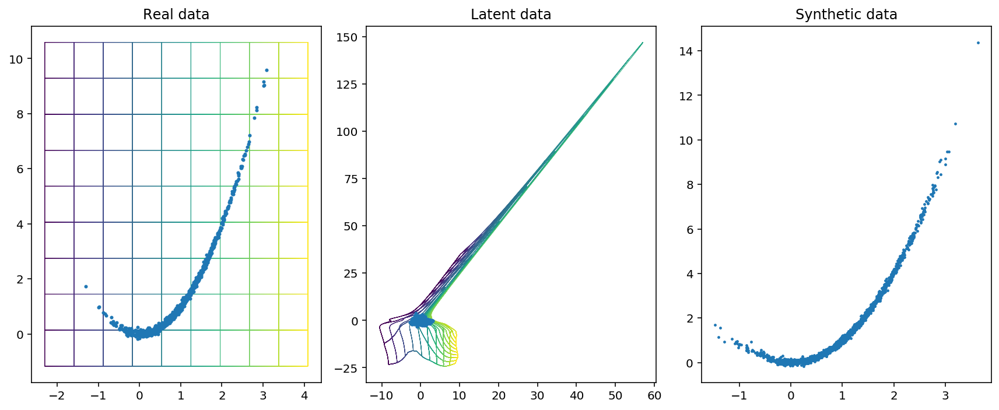

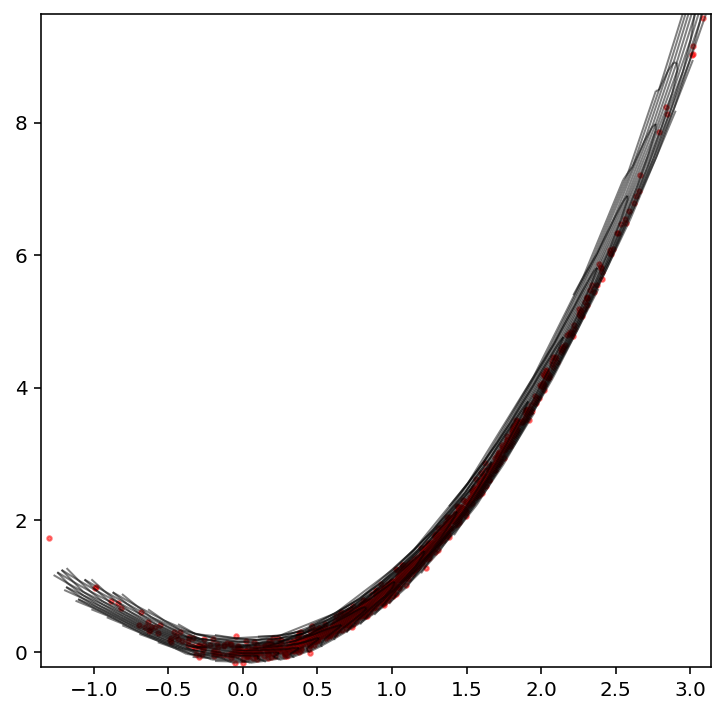

Creating directory for new run logs/test/run37
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


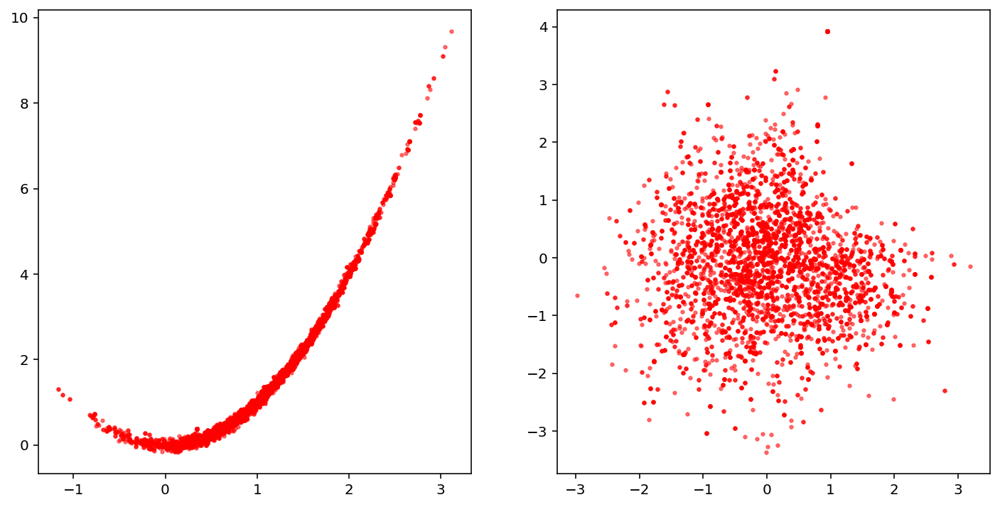

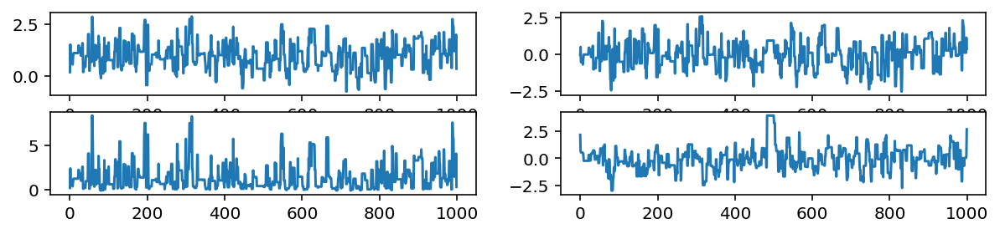

Removed no burn in
668.1979602048964
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.35E+00            7.35             680
param2           7.99E+00            7.99             626


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0490  p_{1}
param2        0.0449  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00086
  2      0.00243

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.1225   0.1058   0.1912 upper
param1       0.0842   0.1130   0.1168 lower
param2       0.2636   0.2560   0.3869 upper
param2       0.0055   0.0111   0.0118 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

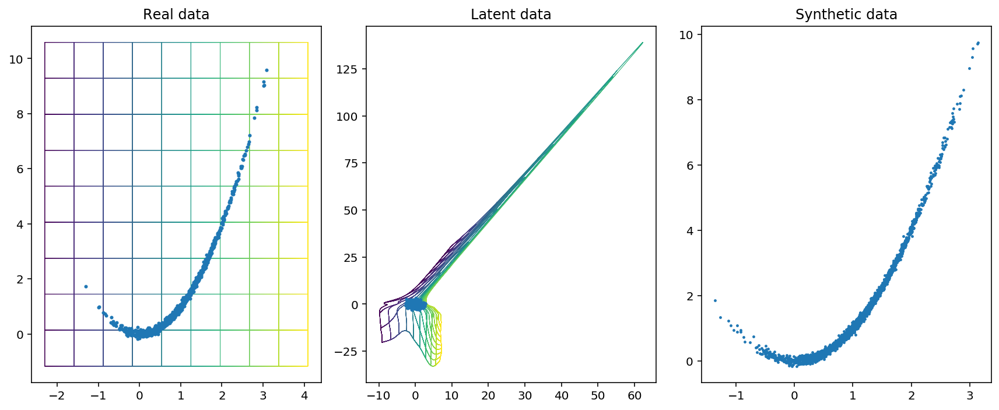

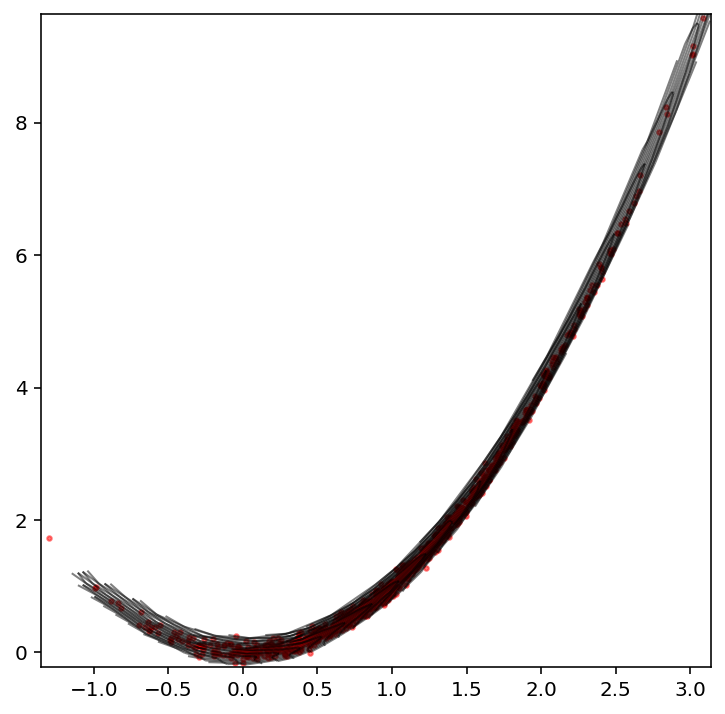

Creating directory for new run logs/test/run38
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


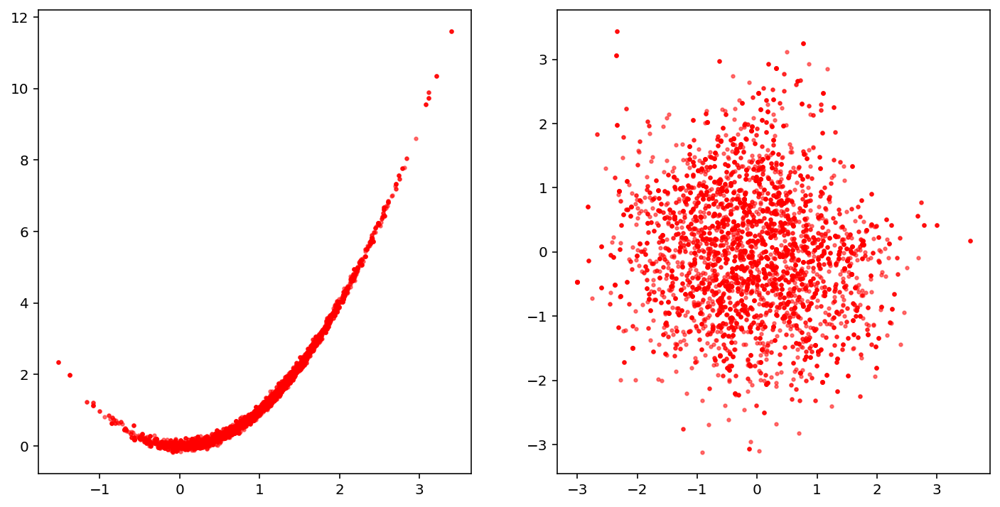

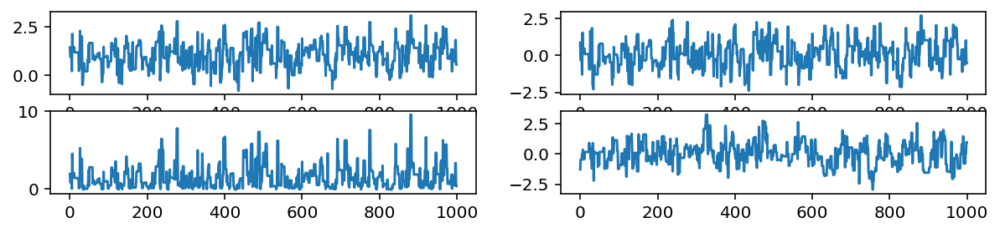

Removed no burn in
639.8376837221529
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.25E+00            7.25             690
param2           5.69E+00            5.69             880


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1551  p_{1}
param2        0.1201  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00055
  2      0.02548

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.1022   0.0914   0.1947 upper
param1       0.0912   0.0441   0.1840 lower
param2       0.2210   0.1983   0.4052 upper
param2       0.0003   0.0027   0.0054 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

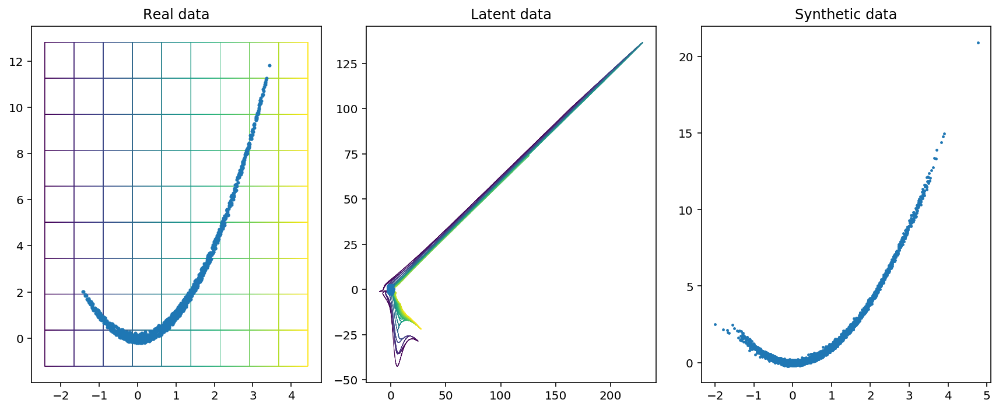

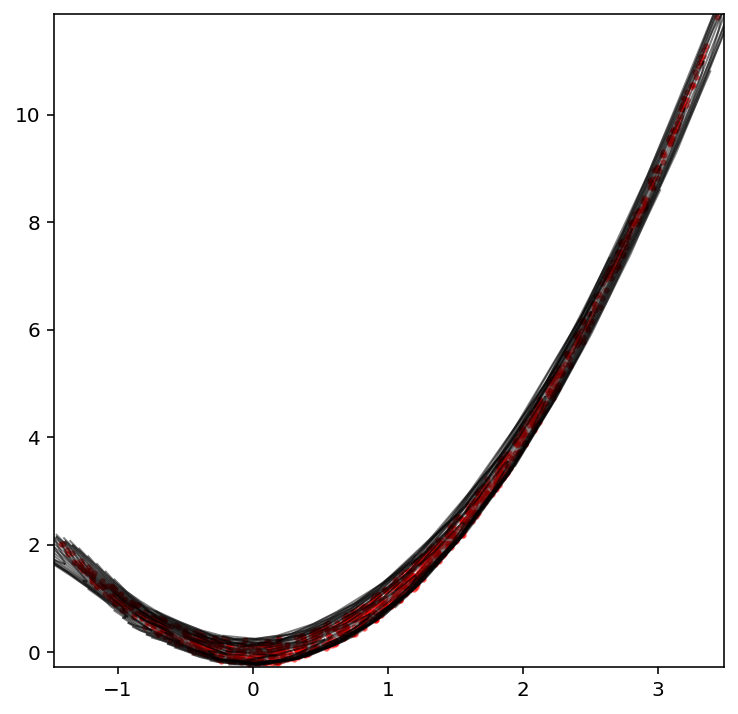

Creating directory for new run logs/test/run39
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


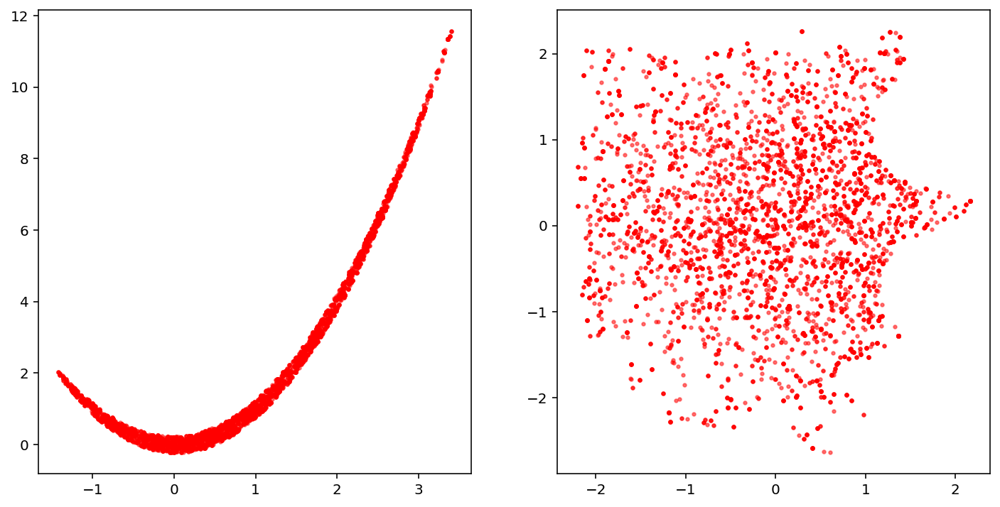

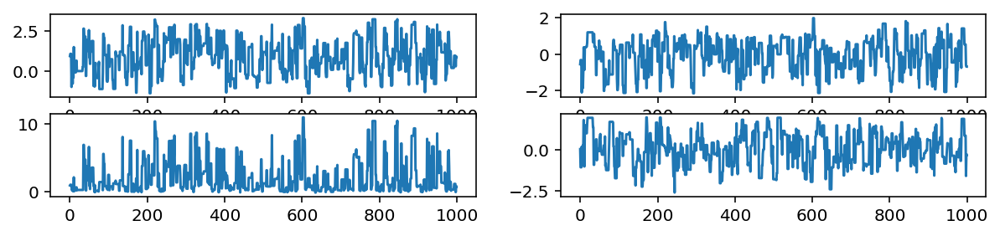

Removed no burn in
656.2055484077526
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.61E+00            7.61             657
param2           6.91E+00            6.91             724


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0495  p_{1}
param2        0.0581  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00235
  2      0.00808

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0020   0.0337   0.0299 upper
param1       0.0389   0.0585   0.0474 lower
param2       0.0153   0.0866   0.0592 upper
param2       0.0010   0.0057   0.0048 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

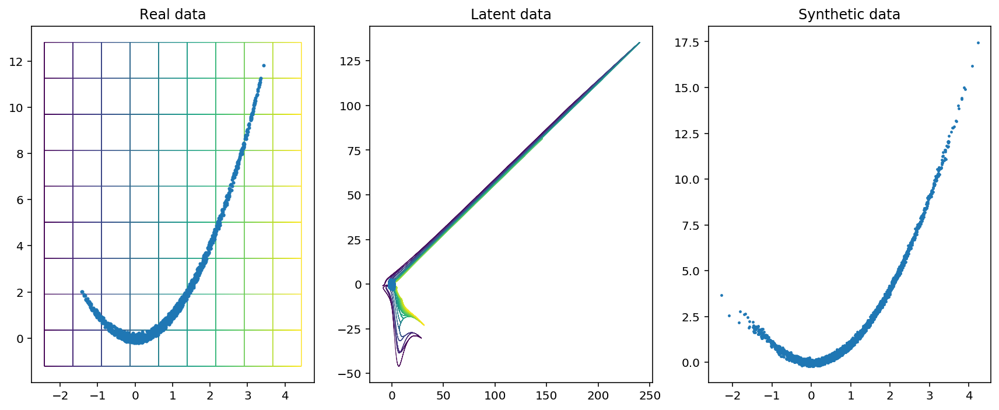

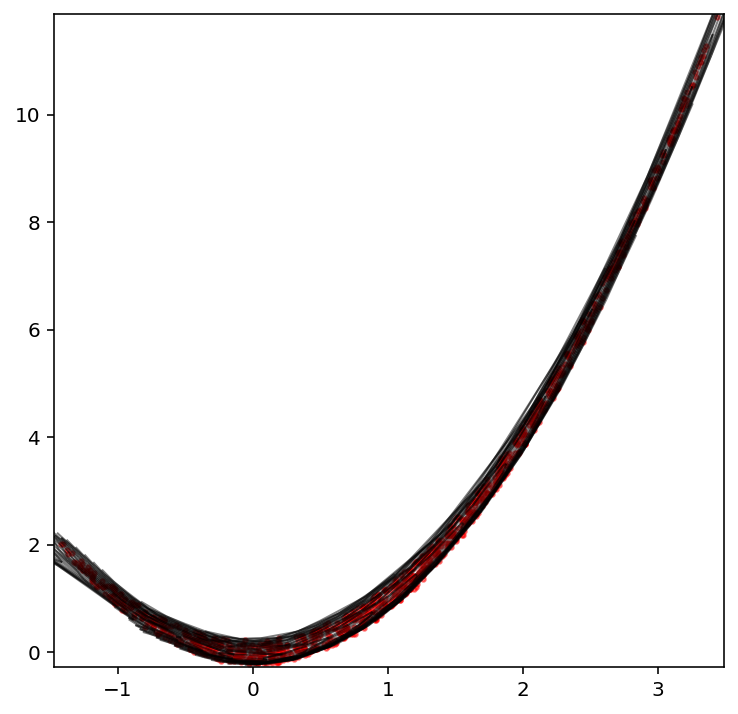

Creating directory for new run logs/test/run40
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


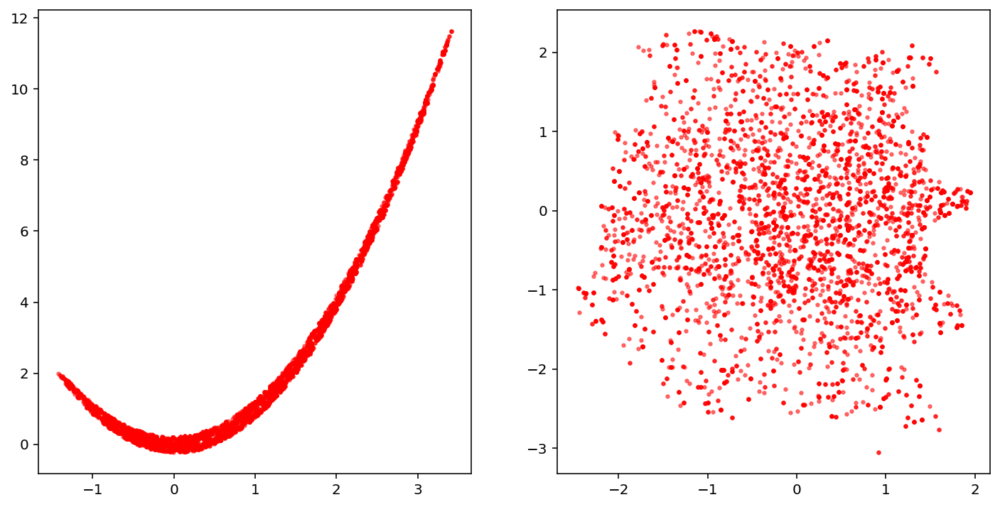

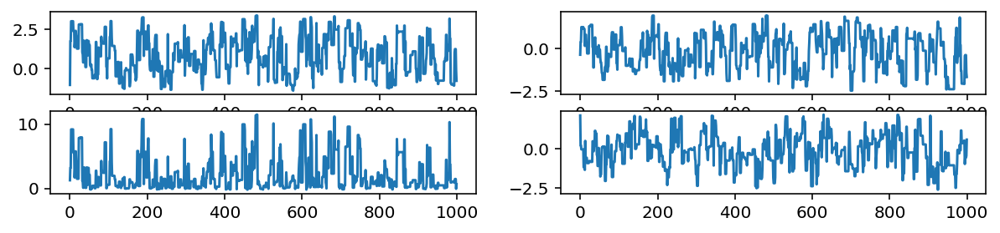

Removed no burn in
637.2371928984381
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.66E+00            7.66             653
param2           7.29E+00            7.29             686


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0889  p_{1}
param2        0.0820  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00517
  2      0.00802

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0128   0.0531   0.0595 upper
param1       0.0472   0.0577   0.0675 lower
param2       0.0301   0.1388   0.1657 upper
param2       0.0021   0.0025   0.0060 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

In [19]:
model = Trainer(like.x_dim, hidden_dim=64, num_blocks=5, flow='nvp', learning_rate=0.001)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

[nnest.trainer] [INFO] SingleSpeedSpline(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): ActNorm()
      (1): Invertible1x1Conv()
      (2): NSF_CL(
        (f1): MLP(
          (net): Sequential(
            (0): Linear(in_features=1, out_features=16, bias=True)
            (1): LeakyReLU(negative_slope=0.2)
            (2): Linear(in_features=16, out_features=16, bias=True)
            (3): LeakyReLU(negative_slope=0.2)
            (4): Linear(in_features=16, out_features=16, bias=True)
            (5): LeakyReLU(negative_slope=0.2)
            (6): Linear(in_features=16, out_features=23, bias=True)
          )
        )
        (f2): MLP(
          (net): Sequential(
            (0): Linear(in_features=1, out_features=16, bias=True)
            (1): LeakyReLU(negative_slope=0.2)
            (2): Linear(in_features=16, out_features=16, bias=True)
            (3): LeakyReLU(negative_slope=0.2)
            (4): Linear(in_features=16, out_features=16, bias=True)
        

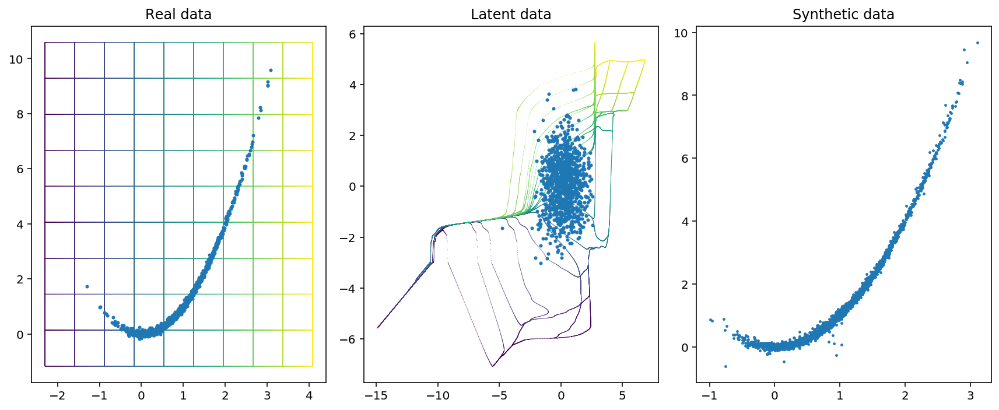

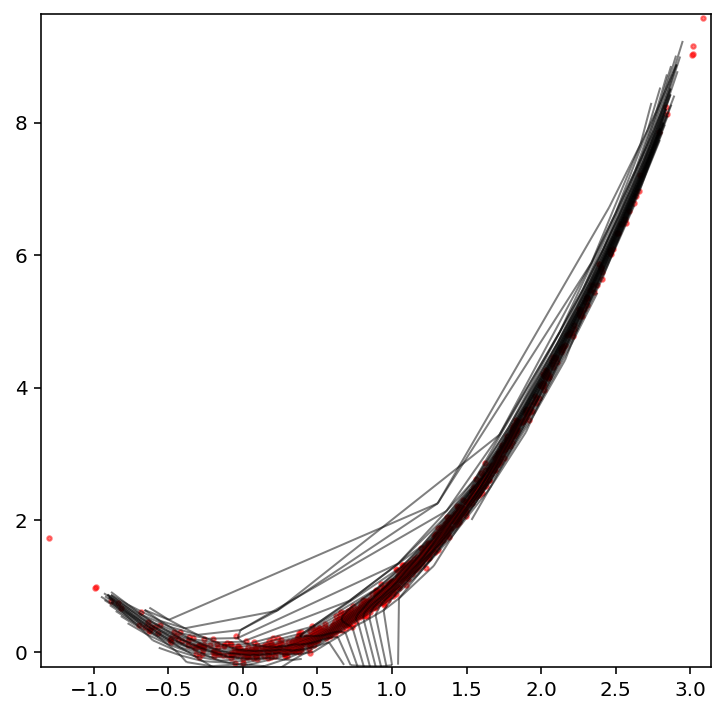

Creating directory for new run logs/test/run41
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


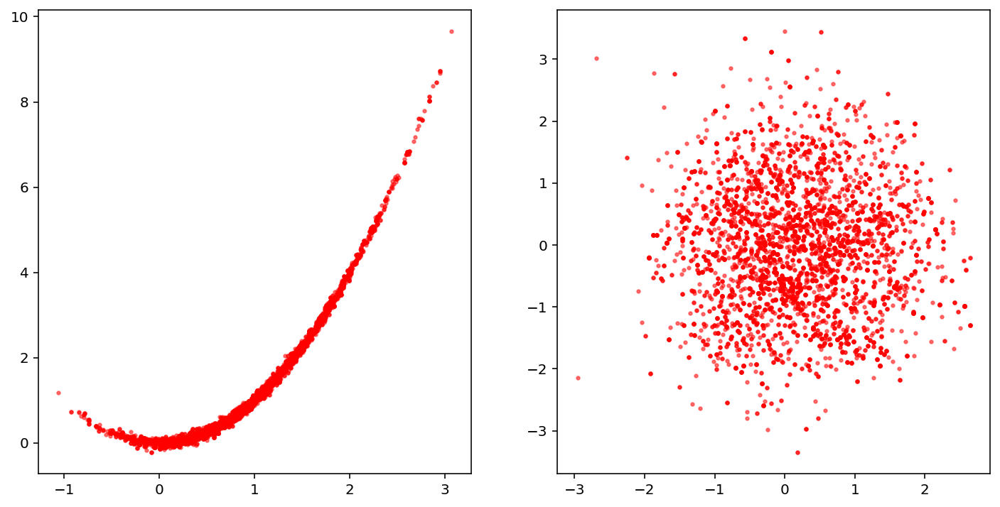

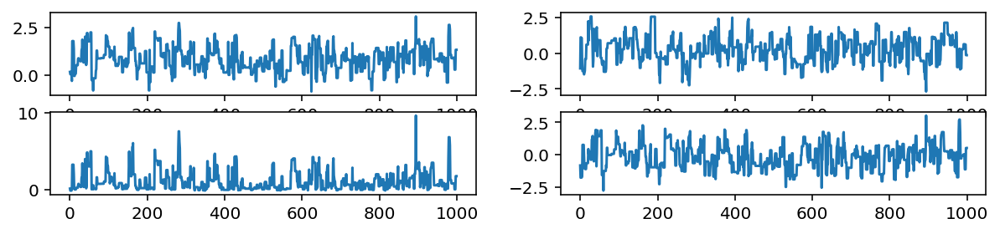

Removed no burn in
672.7882848287687
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.17E+00            7.17             697
param2           7.29E+00            7.29             686


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1057  p_{1}
param2        0.1171  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00544
  2      0.01402

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.1484   0.1920   0.1685 upper
param1       0.0287   0.0216   0.0760 lower
param2       0.2896   0.3779   0.3321 upper
param2       0.0072   0.0058   0.0146 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

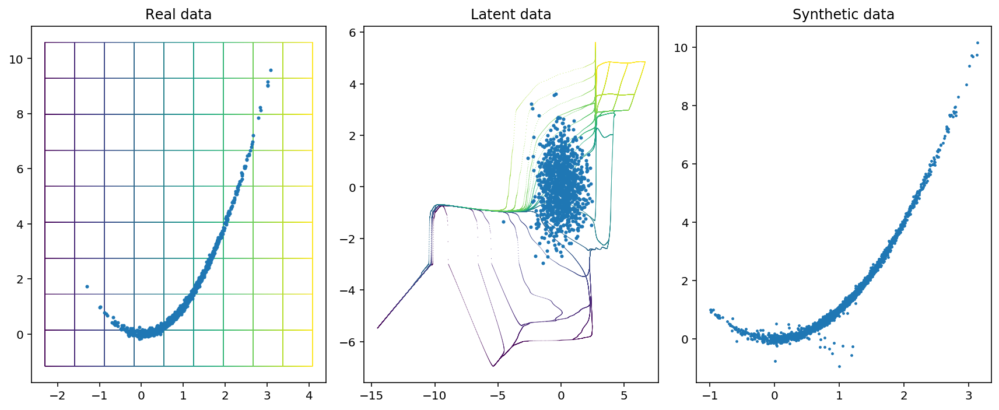

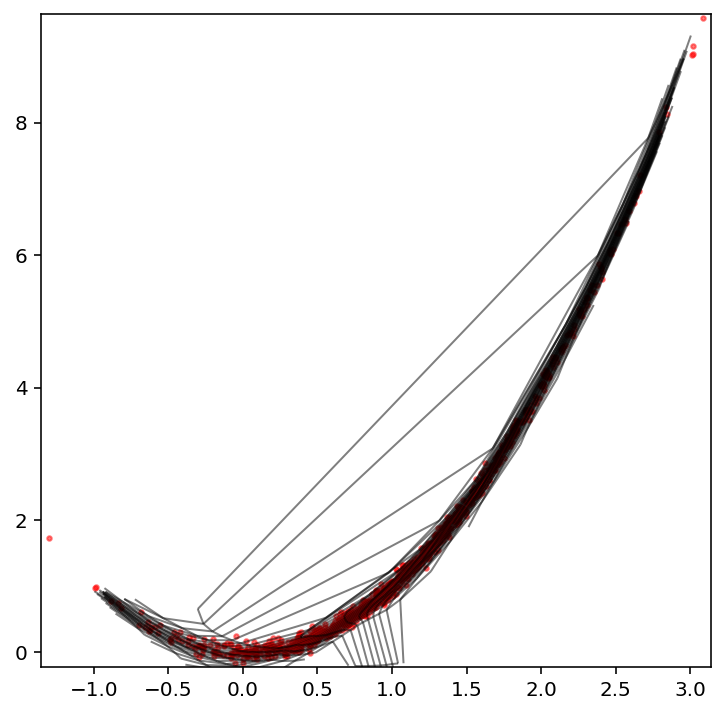

Creating directory for new run logs/test/run42
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


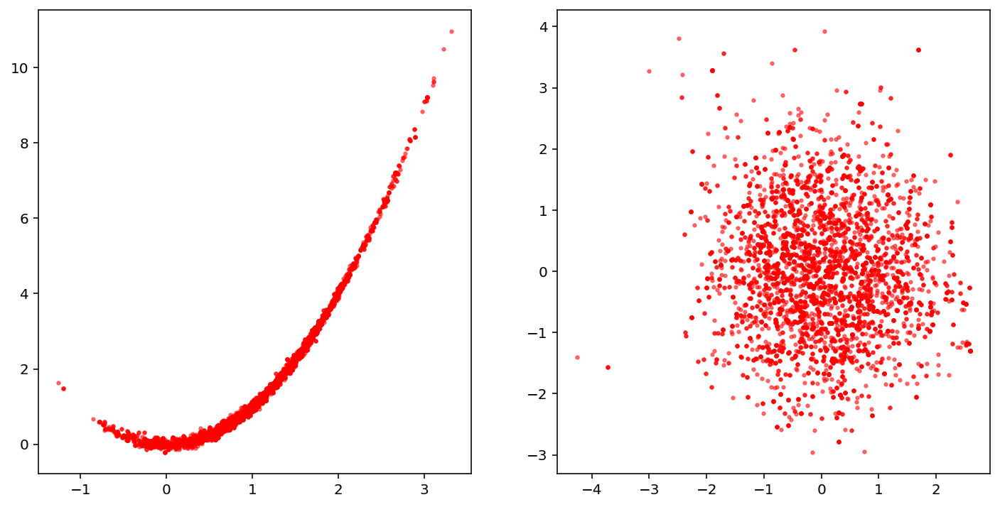

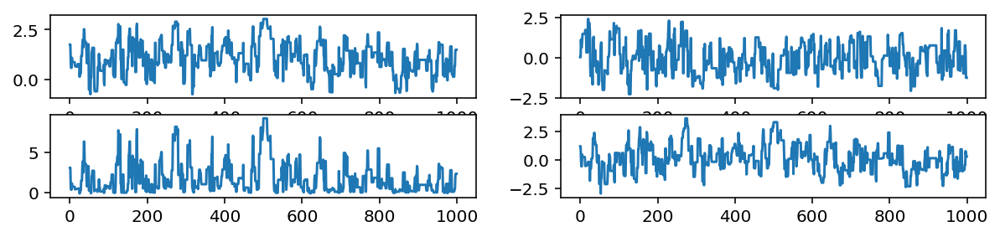

Removed no burn in
651.480578739326
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.51E+00            7.51             666
param2           8.09E+00            8.09             618


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0972  p_{1}
param2        0.1214  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00569
  2      0.01820

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.1595   0.2031   0.1936 upper
param1       0.1312   0.1298   0.1945 lower
param2       0.3272   0.4388   0.4370 upper
param2       0.0004   0.0035   0.0023 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          1

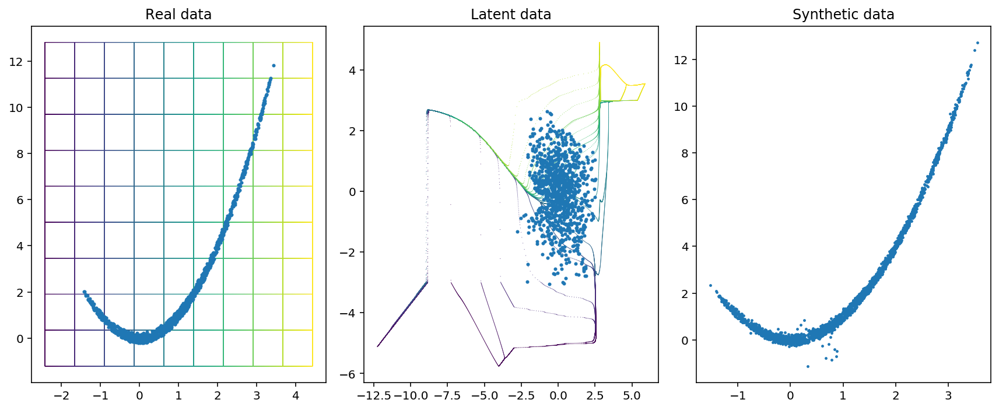

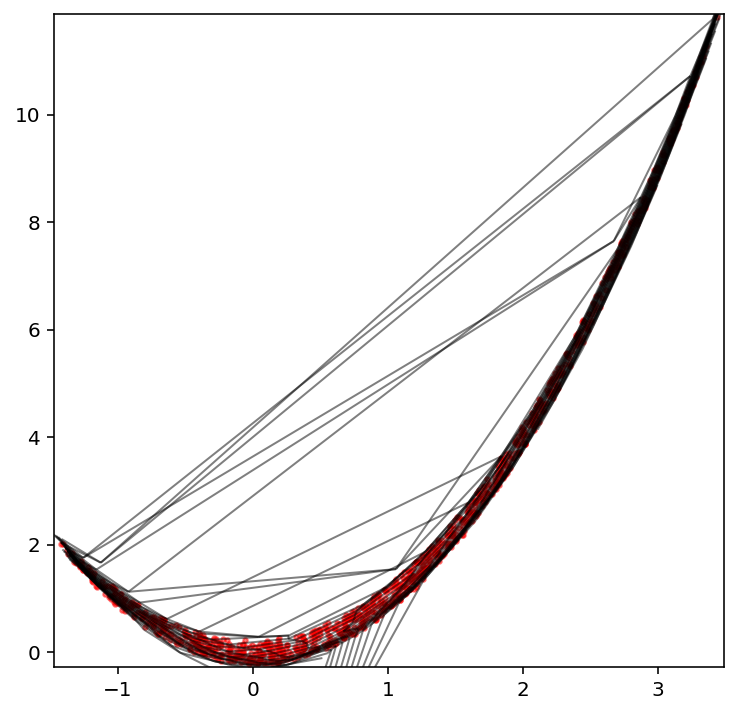

Creating directory for new run logs/test/run43
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


--- Logging error ---
Traceback (most recent call last):
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/sampler.py", line 280, in _mcmc_sample
    x_propose, log_det_J_propose = self.trainer.netG.inverse(z_propose)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 69, in inverse
    return self.flow.inverse(z)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 39, in inverse
    z, ld = flow.inverse(z)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 616, in inverse
    upper, ld = unconstrained_RQS(upper, W, H, D, inverse=True, tail_bound=self.B)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 444, in unconstrained_RQS
    outputs[inside_intvl_mask], logabsdet[inside_intvl_mask] = RQS(
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 463, in RQS
    if torch.min(inputs) < left or torch.max(inputs) > right:
RuntimeError: operation does not have an identity.

During handling of the

--- Logging error ---
Traceback (most recent call last):
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/sampler.py", line 280, in _mcmc_sample
    x_propose, log_det_J_propose = self.trainer.netG.inverse(z_propose)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 69, in inverse
    return self.flow.inverse(z)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 39, in inverse
    z, ld = flow.inverse(z)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 609, in inverse
    lower, ld = unconstrained_RQS(lower, W, H, D, inverse=True, tail_bound=self.B)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 444, in unconstrained_RQS
    outputs[inside_intvl_mask], logabsdet[inside_intvl_mask] = RQS(
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 463, in RQS
    if torch.min(inputs) < left or torch.max(inputs) > right:
RuntimeError: operation does not have an identity.

During handling of the

--- Logging error ---
Traceback (most recent call last):
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/sampler.py", line 280, in _mcmc_sample
    x_propose, log_det_J_propose = self.trainer.netG.inverse(z_propose)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 69, in inverse
    return self.flow.inverse(z)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 39, in inverse
    z, ld = flow.inverse(z)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 609, in inverse
    lower, ld = unconstrained_RQS(lower, W, H, D, inverse=True, tail_bound=self.B)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 444, in unconstrained_RQS
    outputs[inside_intvl_mask], logabsdet[inside_intvl_mask] = RQS(
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 463, in RQS
    if torch.min(inputs) < left or torch.max(inputs) > right:
RuntimeError: operation does not have an identity.

During handling of the

--- Logging error ---
Traceback (most recent call last):
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/sampler.py", line 280, in _mcmc_sample
    x_propose, log_det_J_propose = self.trainer.netG.inverse(z_propose)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 69, in inverse
    return self.flow.inverse(z)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 39, in inverse
    z, ld = flow.inverse(z)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 609, in inverse
    lower, ld = unconstrained_RQS(lower, W, H, D, inverse=True, tail_bound=self.B)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 444, in unconstrained_RQS
    outputs[inside_intvl_mask], logabsdet[inside_intvl_mask] = RQS(
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 463, in RQS
    if torch.min(inputs) < left or torch.max(inputs) > right:
RuntimeError: operation does not have an identity.

During handling of the

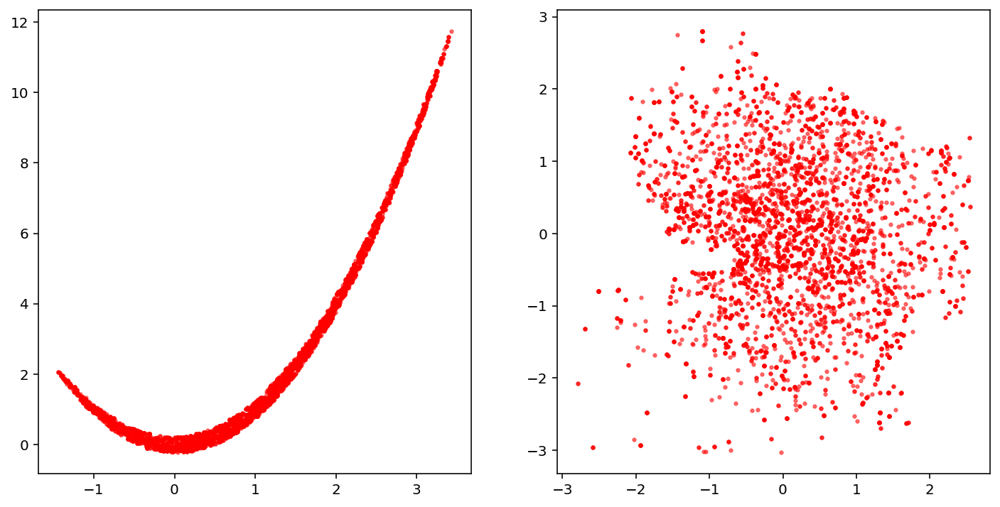

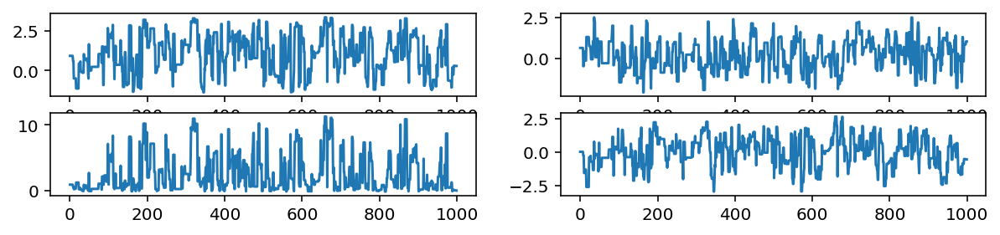

Removed no burn in
608.2077972874212
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           8.14E+00            8.14             615
param2           7.62E+00            7.62             657


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0705  p_{1}
param2        0.0790  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00298
  2      0.00631

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0272   0.0327   0.0448 upper
param1       0.0106   0.0494   0.0307 lower
param2       0.0561   0.0982   0.1317 upper
param2       0.0053   0.0080   0.0100 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

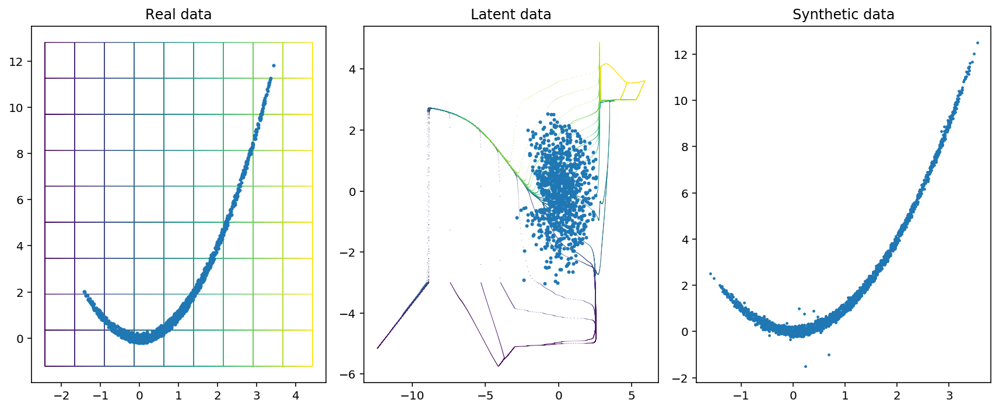

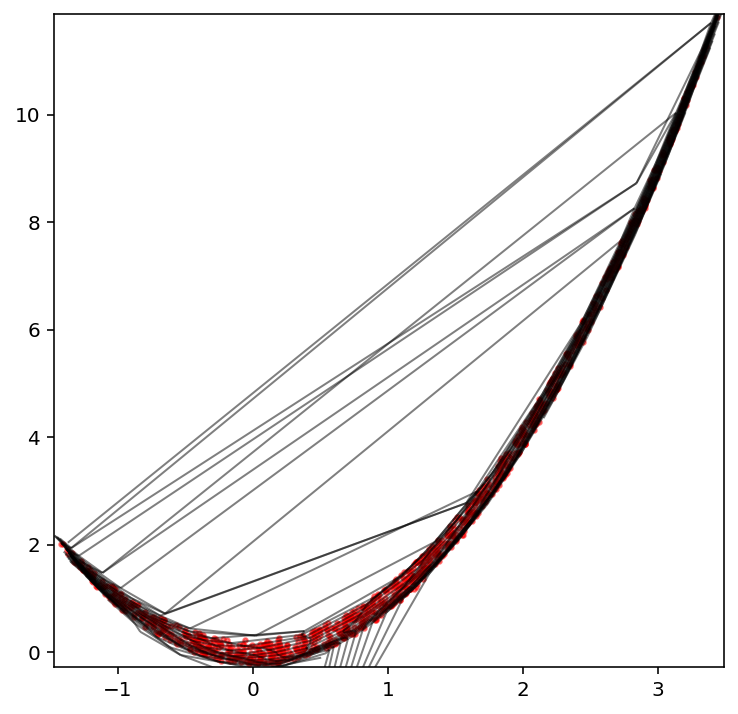

Creating directory for new run logs/test/run44
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


--- Logging error ---
Traceback (most recent call last):
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/sampler.py", line 280, in _mcmc_sample
    x_propose, log_det_J_propose = self.trainer.netG.inverse(z_propose)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 69, in inverse
    return self.flow.inverse(z)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 39, in inverse
    z, ld = flow.inverse(z)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 609, in inverse
    lower, ld = unconstrained_RQS(lower, W, H, D, inverse=True, tail_bound=self.B)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 444, in unconstrained_RQS
    outputs[inside_intvl_mask], logabsdet[inside_intvl_mask] = RQS(
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 463, in RQS
    if torch.min(inputs) < left or torch.max(inputs) > right:
RuntimeError: operation does not have an identity.

During handling of the

--- Logging error ---
Traceback (most recent call last):
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/sampler.py", line 280, in _mcmc_sample
    x_propose, log_det_J_propose = self.trainer.netG.inverse(z_propose)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 69, in inverse
    return self.flow.inverse(z)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 39, in inverse
    z, ld = flow.inverse(z)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 609, in inverse
    lower, ld = unconstrained_RQS(lower, W, H, D, inverse=True, tail_bound=self.B)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 444, in unconstrained_RQS
    outputs[inside_intvl_mask], logabsdet[inside_intvl_mask] = RQS(
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 463, in RQS
    if torch.min(inputs) < left or torch.max(inputs) > right:
RuntimeError: operation does not have an identity.

During handling of the

--- Logging error ---
Traceback (most recent call last):
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/sampler.py", line 280, in _mcmc_sample
    x_propose, log_det_J_propose = self.trainer.netG.inverse(z_propose)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 69, in inverse
    return self.flow.inverse(z)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 39, in inverse
    z, ld = flow.inverse(z)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 609, in inverse
    lower, ld = unconstrained_RQS(lower, W, H, D, inverse=True, tail_bound=self.B)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 444, in unconstrained_RQS
    outputs[inside_intvl_mask], logabsdet[inside_intvl_mask] = RQS(
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 463, in RQS
    if torch.min(inputs) < left or torch.max(inputs) > right:
RuntimeError: operation does not have an identity.

During handling of the

--- Logging error ---
Traceback (most recent call last):
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/sampler.py", line 280, in _mcmc_sample
    x_propose, log_det_J_propose = self.trainer.netG.inverse(z_propose)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 69, in inverse
    return self.flow.inverse(z)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 39, in inverse
    z, ld = flow.inverse(z)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 609, in inverse
    lower, ld = unconstrained_RQS(lower, W, H, D, inverse=True, tail_bound=self.B)
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 444, in unconstrained_RQS
    outputs[inside_intvl_mask], logabsdet[inside_intvl_mask] = RQS(
  File "/Users/adammoss/work/code/MCMC/nnest/nnest/networks.py", line 463, in RQS
    if torch.min(inputs) < left or torch.max(inputs) > right:
RuntimeError: operation does not have an identity.

During handling of the

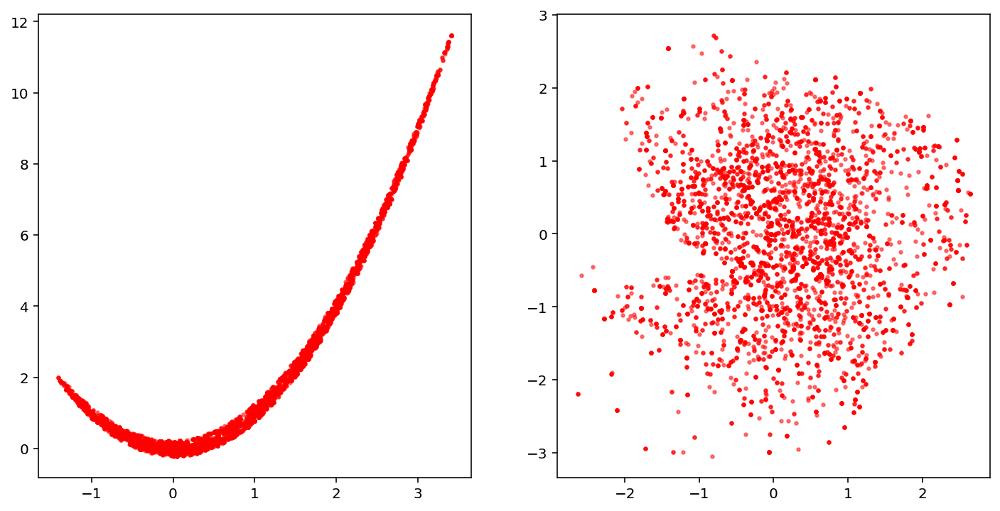

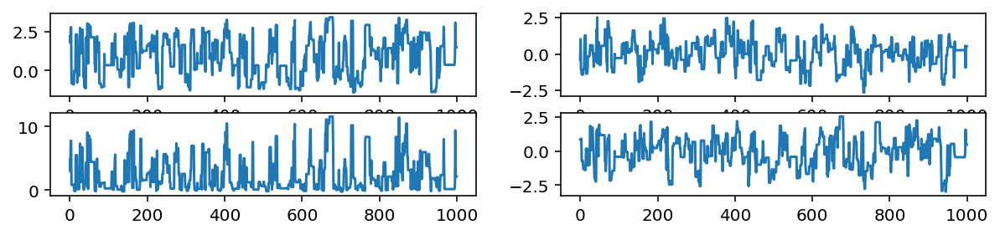

Removed no burn in
568.7299081992572
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           8.39E+00            8.39             596
param2           7.16E+00            7.16             698


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1070  p_{1}
param2        0.0713  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00339
  2      0.01600

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0080   0.0331   0.0452 upper
param1       0.0361   0.0350   0.0406 lower
param2       0.0295   0.1002   0.1306 upper
param2       0.0042   0.0023   0.0099 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

In [20]:
model = Trainer(like.x_dim, flow='spline', learning_rate=0.001)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

In [21]:
prior = UniformPrior(2, -15, 15)
like = Eggbox(2)

[nnest.trainer] [INFO] SingleSpeedCholeksy(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): Choleksy()
    )
  )
)
[nnest.trainer] [INFO] Number of network params: [5]
[nnest.trainer] [INFO] Device [cpu]
[nnest.trainer] [INFO] Number of training samples [1000]
[nnest.trainer] [INFO] Training jitter [0.0010]
[nnest.trainer] [INFO] Epoch [1] train loss [0.8741] validation loss [0.8464]
[nnest.trainer] [INFO] Epoch [100] train loss [0.3412] validation loss [0.3316]
[nnest.trainer] [INFO] Epoch [200] train loss [0.1778] validation loss [0.1739]
[nnest.trainer] [INFO] Epoch [300] train loss [0.1173] validation loss [0.1153]
[nnest.trainer] [INFO] Epoch [400] train loss [0.0918] validation loss [0.0906]
[nnest.trainer] [INFO] Epoch [500] train loss [0.0805] validation loss [0.0797]
[nnest.trainer] [INFO] Epoch [600] train loss [0.0755] validation loss [0.0750]
[nnest.trainer] [INFO] Epoch [700] train loss [0.0736] validation loss [0.0732]
[nnest.trainer] [INFO] Epoch [800] tra

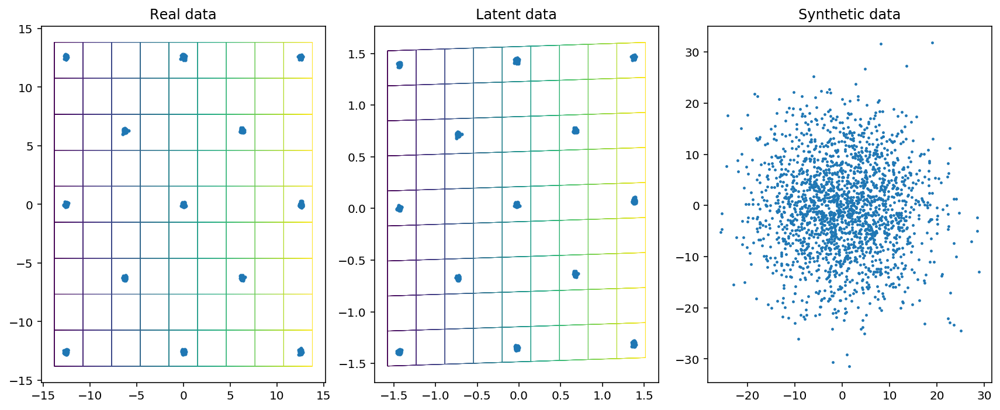

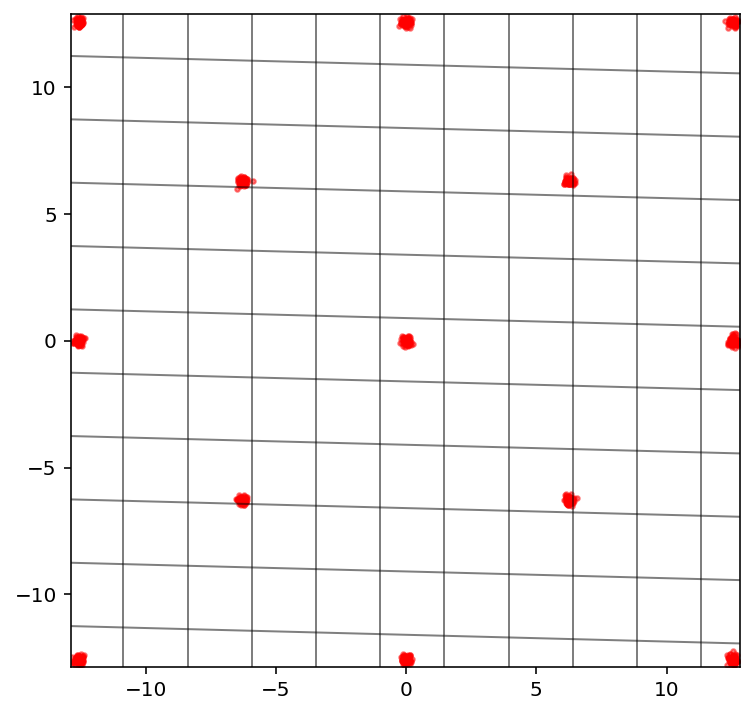

Creating directory for new run logs/test/run45
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


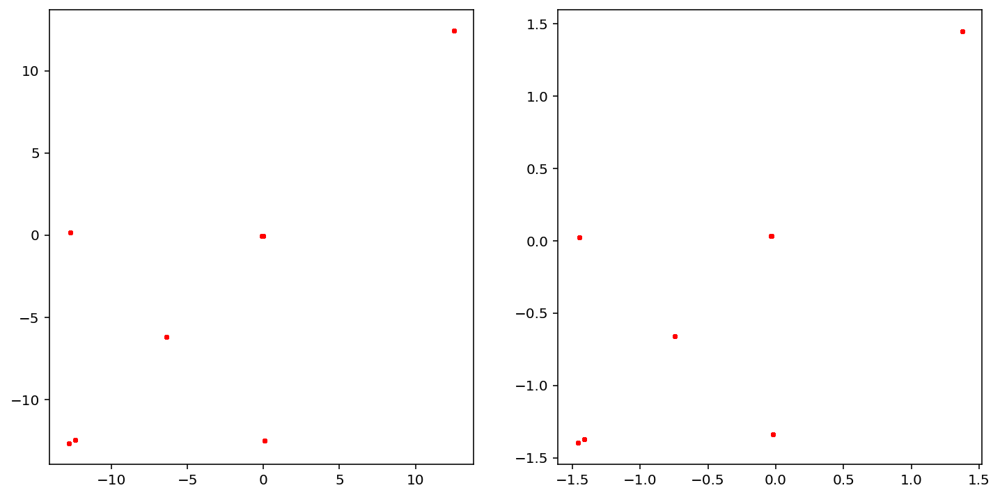

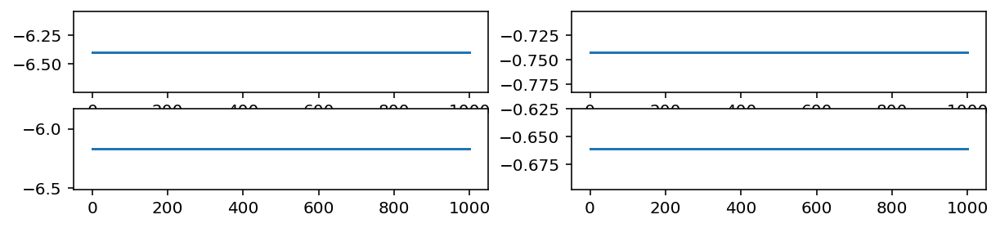

Removed no burn in
5005 1.414213562373095
[nnest.trainer] [INFO] Number of training samples [1000]
[nnest.trainer] [INFO] Training jitter [0.0010]
[nnest.trainer] [INFO] Epoch [1] train loss [0.0729] validation loss [0.0726]
[nnest.trainer] [INFO] Epoch [74] ran out of patience
[nnest.trainer] [INFO] Best epoch [24] validation loss [0.0726]


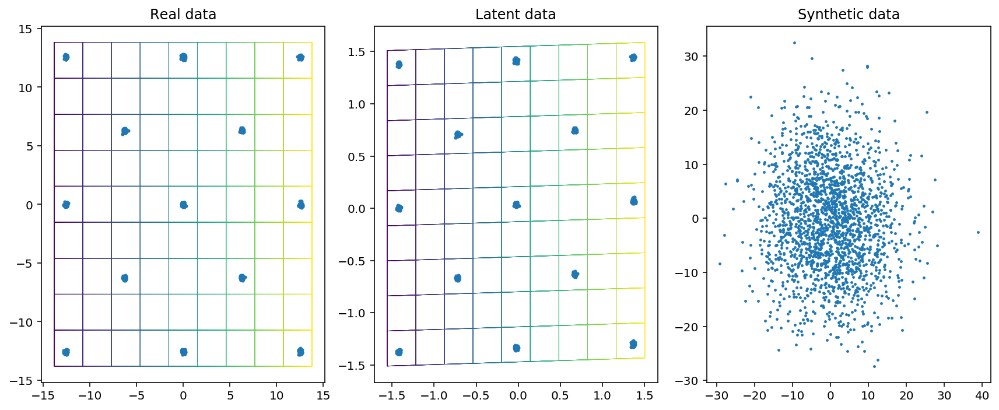

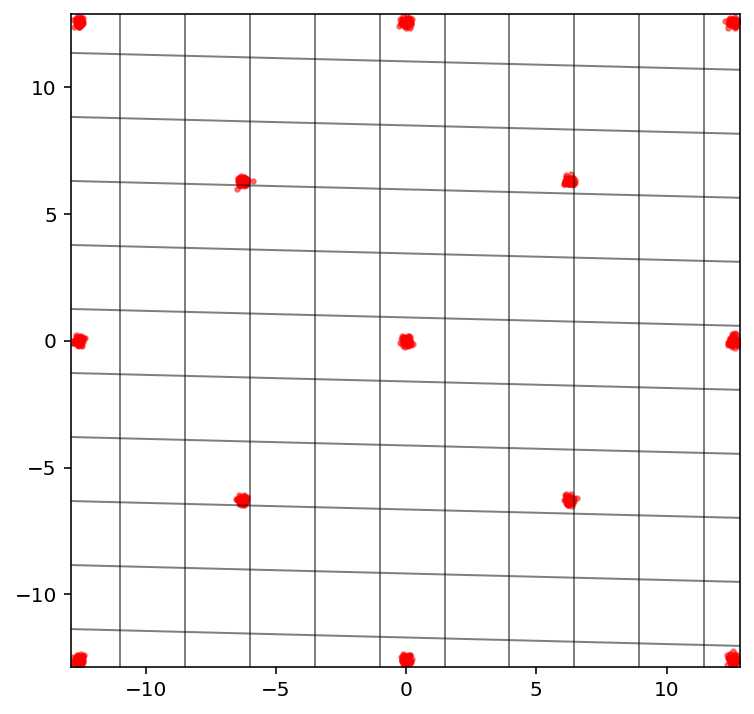

Creating directory for new run logs/test/run46
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


/Users/adammoss/work/code/MCMC/nnest/nnest/sampler.py:354: RuntimeWarning: invalid value encountered in subtract
  log_ratio_3 = torch.tensor(logl_prior_prime - logl_prior)


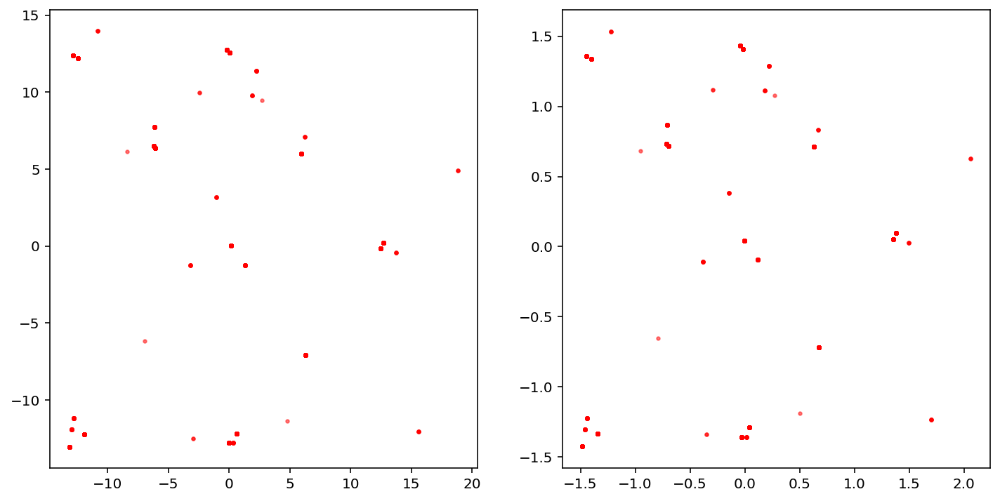

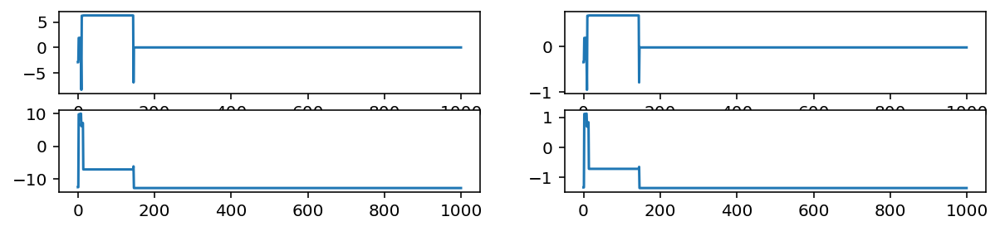

Removed no burn in
19.481252805584774
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.40E-01            0.74            6764
param2           1.91E-01            0.19           26167


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.6629  p_{1}
param2        2.2990  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.41736
  2      5.33843

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0221   0.4853   0.4205 upper
param1       0.0223   0.0802   0.0193 lower
param2       0.4448   0.3632   0.4018 upper
param2       0.0201   0.0361   0.6561 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enou

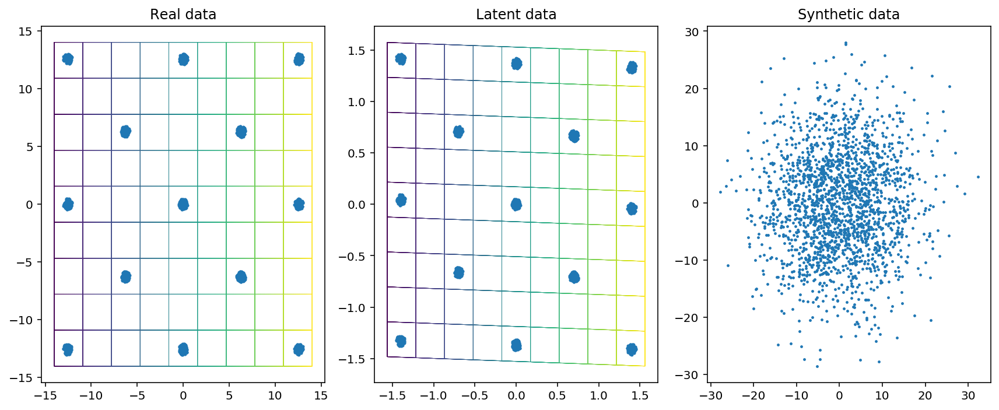

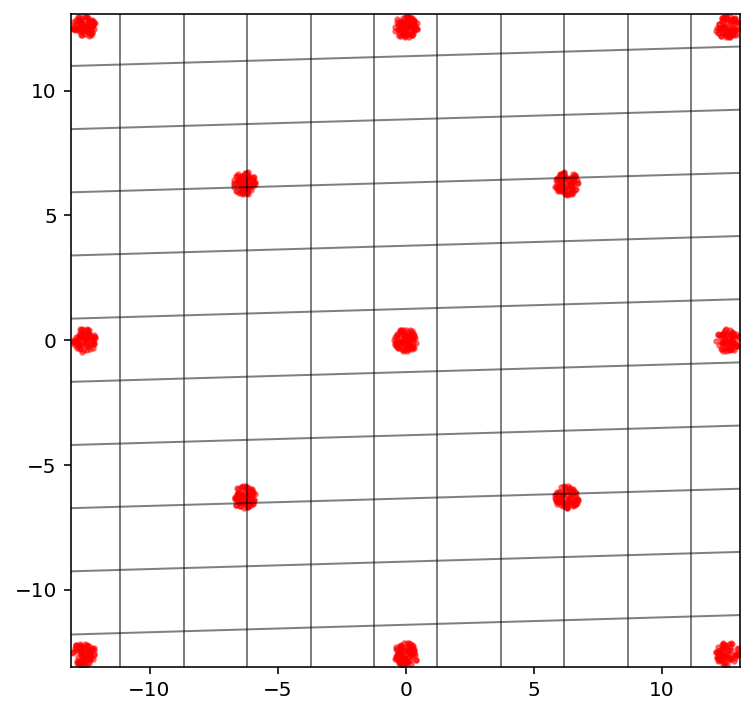

Creating directory for new run logs/test/run47
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


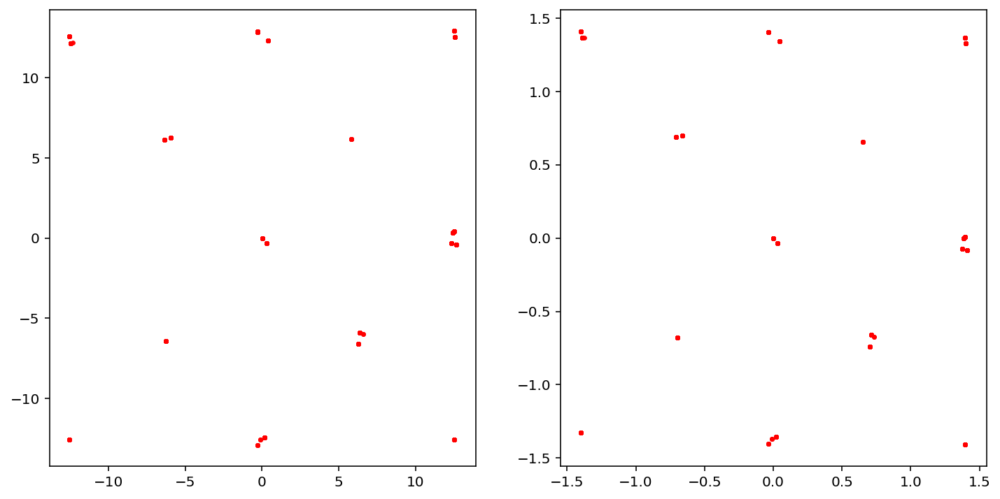

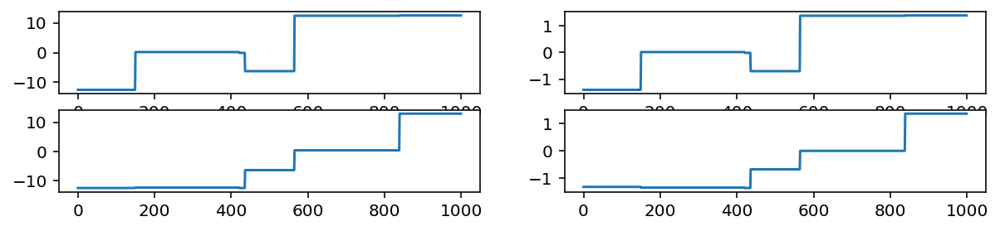

Removed no burn in
16.432983904845972
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.48E-01            0.65            7723
param2           6.39E-01            0.64            7832


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.8240  p_{1}
param2        0.8403  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.19453
  2      1.20902

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0054   0.0058   0.0057 upper
param1       1.0079   0.8230   1.0323 lower
param2       0.0050   0.0222   0.0321 upper
param2       0.0003   0.3613   0.4661 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enou

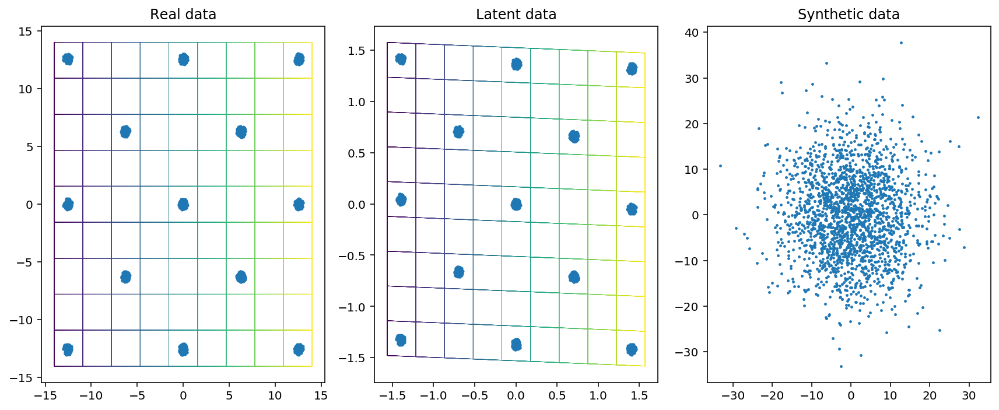

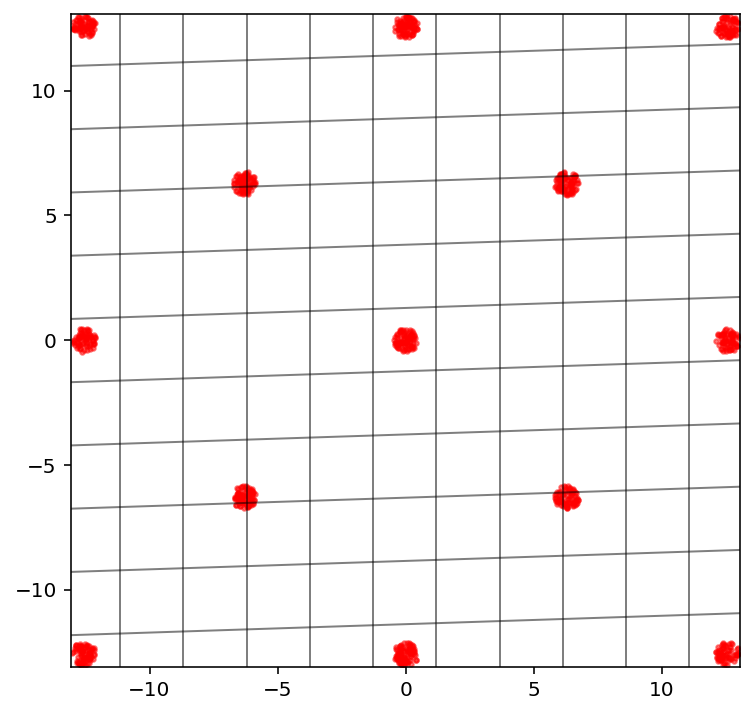

Creating directory for new run logs/test/run48
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


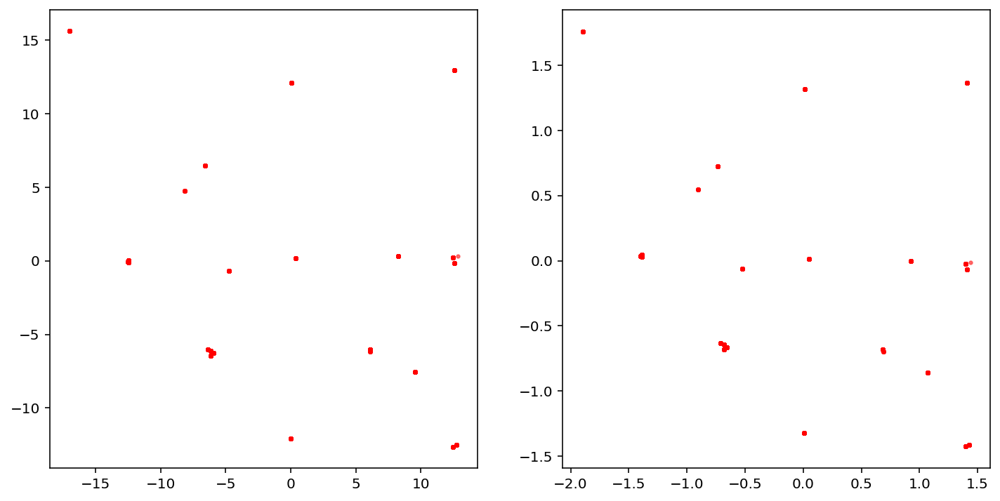

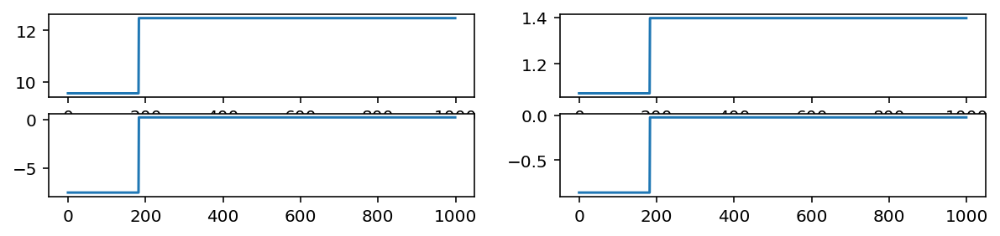

Removed no burn in
5005.000008880493
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           3.35E-01            0.33           14943
param2           6.61E-01            0.66            7566


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        1.5755  p_{1}
param2        0.7998  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.46213
  2      2.56430

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0090   0.0101   0.0121 upper
param1       0.3254   0.6842   0.6356 lower
param2       1.6970   1.4313   2.3996 upper
param2       0.5654   0.7255   0.6283 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enoug

In [22]:
model = Trainer(like.x_dim, flow='choleksy', learning_rate=0.001)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

[nnest.trainer] [INFO] SingleSpeedNVP(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): CouplingLayer(
        (scale_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
          (1): Tanh()
          (2): Linear(in_features=64, out_features=64, bias=True)
          (3): Tanh()
          (4): Linear(in_features=64, out_features=64, bias=True)
          (5): Tanh()
          (6): Linear(in_features=64, out_features=2, bias=True)
        )
        (translate_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
          (1): ReLU()
          (2): Linear(in_features=64, out_features=64, bias=True)
          (3): ReLU()
          (4): Linear(in_features=64, out_features=64, bias=True)
          (5): ReLU()
          (6): Linear(in_features=64, out_features=2, bias=True)
        )
      )
      (1): CouplingLayer(
        (scale_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
     

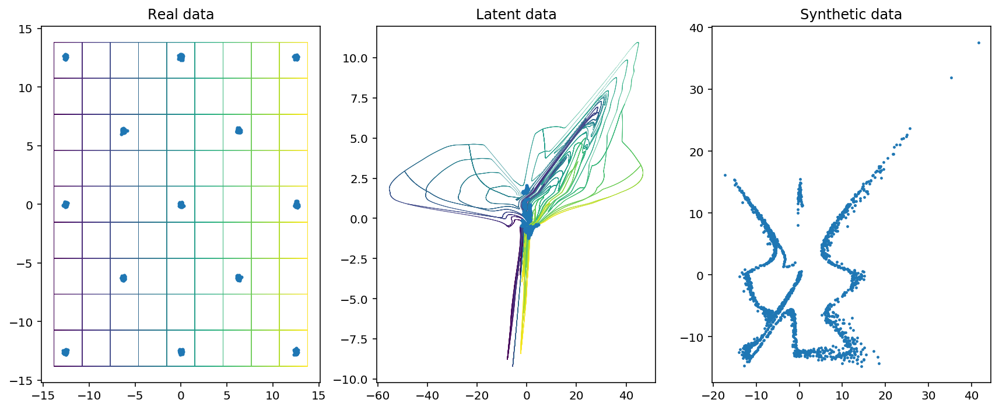

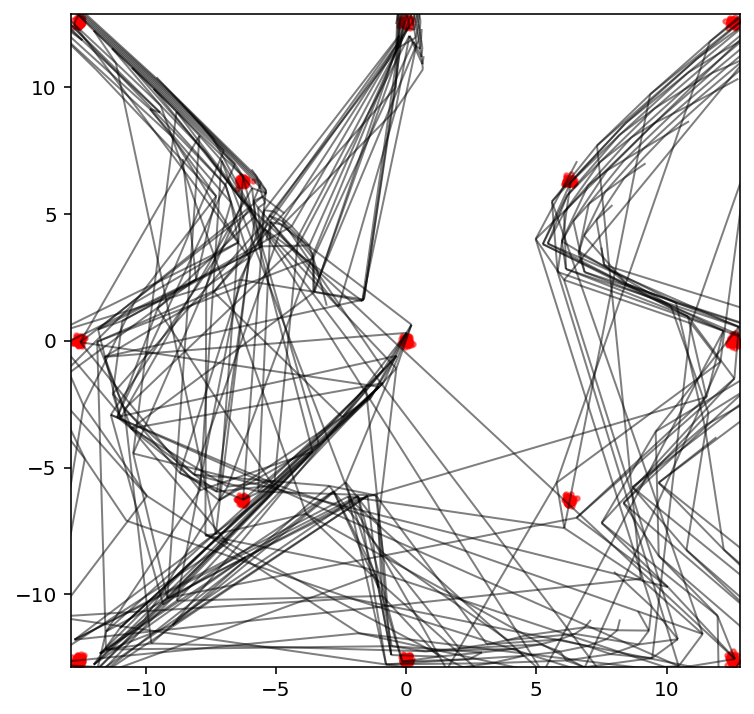

Creating directory for new run logs/test/run49
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


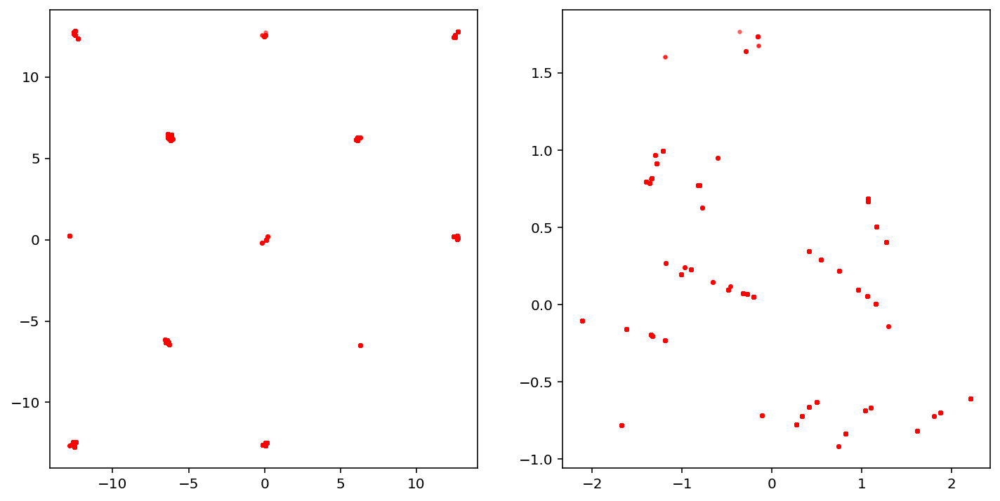

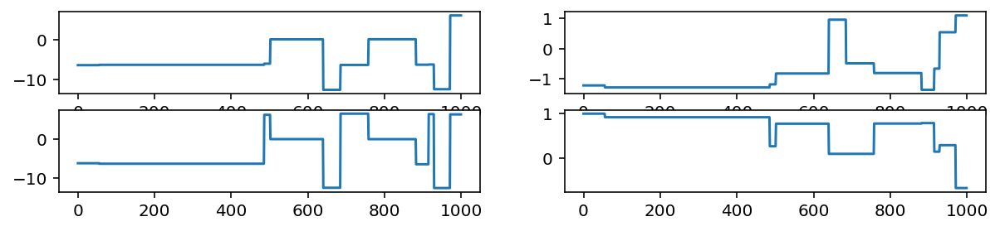

Removed no burn in
21.12662244803476
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.55E-01            0.76            6625
param2           9.29E-01            0.93            5386


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.6361  p_{1}
param2        0.3089  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.05972
  2      0.40468

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0005   0.0039   0.0034 upper
param1       0.0198   0.0136   0.3586 lower
param2       0.0286   0.4019   0.3486 upper
param2       0.0057   0.0122   0.0106 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enoug

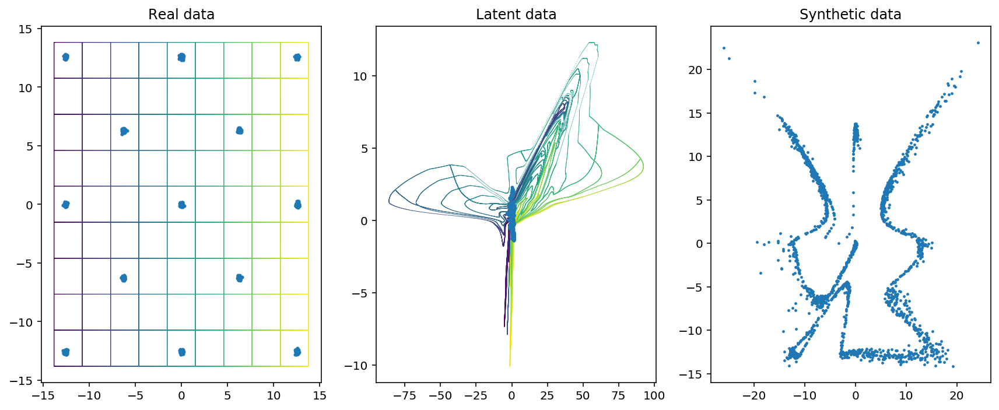

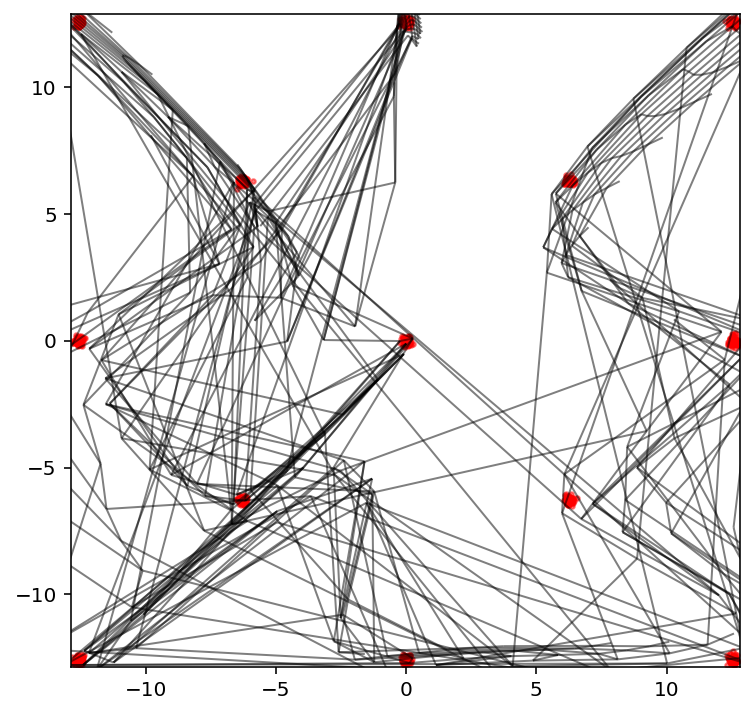

Creating directory for new run logs/test/run50
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


/Users/adammoss/work/code/MCMC/nnest/nnest/sampler.py:354: RuntimeWarning: invalid value encountered in subtract
  log_ratio_3 = torch.tensor(logl_prior_prime - logl_prior)


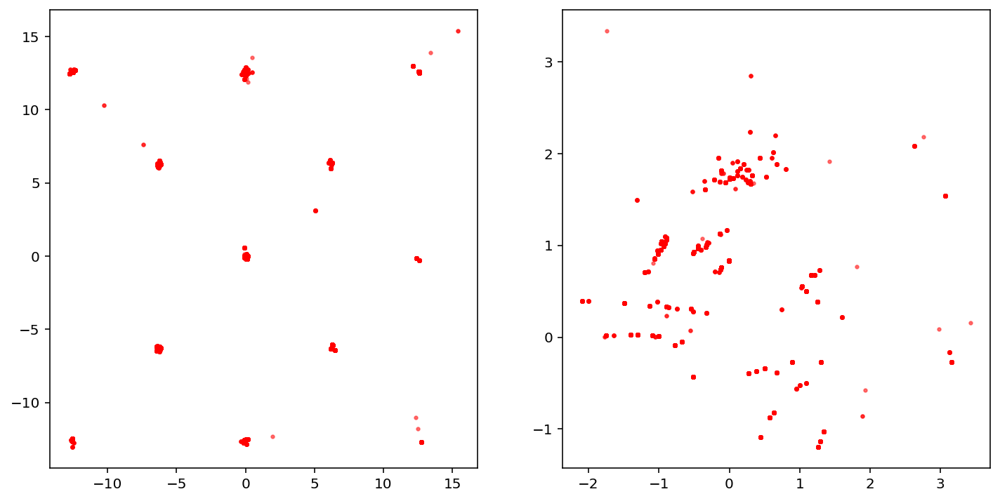

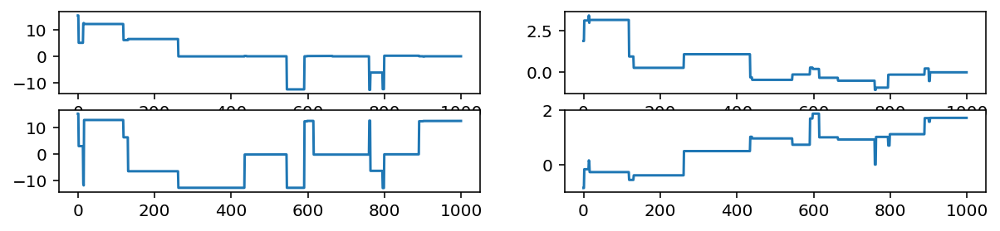

Removed no burn in
25.752149985441747
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           8.65E-01            0.87            5785
param2           9.34E-01            0.93            5360


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.4415  p_{1}
param2        0.2979  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.06486
  2      0.24350

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0426   0.0348   0.4040 upper
param1       0.0146   0.0111   0.0154 lower
param2       0.0165   0.0151   0.0133 upper
param2       0.0019   0.0045   0.0081 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1         

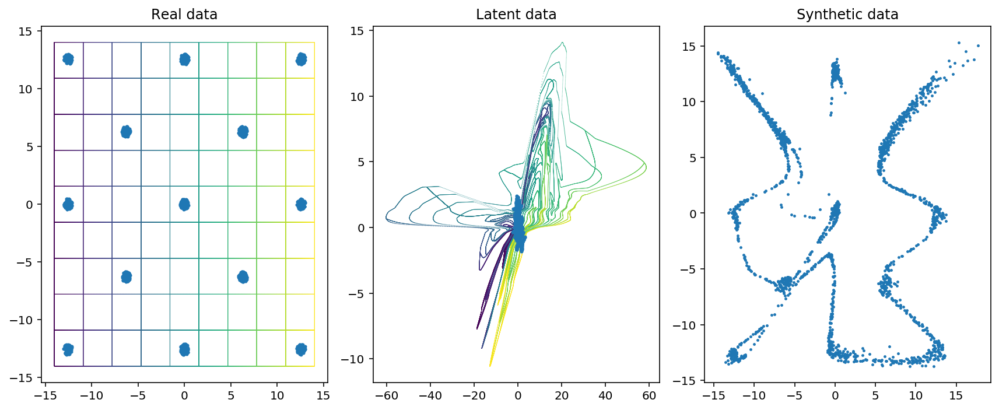

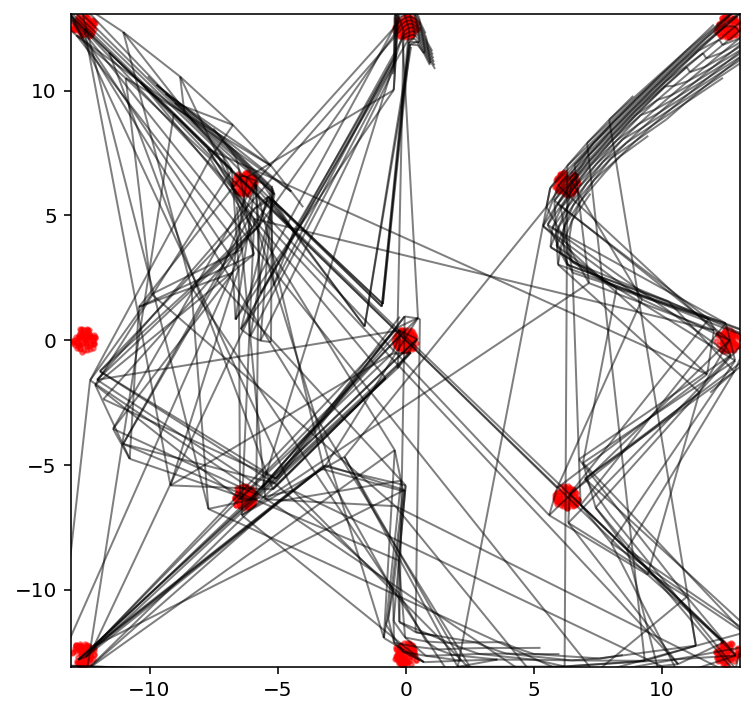

Creating directory for new run logs/test/run51
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


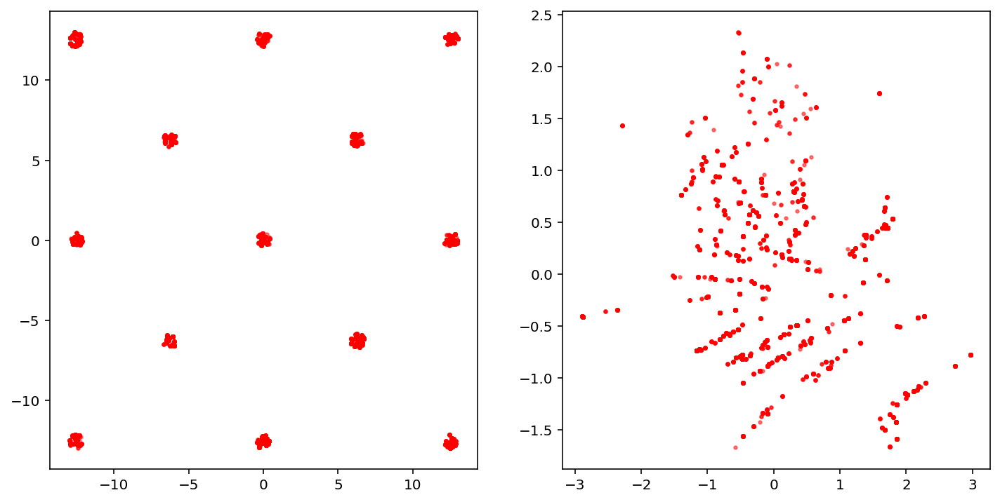

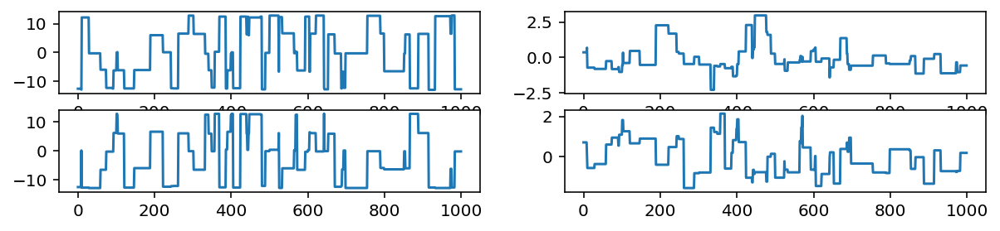

Removed no burn in
121.01307026277874
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           3.83E+01           38.29             130
param2           3.47E+01           34.75             144


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.2308  p_{1}
param2        0.1998  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.03020
  2      0.06260

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0008   0.0058   0.0124 upper
param1       0.0059   0.0081   0.0069 lower
param2       0.0078   0.0076   0.0074 upper
param2       0.0045   0.0084   0.0144 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enou

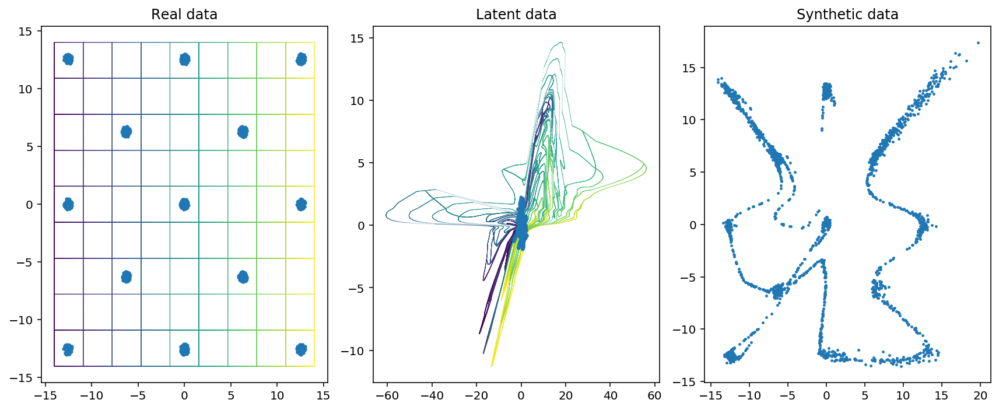

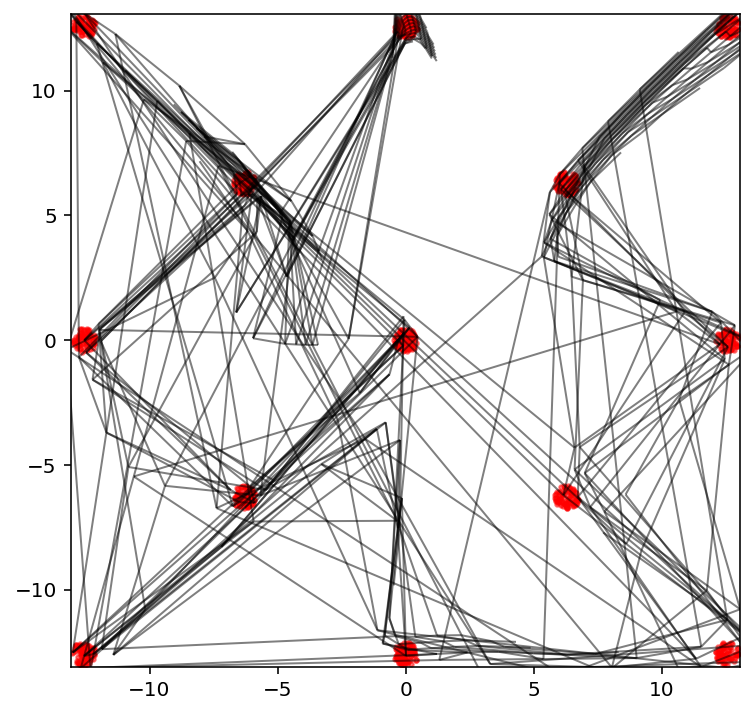

Creating directory for new run logs/test/run52
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


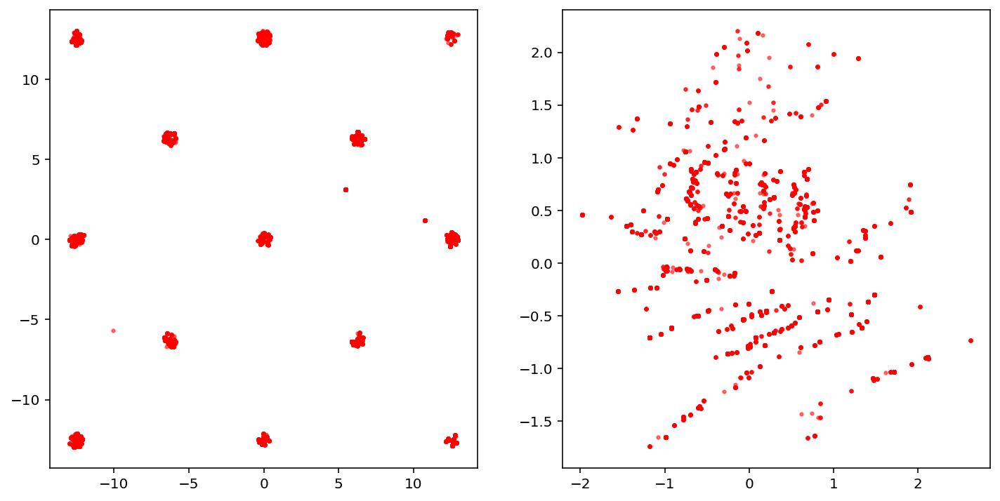

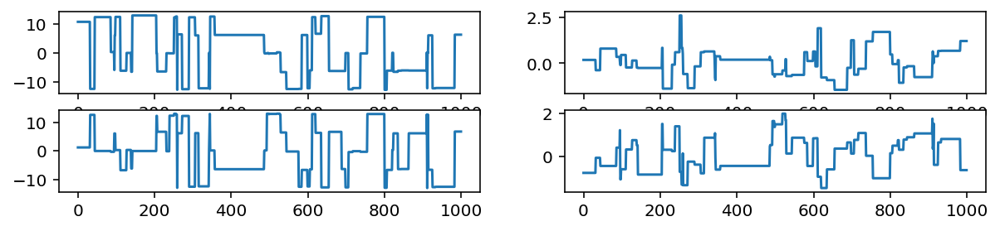

Removed no burn in
142.55208680976028
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           3.15E+01           31.51             158
param2           2.47E+01           24.67             202


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1899  p_{1}
param2        0.1007  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.01008
  2      0.03610

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0124   0.0116   0.0109 upper
param1       0.0076   0.0093   0.0123 lower
param2       0.0110   0.0103   0.0100 upper
param2       0.0058   0.0085   0.0072 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1         

In [23]:
model = Trainer(like.x_dim, hidden_dim=64, num_blocks=5, flow='nvp', learning_rate=0.001)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

[nnest.trainer] [INFO] SingleSpeedSpline(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): ActNorm()
      (1): Invertible1x1Conv()
      (2): NSF_CL(
        (f1): MLP(
          (net): Sequential(
            (0): Linear(in_features=1, out_features=16, bias=True)
            (1): LeakyReLU(negative_slope=0.2)
            (2): Linear(in_features=16, out_features=16, bias=True)
            (3): LeakyReLU(negative_slope=0.2)
            (4): Linear(in_features=16, out_features=16, bias=True)
            (5): LeakyReLU(negative_slope=0.2)
            (6): Linear(in_features=16, out_features=23, bias=True)
          )
        )
        (f2): MLP(
          (net): Sequential(
            (0): Linear(in_features=1, out_features=16, bias=True)
            (1): LeakyReLU(negative_slope=0.2)
            (2): Linear(in_features=16, out_features=16, bias=True)
            (3): LeakyReLU(negative_slope=0.2)
            (4): Linear(in_features=16, out_features=16, bias=True)
        

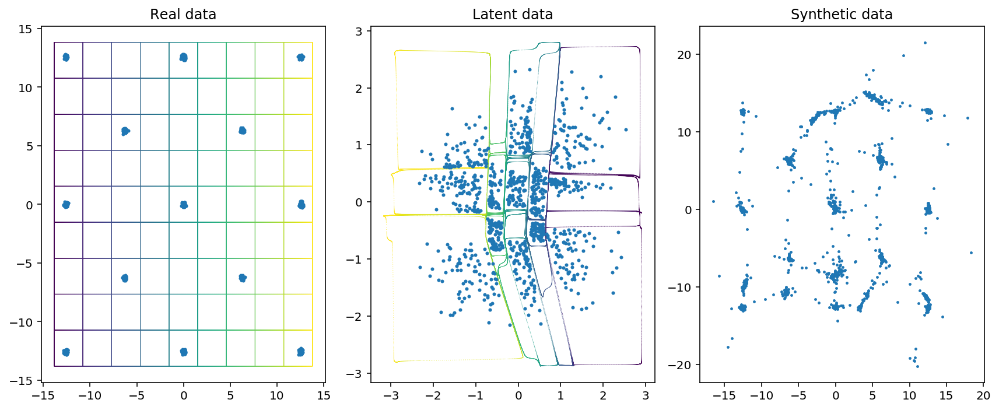

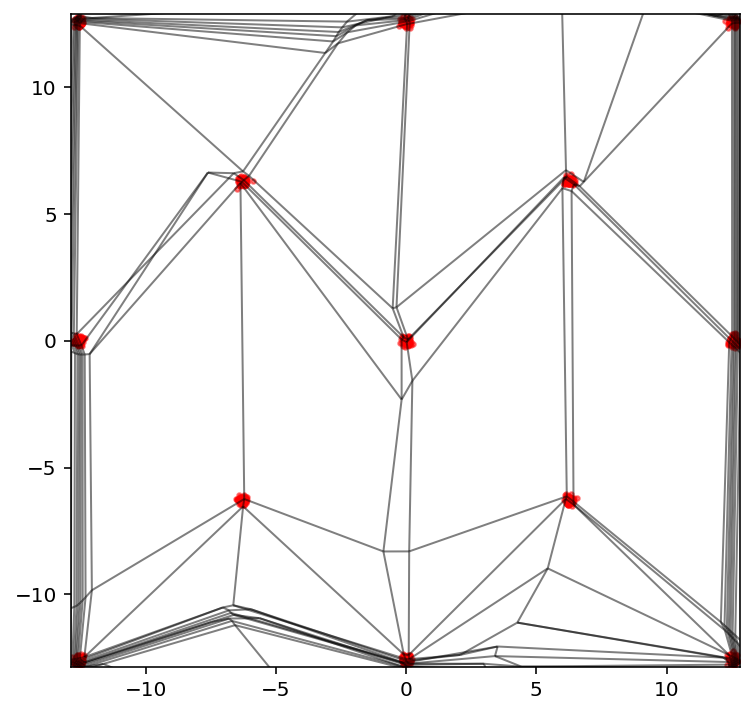

Creating directory for new run logs/test/run53
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


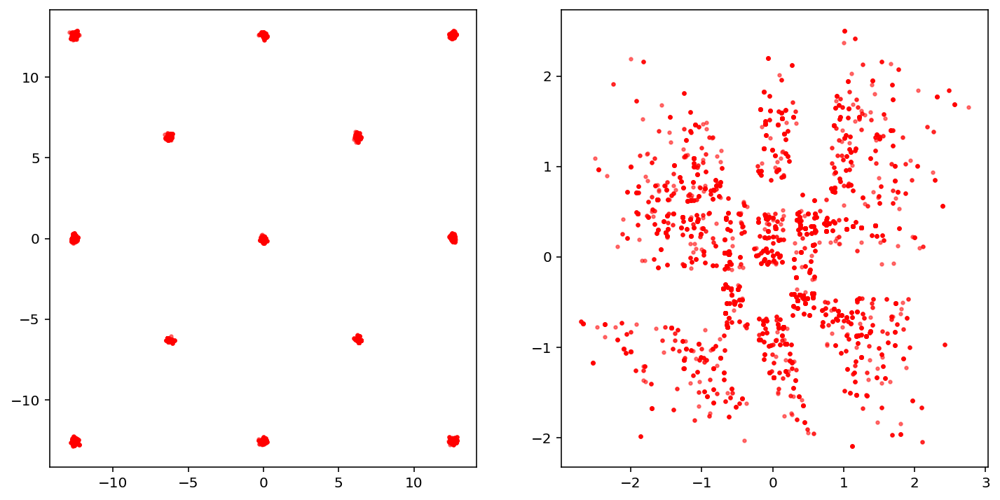

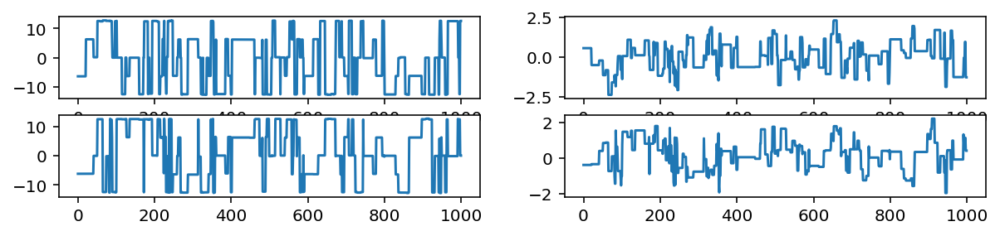

Removed no burn in
254.07942374632503
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           1.96E+01           19.59             255
param2           1.66E+01           16.57             302


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1158  p_{1}
param2        0.1559  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00572
  2      0.03108

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0032   0.0026   0.0047 upper
param1       0.0003   0.0007   0.0011 lower
param2       0.0001   0.0035   0.0033 upper
param2       0.0035   0.0031   0.0029 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1         

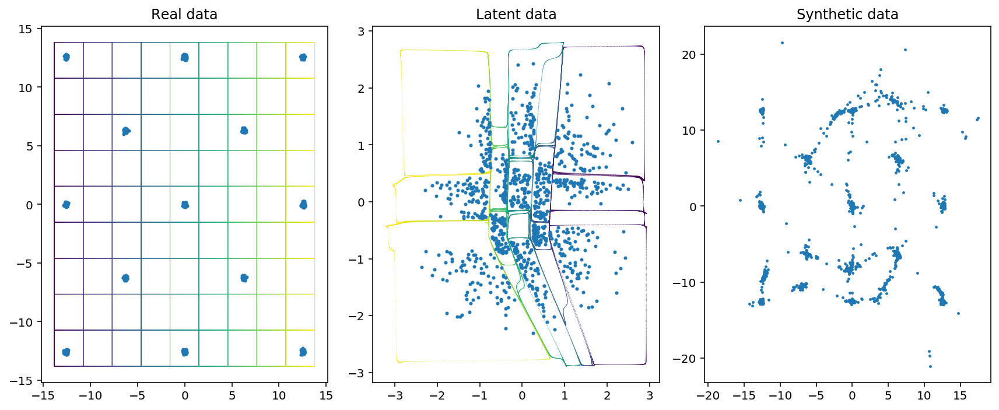

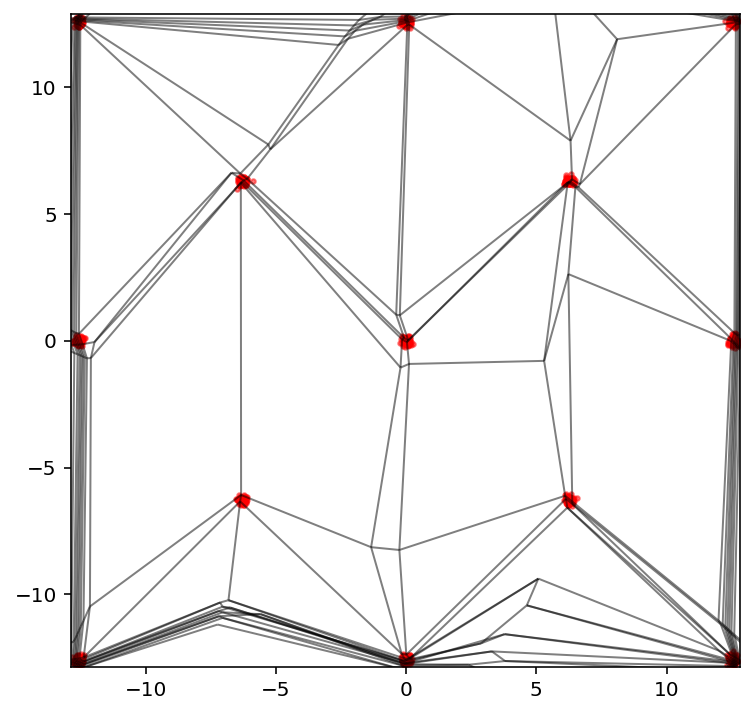

Creating directory for new run logs/test/run54
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


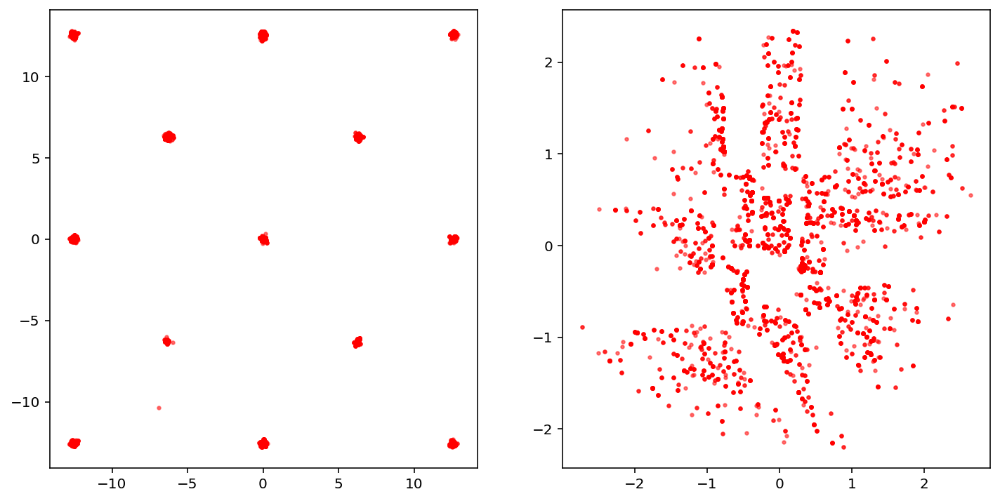

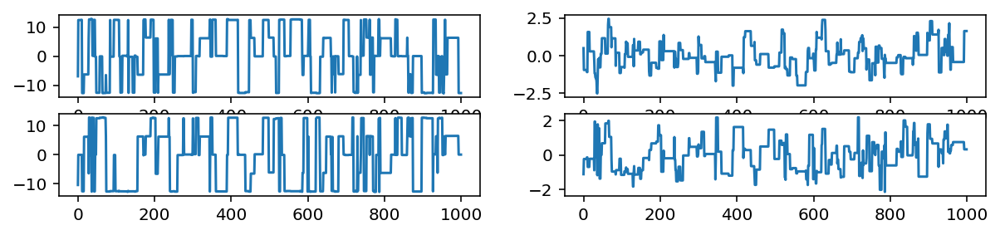

Removed no burn in
333.40289282333924
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           1.50E+01           15.04             332
param2           1.61E+01           16.14             310


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.0463  p_{1}
param2        0.1603  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00206
  2      0.02574

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0006   0.0029   0.0027 upper
param1       0.0019   0.0009   0.0019 lower
param2       0.0026   0.0023   0.0034 upper
param2       0.0008   0.0013   0.0029 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1         

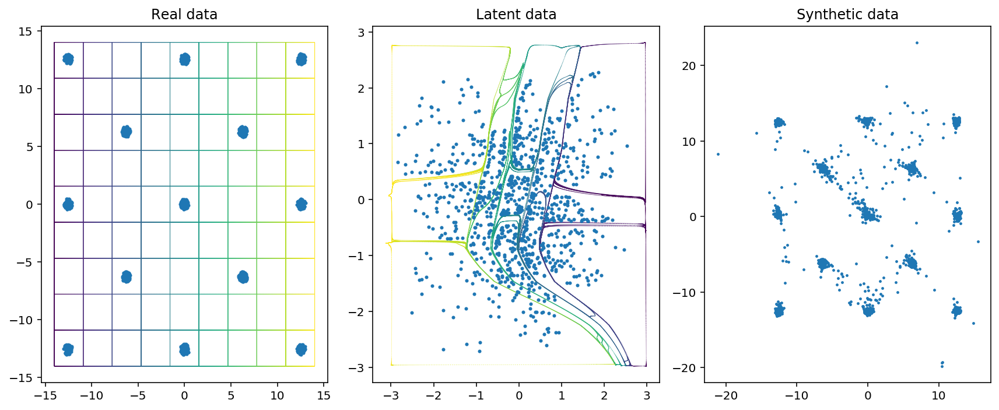

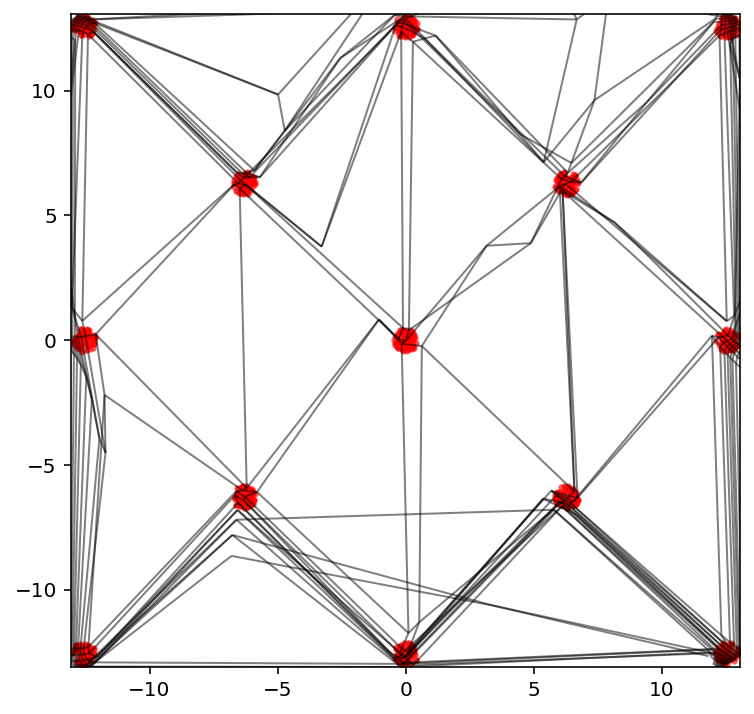

Creating directory for new run logs/test/run55
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


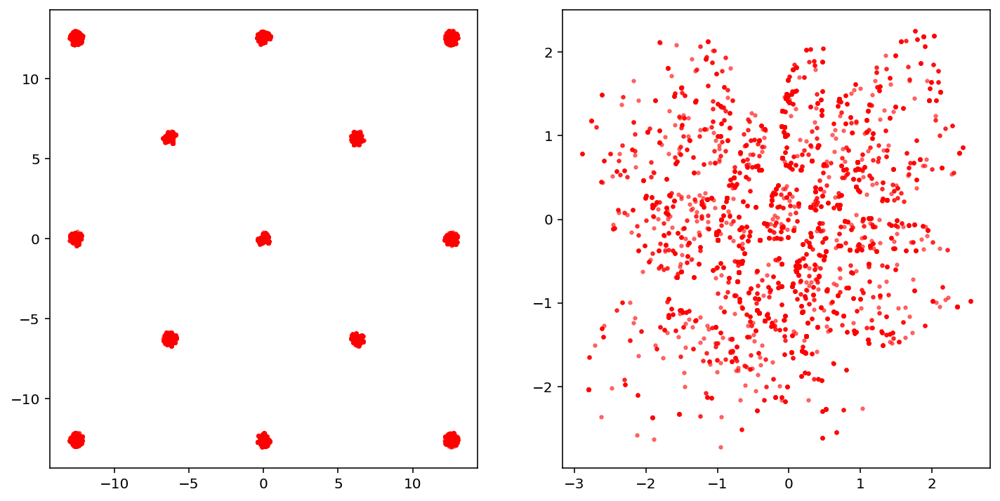

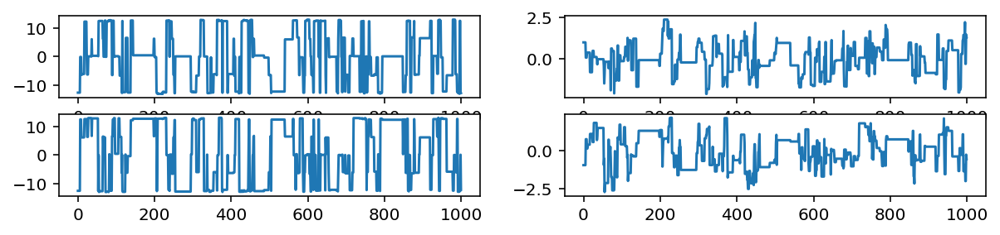

Removed no burn in
332.5515808067964
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           1.36E+01           13.59             368
param2           1.80E+01           18.02             277


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1870  p_{1}
param2        0.0867  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00682
  2      0.03524

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0006   0.0002   0.0047 upper
param1       0.0064   0.0076   0.0075 lower
param2       0.0007   0.0030   0.0024 upper
param2       0.0047   0.0057   0.0042 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

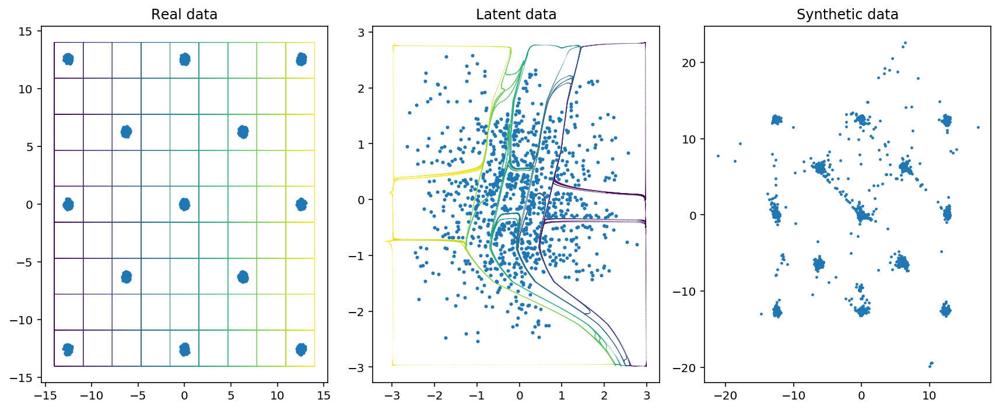

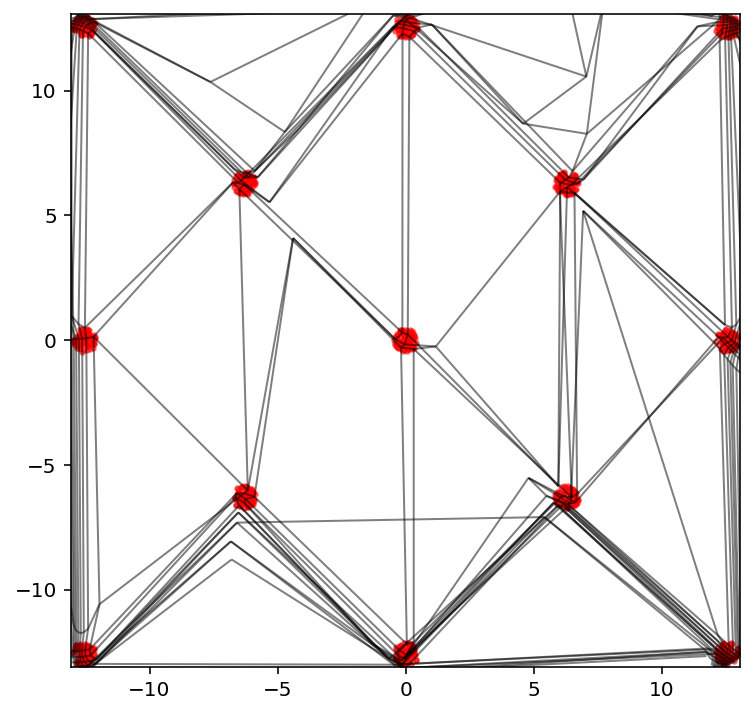

Creating directory for new run logs/test/run56
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


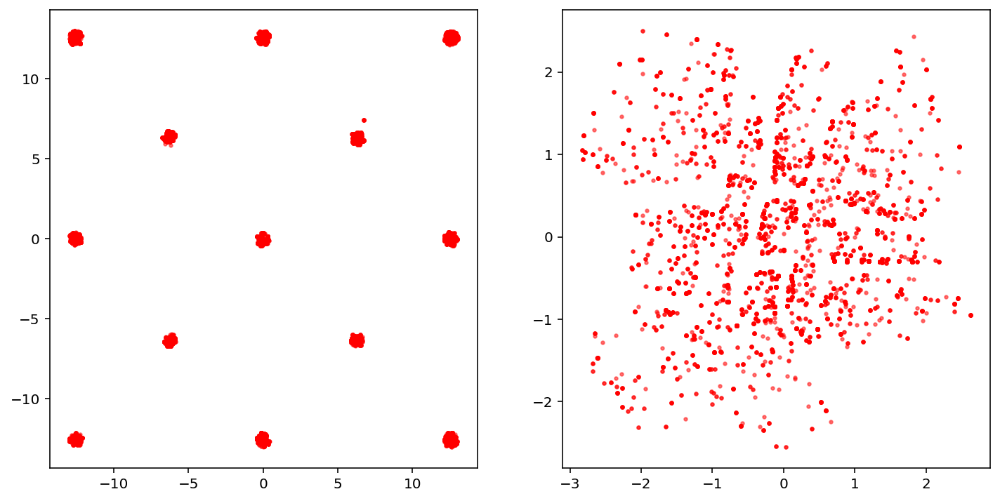

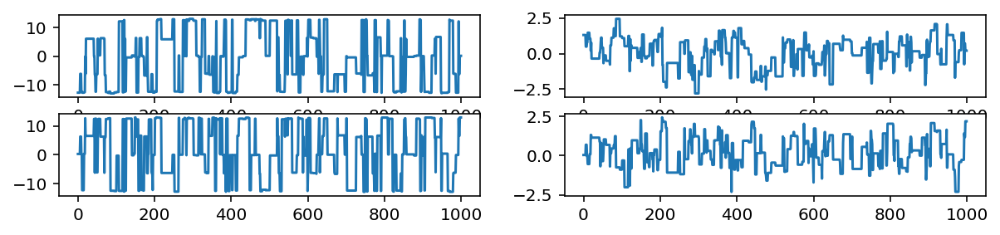

Removed no burn in
301.5838503673452
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           1.54E+01           15.36             325
param2           1.54E+01           15.37             325


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1434  p_{1}
param2        0.1620  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00833
  2      0.03843

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0018   0.0035   0.0028 upper
param1       0.0014   0.0021   0.0046 lower
param2       0.0010   0.0023   0.0059 upper
param2       0.0022   0.0041   0.0046 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

In [24]:
model = Trainer(like.x_dim, flow='spline', learning_rate=0.001)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

In [25]:
prior = UniformPrior(2, [-7, -3], [7, 3])
like = DoubleGaussianShell(2, centers=[[-4.0, 0.0], [4.0, 0.0]])

[nnest.trainer] [INFO] SingleSpeedCholeksy(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): Choleksy()
    )
  )
)
[nnest.trainer] [INFO] Number of network params: [5]
[nnest.trainer] [INFO] Device [cpu]
[nnest.trainer] [INFO] Number of training samples [1000]
[nnest.trainer] [INFO] Training jitter [0.0010]
[nnest.trainer] [INFO] Epoch [1] train loss [0.1224] validation loss [0.1174]
[nnest.trainer] [INFO] Epoch [100] train loss [0.0668] validation loss [0.0650]
[nnest.trainer] [INFO] Epoch [200] train loss [0.0524] validation loss [0.0515]
[nnest.trainer] [INFO] Epoch [300] train loss [0.0481] validation loss [0.0476]
[nnest.trainer] [INFO] Epoch [400] train loss [0.0470] validation loss [0.0466]
[nnest.trainer] [INFO] Epoch [500] train loss [0.0467] validation loss [0.0464]
[nnest.trainer] [INFO] Epoch [600] train loss [0.0467] validation loss [0.0464]
[nnest.trainer] [INFO] Epoch [628] ran out of patience
[nnest.trainer] [INFO] Best epoch [578] validation loss [0.0464

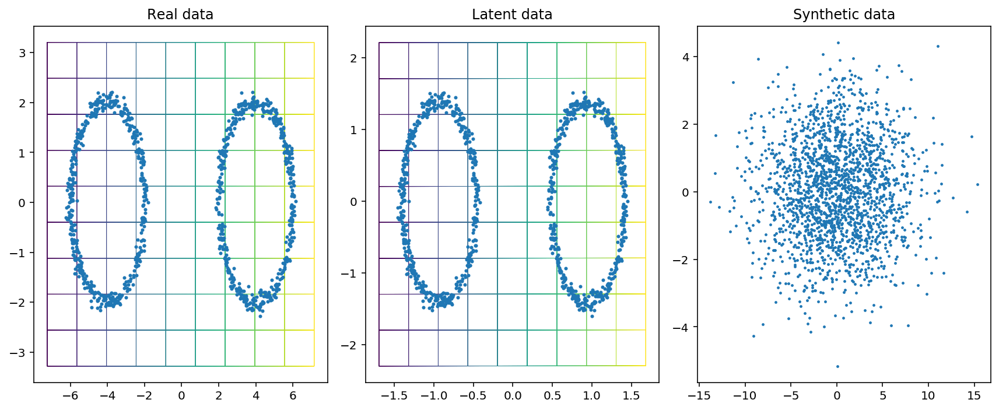

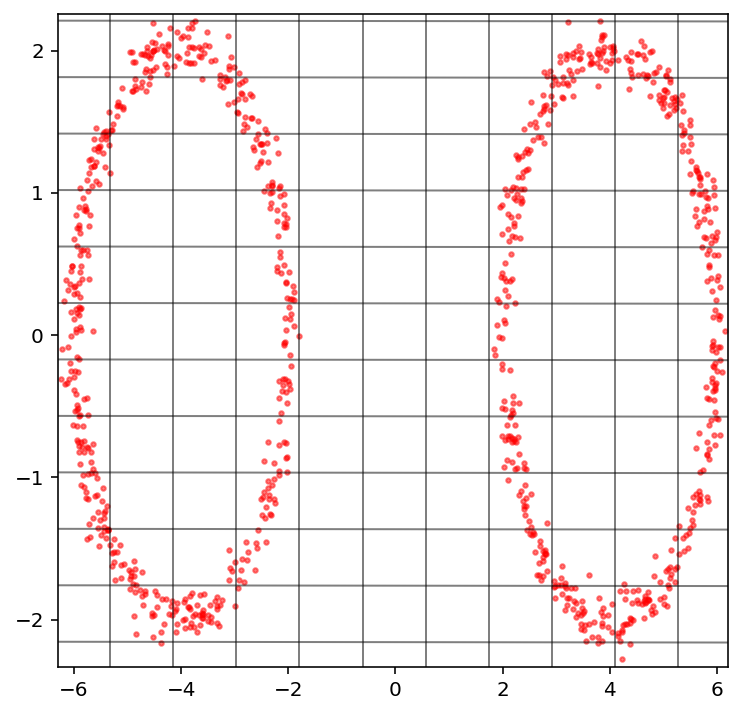

Creating directory for new run logs/test/run57
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


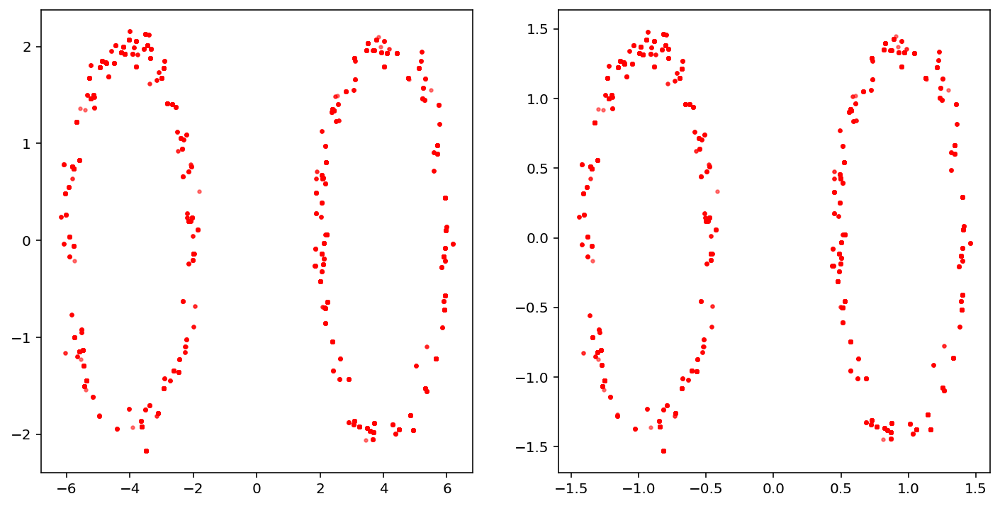

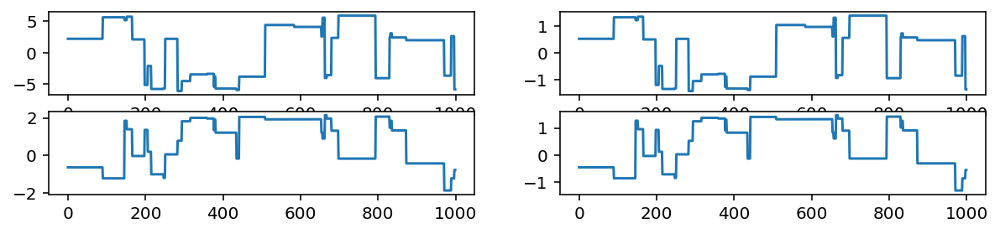

Removed no burn in
50.99524426036654
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           5.76E+01           57.63              86
param2           5.19E+01           51.89              96


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.5232  p_{1}
param2        0.4198  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.16971
  2      0.29798

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0066   0.0054   0.0679 upper
param1       0.0193   0.1503   0.1302 lower
param2       0.0139   0.0262   0.0542 upper
param2       0.0081   0.0765   0.0672 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1          

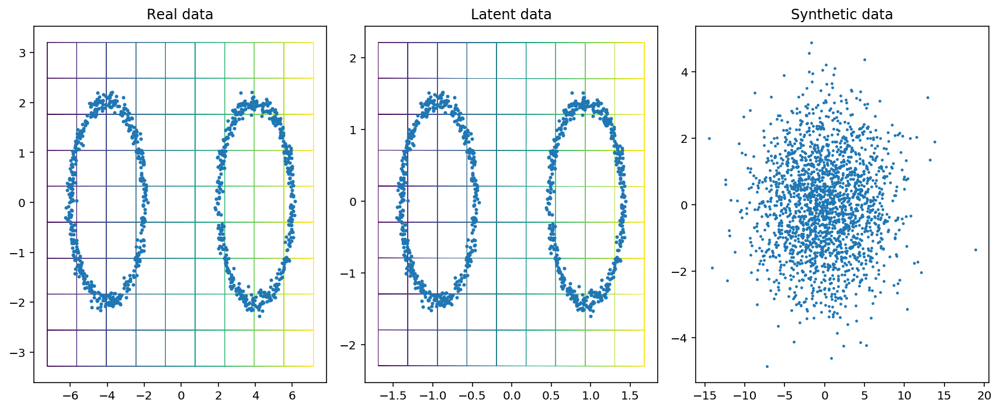

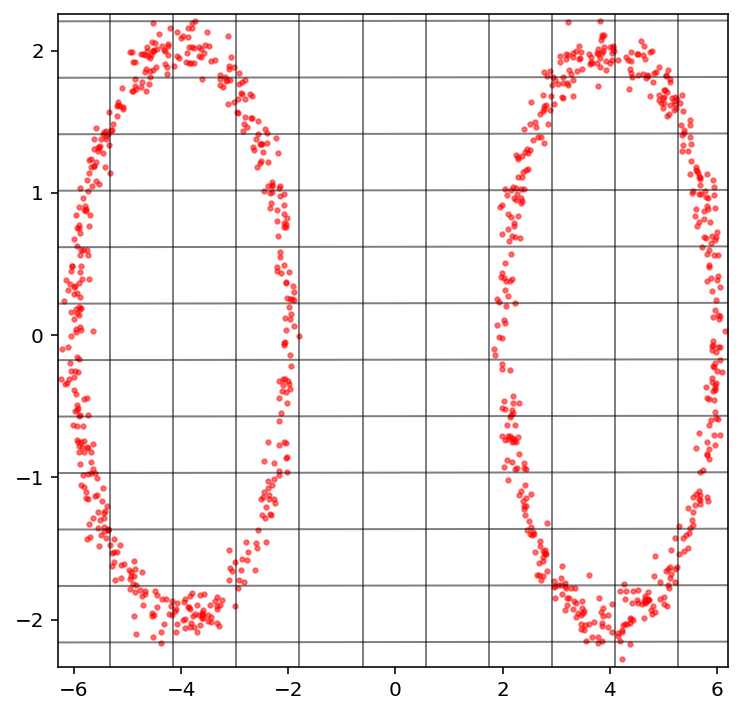

Creating directory for new run logs/test/run58
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


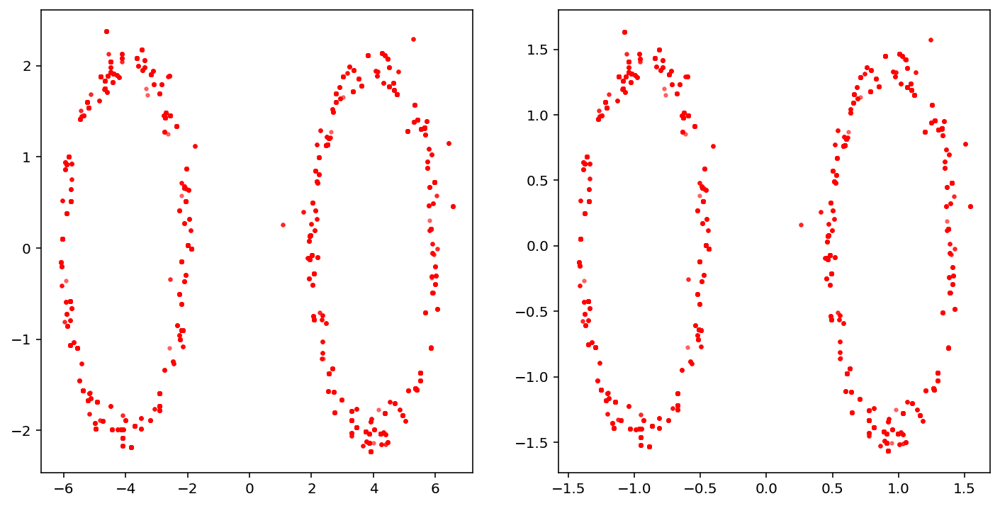

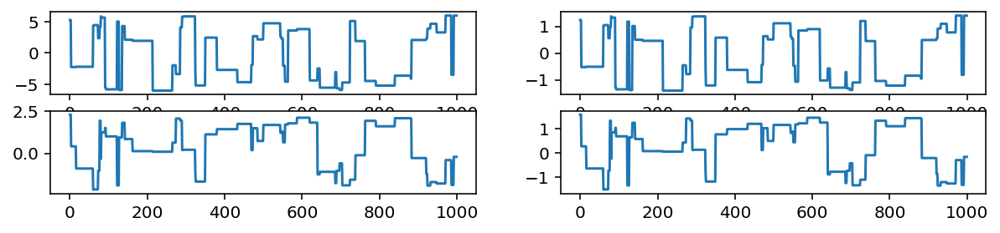

Removed no burn in
113.16626830841103
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           3.40E+01           34.00             147
param2           5.06E+01           50.64              98


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.3353  p_{1}
param2        0.3307  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.06031
  2      0.15574

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0167   0.0159   0.0225 upper
param1       0.0293   0.0288   0.0211 lower
param2       0.0163   0.0251   0.0266 upper
param2       0.0738   0.0796   0.0920 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enou

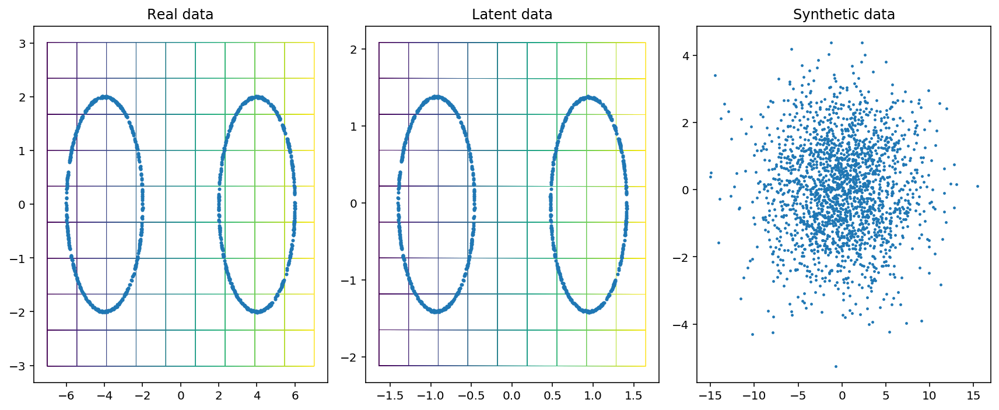

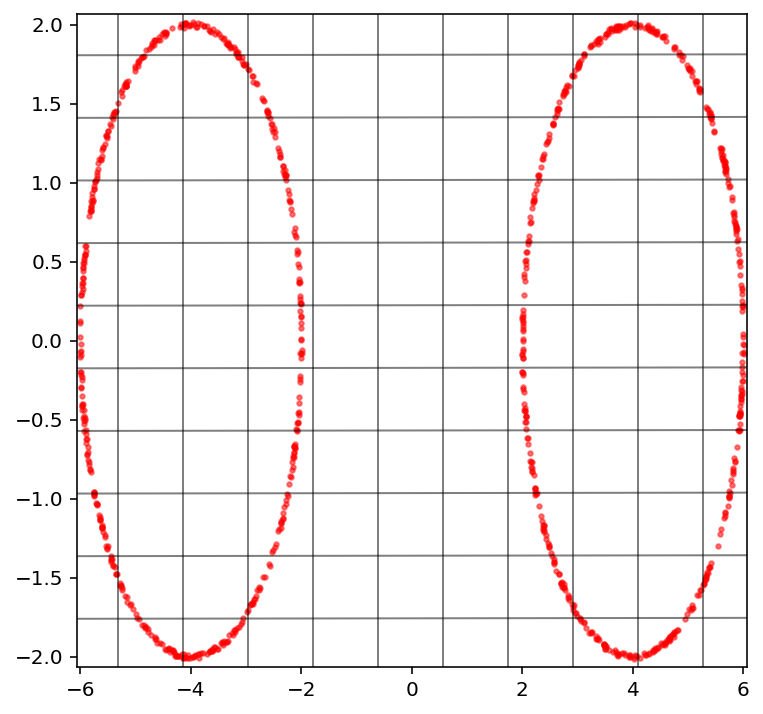

Creating directory for new run logs/test/run59
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


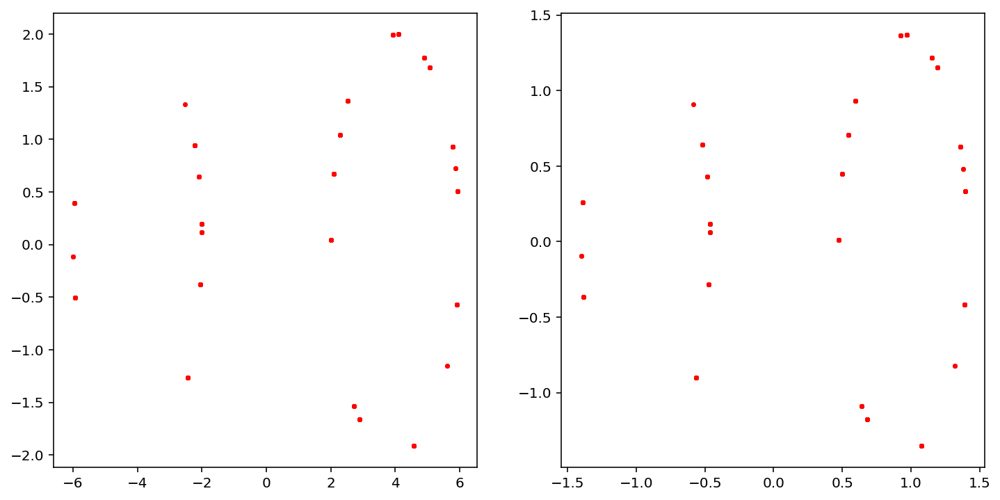

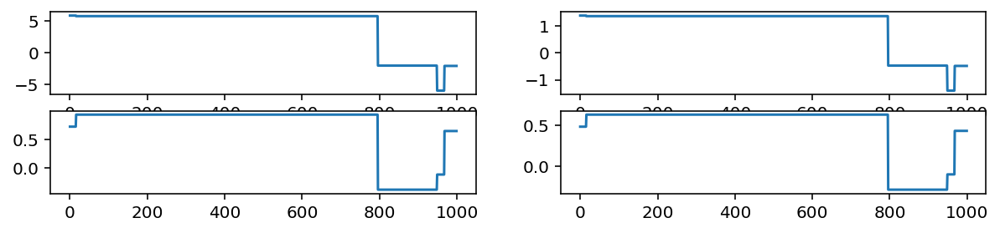

Removed no burn in
25.5932882829416
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           6.95E-01            0.70            7198
param2           2.90E-01            0.29           17260


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.7401  p_{1}
param2        1.7495  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.27907
  2      6.75775

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0299   0.1488   0.1981 upper
param1       0.0029   0.6623   1.3269 lower
param2       0.1633   0.4564   0.4118 upper
param2       0.1333   0.1089   0.1689 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enough

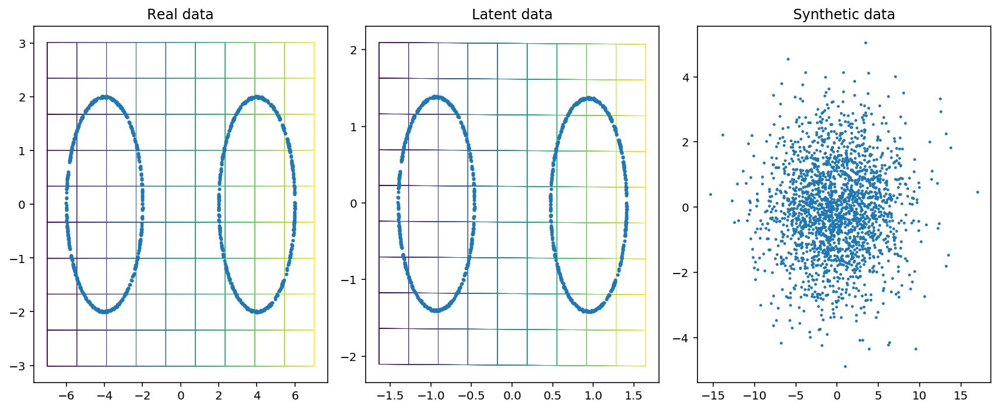

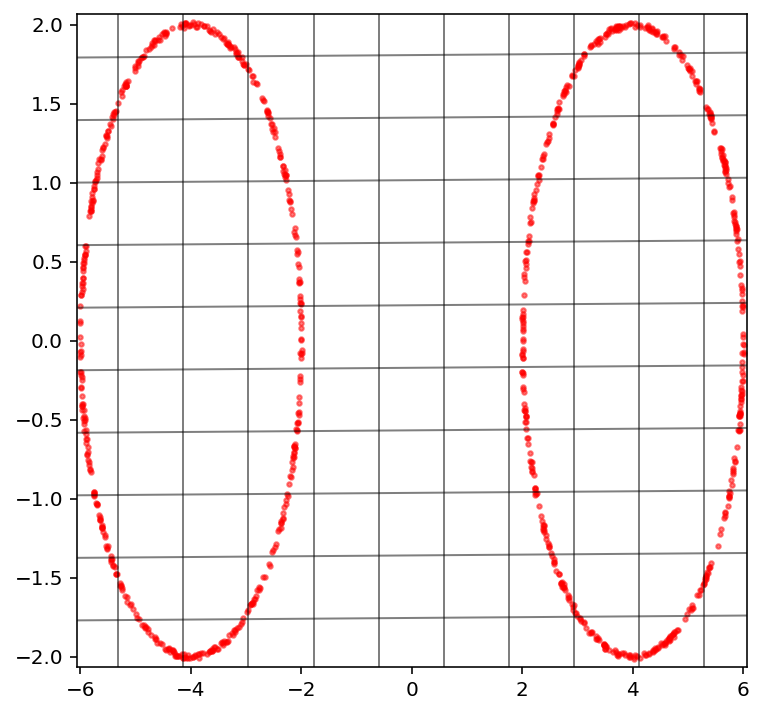

Creating directory for new run logs/test/run60
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


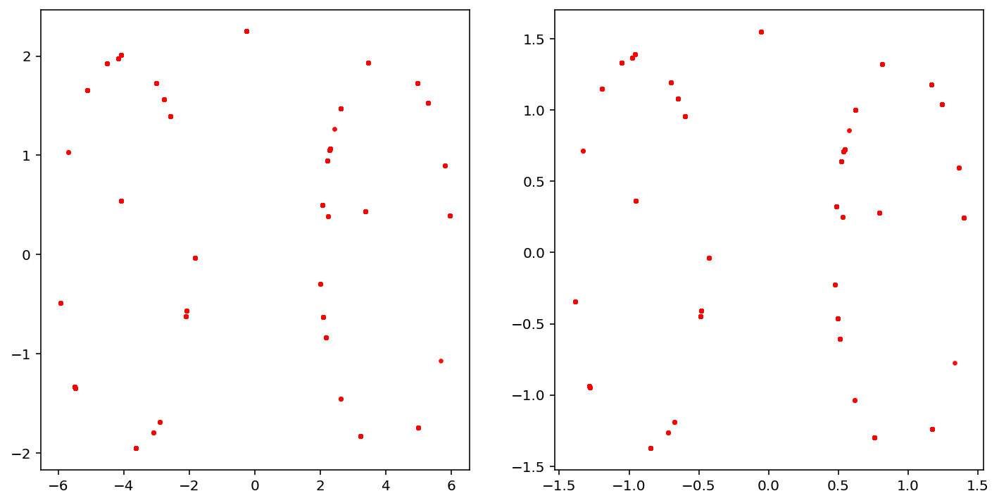

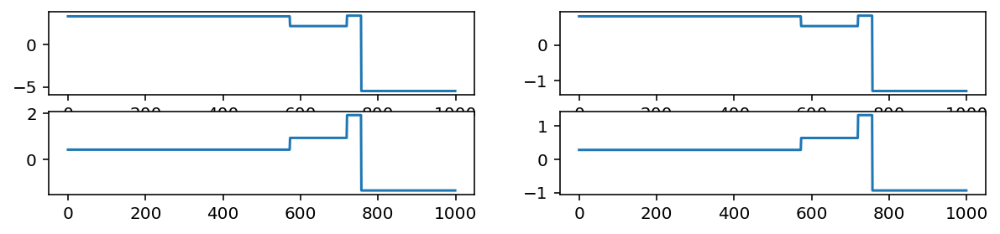

Removed no burn in
5004.999961127245
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           7.51E-01            0.75            6664
param2           8.42E-01            0.84            5946


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.6439  p_{1}
param2        0.4849  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.23465
  2      0.41720

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.3988   0.5840   0.4999 upper
param1       0.1946   0.1739   0.4347 lower
param2       0.1338   0.1093   0.1710 upper
param2       0.0694   0.2264   0.2485 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enoug

In [26]:
model = Trainer(like.x_dim, flow='choleksy', learning_rate=0.001)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

[nnest.trainer] [INFO] SingleSpeedNVP(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): CouplingLayer(
        (scale_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
          (1): Tanh()
          (2): Linear(in_features=64, out_features=64, bias=True)
          (3): Tanh()
          (4): Linear(in_features=64, out_features=64, bias=True)
          (5): Tanh()
          (6): Linear(in_features=64, out_features=2, bias=True)
        )
        (translate_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
          (1): ReLU()
          (2): Linear(in_features=64, out_features=64, bias=True)
          (3): ReLU()
          (4): Linear(in_features=64, out_features=64, bias=True)
          (5): ReLU()
          (6): Linear(in_features=64, out_features=2, bias=True)
        )
      )
      (1): CouplingLayer(
        (scale_net): Sequential(
          (0): Linear(in_features=2, out_features=64, bias=True)
     

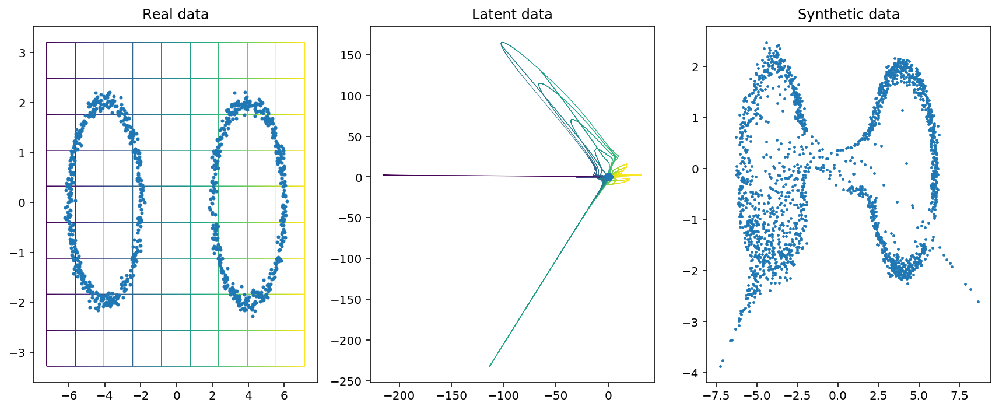

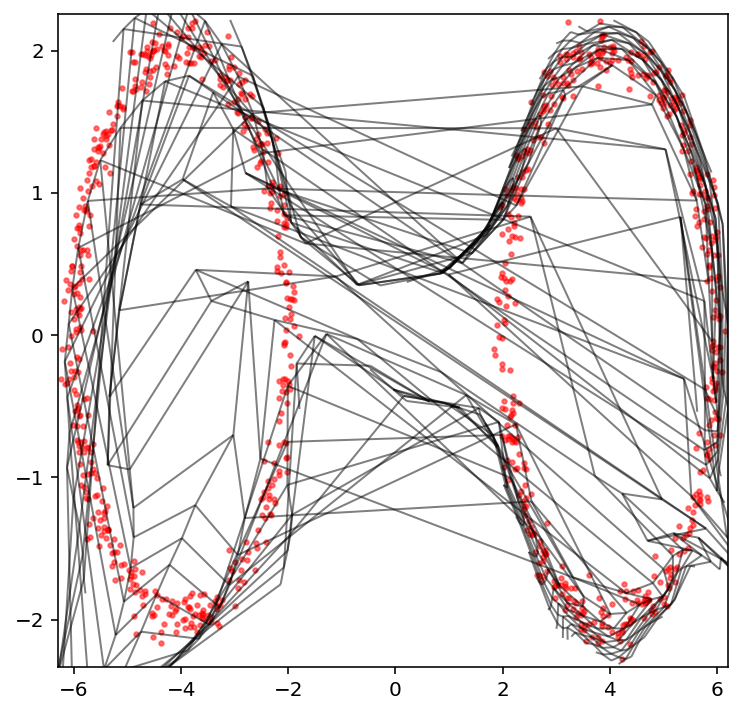

Creating directory for new run logs/test/run61
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


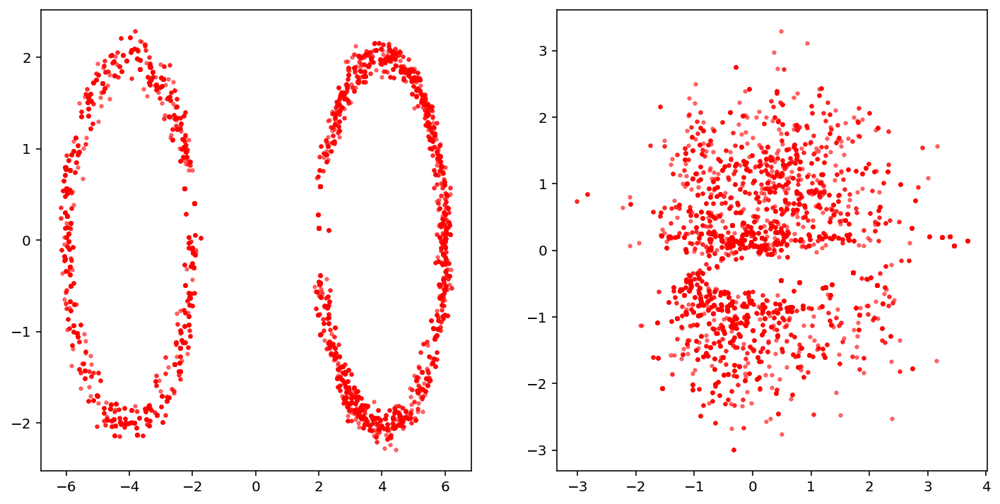

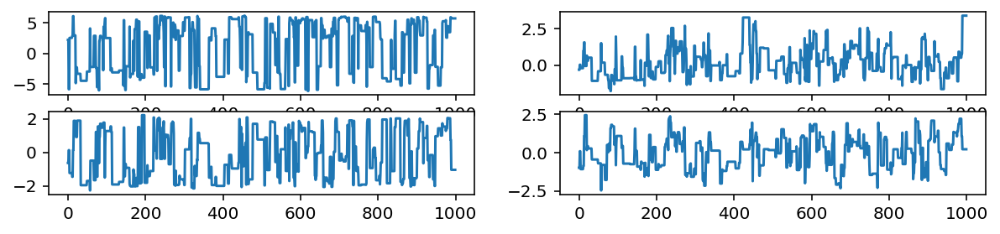

Removed no burn in
223.963266953517
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           1.22E+01           12.22             409
param2           9.93E+00            9.93             504


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1733  p_{1}
param2        0.1437  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00306
  2      0.04596

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0019   0.0040   0.0054 upper
param1       0.0141   0.0184   0.0160 lower
param2       0.0039   0.0203   0.0149 upper
param2       0.0125   0.0145   0.0345 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1           

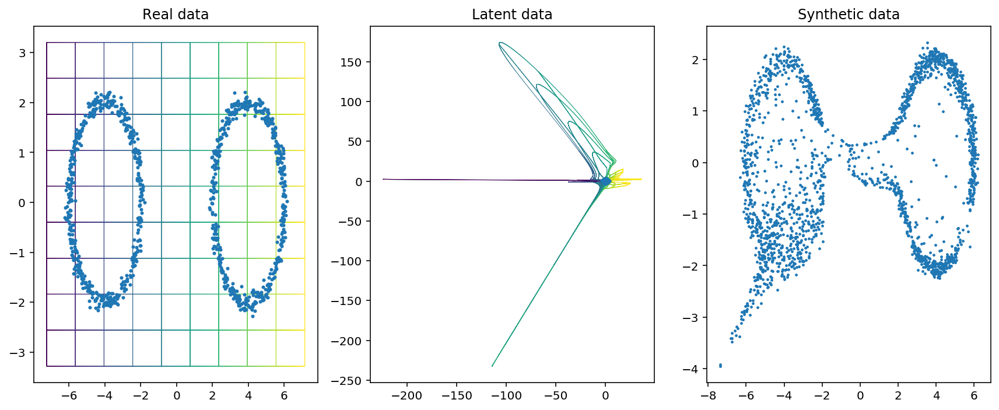

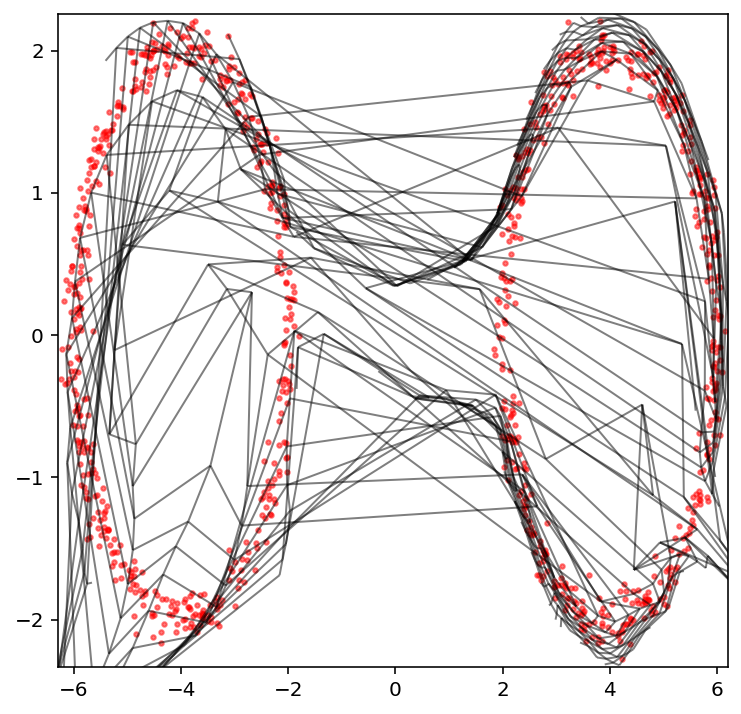

Creating directory for new run logs/test/run62
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


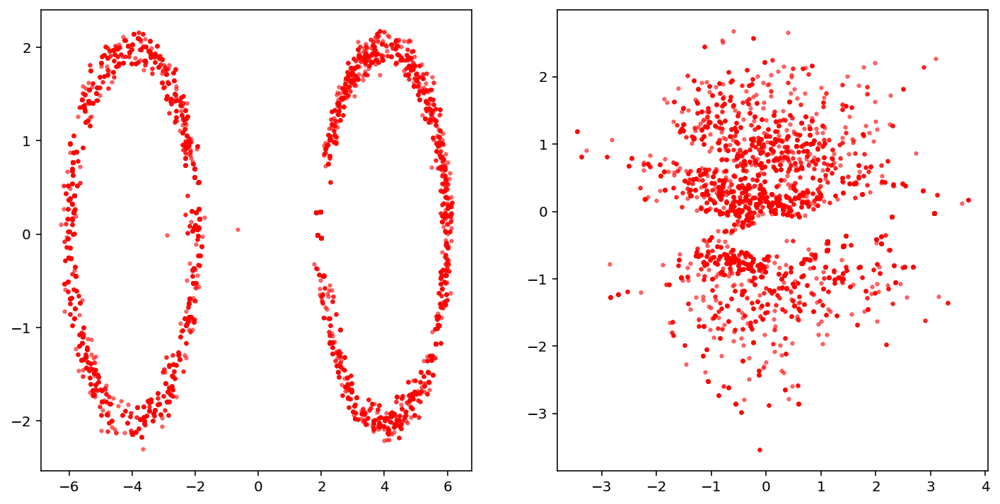

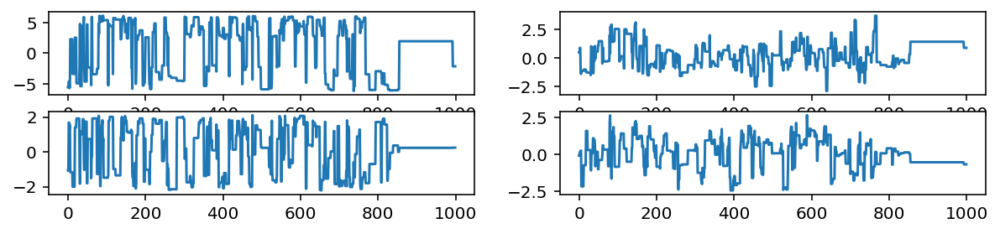

Removed no burn in
253.55592546896492
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           1.34E+01           13.41             373
param2           9.52E+00            9.52             525


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.1624  p_{1}
param2        0.0594  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.00199
  2      0.02790

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0035   0.0030   0.0057 upper
param1       0.0061   0.0057   0.0098 lower
param2       0.0008   0.0017   0.0044 upper
param2       0.0099   0.0273   0.0314 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0           1         

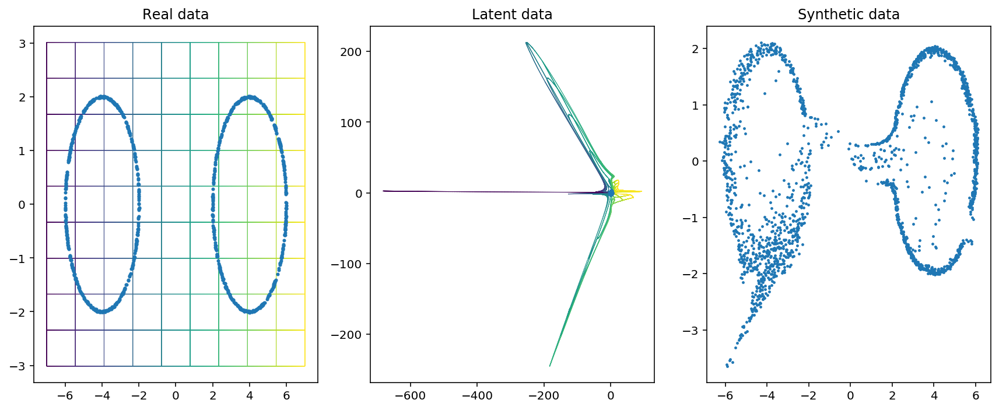

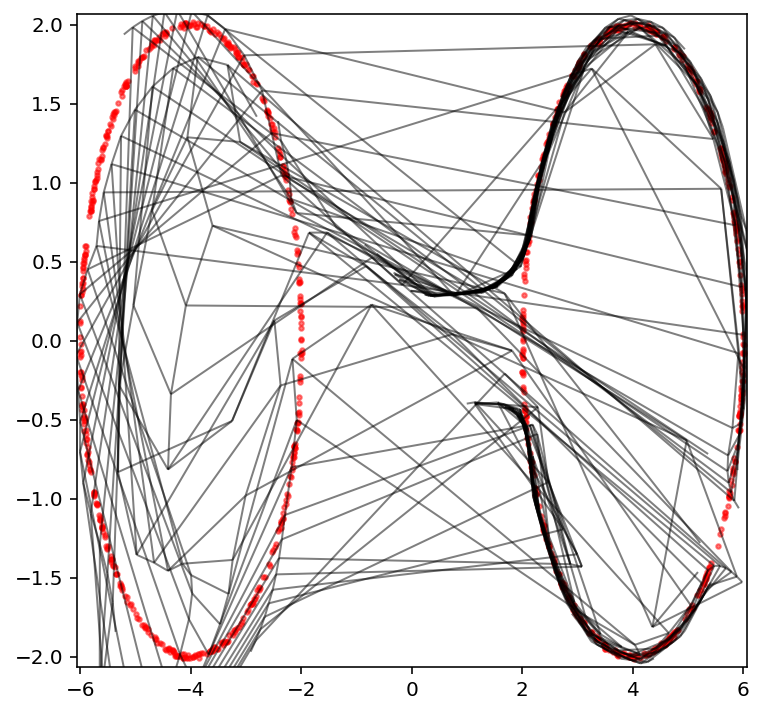

Creating directory for new run logs/test/run63
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


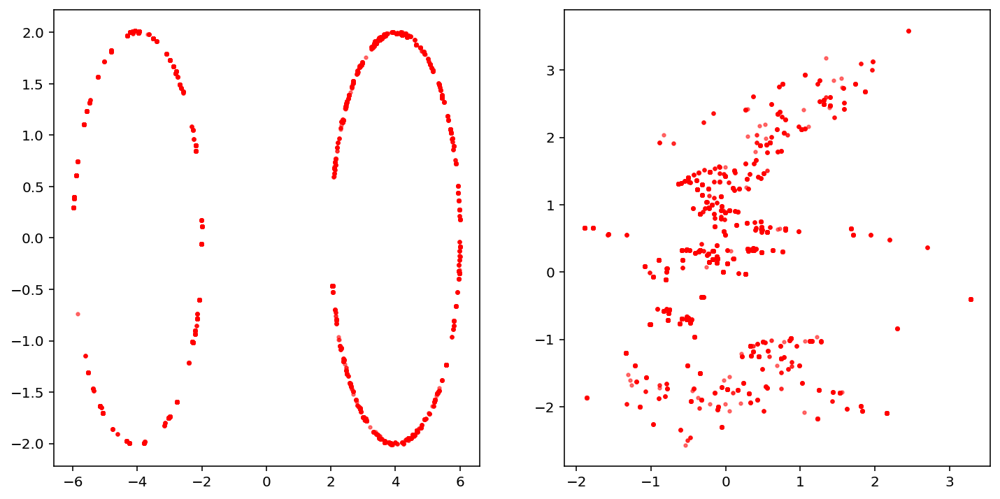

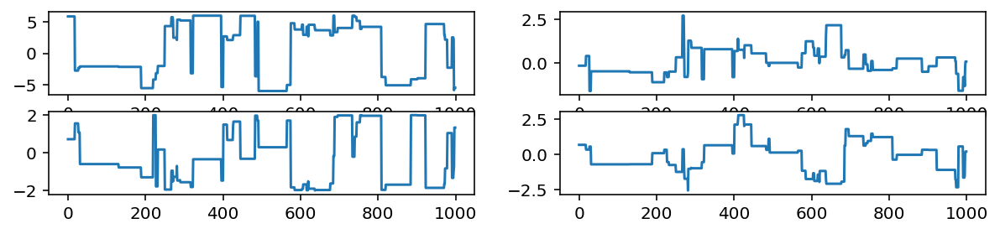

Removed no burn in
68.73262434694323
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           5.78E+01           57.82              86
param2           4.96E+01           49.55             100


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.3262  p_{1}
param2        0.2043  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.02692
  2      0.12032

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0005   0.0031   0.0203 upper
param1       0.0107   0.1011   0.0878 lower
param2       0.0028   0.0041   0.0044 upper
param2       0.0084   0.0046   0.0144 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enoug

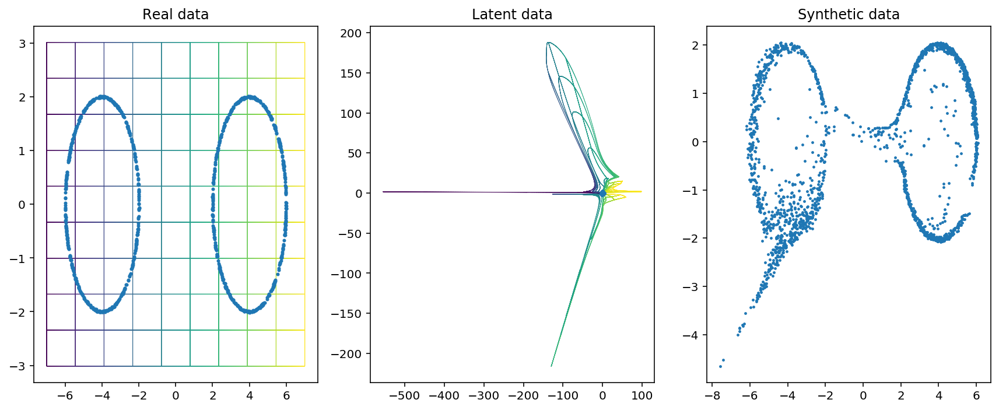

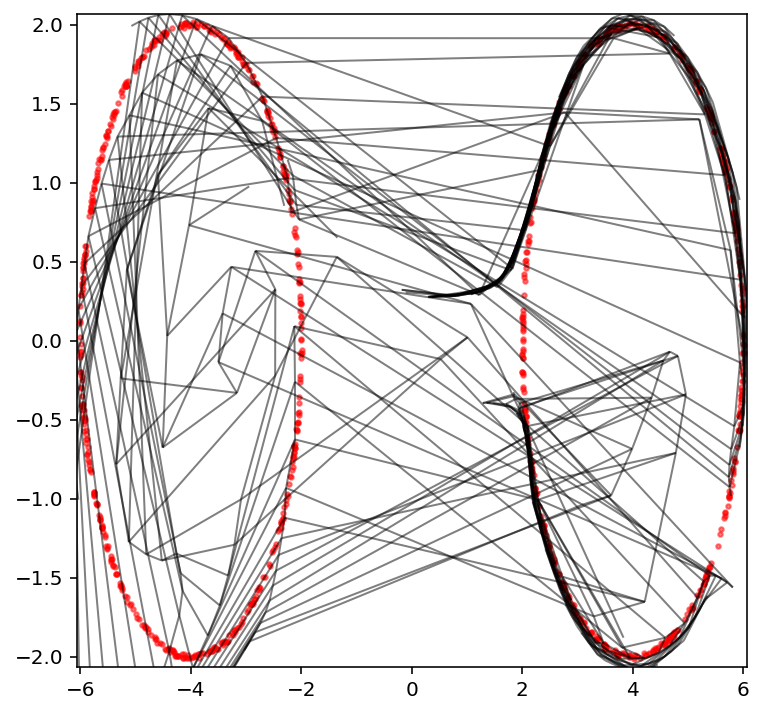

Creating directory for new run logs/test/run64
[nnest.sampler] [INFO] Num base params [2]
[nnest.sampler] [INFO] Num derived params [0]
[nnest.sampler] [INFO] Total params [2]


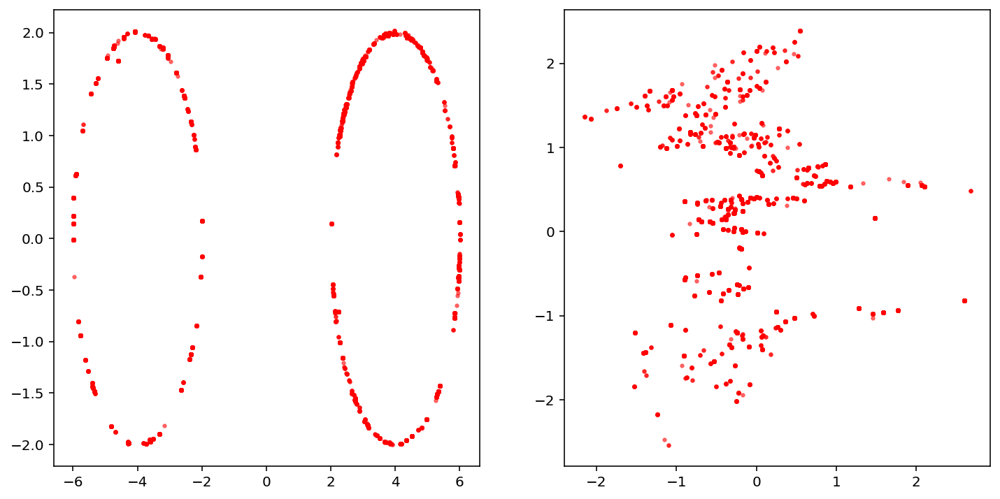

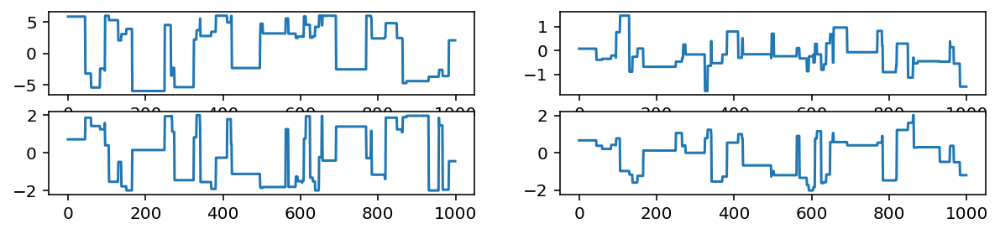

Removed no burn in
90.15589541301034
Parameter autocorrelation lengths (effective number of samples N_eff = tot weight/weight length)

            Weight Length   Sample length           N_eff
param1           4.96E+01           49.61             100
param2           4.08E+01           40.82             122


mean convergence stats using remaining chains
param sqrt(var(chain mean)/mean(chain var))

param1        0.2160  p_{1}
param2        0.2525  p_{2}

var(mean)/mean(var) for eigenvalues of covariance of y of orthonormalized parameters
  1      0.01770
  2      0.08980

Split tests: rms_n([delta(upper/lower quantile)]/sd) n={2,3,4}, limit=95%:
i.e. mean sample splitting change in the quantiles in units of the st. dev.

param1       0.0001   0.0026   0.0031 upper
param1       0.0007   0.0009   0.0013 lower
param2       0.0132   0.0133   0.0284 upper
param2       0.0012   0.0063   0.0115 lower

Raftery&Lewis statistics

chain  markov_thin  indep_thin    nburn
   0      Failed/not enoug

In [27]:
model = Trainer(like.x_dim, hidden_dim=64, num_blocks=5, flow='nvp', learning_rate=0.001)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

In [ ]:
model = Trainer(like.x_dim, flow='spline', learning_rate=0.001)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=False)
test_mcmc(like, prior, model, init_chain=True, num_chains=num_chains, nested_samples=True)
test_mcmc(like, prior, model, init_chain=False, num_chains=num_chains, nested_samples=True)

[nnest.trainer] [INFO] SingleSpeedSpline(
  (flow): NormalizingFlow(
    (flows): ModuleList(
      (0): ActNorm()
      (1): Invertible1x1Conv()
      (2): NSF_CL(
        (f1): MLP(
          (net): Sequential(
            (0): Linear(in_features=1, out_features=16, bias=True)
            (1): LeakyReLU(negative_slope=0.2)
            (2): Linear(in_features=16, out_features=16, bias=True)
            (3): LeakyReLU(negative_slope=0.2)
            (4): Linear(in_features=16, out_features=16, bias=True)
            (5): LeakyReLU(negative_slope=0.2)
            (6): Linear(in_features=16, out_features=23, bias=True)
          )
        )
        (f2): MLP(
          (net): Sequential(
            (0): Linear(in_features=1, out_features=16, bias=True)
            (1): LeakyReLU(negative_slope=0.2)
            (2): Linear(in_features=16, out_features=16, bias=True)
            (3): LeakyReLU(negative_slope=0.2)
            (4): Linear(in_features=16, out_features=16, bias=True)
        